## Deep Convolutional GAN

This exercise is based on the [PyTorch tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) on DCGAN.

The vanilla GAN we have seen does not take into account the class of an image; thus, while it can produce realistic images that look like images from the training set, it cannot produce images of a specific, desired class, such as only images of cats. We can extend the vanilla GAN by incorporating extra conditioning information, for example to specify which class we want it to generate. To do this, we pass a conditioning vector $c$ to both the generator and discriminator, so they become $G(z, c)$ and $D(x, c)$, respectively. Then the generator $G$ can take into account which class it is supposed to generate, and $D$ can score how realistic a generated image is, given that it is intended to represent a specific class.

Then, the objective function of the discriminator becomes:
$$
J_D = \mathbb{E}_{x \sim p_{data}} [ - \log D(x, c) ] + \mathbb{E}_{z \sim q(z)} [ - \log(1 - D(G(z, c), c)) ]
$$

And the objective function of the generator becomes:
$$
J_G = \mathbb{E}_{z \sim q(z)} [ - \log D(G(z, c), c) ]
$$

In [0]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import time

import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

## For this exercise it is recommended to use the GPU!

In [0]:

use_cuda = True

if use_cuda and torch.cuda.is_available():
  device = torch.device('cuda')
else:
  device = torch.device('cpu')

device

device(type='cuda')

### Load the CIFAR10 dataset

Feel free to try other datasets as well, such as the Celeb-A Faces Dataset which is used in the [tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) on which this exercise is based.

In [0]:
import torchvision
import torchvision.transforms as transforms

transform_train = transforms.Compose([
    transforms.Scale(64),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

trainset = torchvision.datasets.CIFAR10(root='./data_cifar', train=True,
                                        download=True, transform=transform_train)

testset = torchvision.datasets.CIFAR10(root='./data_cifar', train=False,
                                       download=True, transform=transform_test)

batch_size = 128

c, w, h = 3, 32, 32

trainloader = torch.utils.data.DataLoader(trainset,
                                          batch_size=batch_size,
                                          shuffle=True)

testloader = torch.utils.data.DataLoader(testset,
                                         batch_size=batch_size,
                                         shuffle=True)

classes = ('plane', 'car', 'bird', 'cat',
           'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

/usr/local/lib/python3.6/dist-packages/torchvision/transforms/transforms.py:220: UserWarning: The use of the transforms.Scale transform is deprecated, please use transforms.Resize instead.
  "please use transforms.Resize instead.")
0it [00:00, ?it/s]

170500096it [00:09, 18174836.01it/s]                               


Extracting ./data_cifar/cifar-10-python.tar.gz to ./data_cifar
Files already downloaded and verified


### Define the Generator and Discriminator models

In [0]:

n_noise = 100  # Size of the noise vector
n_g_channels = 64
n_d_channels = 64

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.model = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(n_noise, n_g_channels * 8, kernel_size=(4, 4), stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_g_channels * 8),
            nn.ReLU(),
            # state size. (n_g_channels*8) x 4 x 4
            nn.ConvTranspose2d(n_g_channels * 8, n_g_channels * 4, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_g_channels * 4),
            nn.ReLU(),
            # state size. (n_g_channels*4) x 8 x 8
            nn.ConvTranspose2d(n_g_channels * 4, n_g_channels * 2, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_g_channels * 2),
            nn.ReLU(),
            # state size. (n_g_channels*2) x 16 x 16
            nn.ConvTranspose2d(n_g_channels * 2,     n_g_channels, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_g_channels),
            nn.ReLU(),
            # state size. (n_g_channels) x 32 x 32
            nn.ConvTranspose2d(    n_g_channels,      c, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.Tanh()
            # state size. c x 64 x 64
        )

    def forward(self, x):
        return self.model(x)


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            # input is c x 64 x 64
            nn.Conv2d(c, n_d_channels, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            # nn.LeakyReLU(0.2, inplace=True),
            nn.LeakyReLU(0.2),
            # state size. (n_d_channels) x 32 x 32
            nn.Conv2d(n_d_channels, n_d_channels * 2, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_d_channels * 2),
            # nn.LeakyReLU(0.2, inplace=True),
            nn.LeakyReLU(0.2),
            # state size. (n_d_channels*2) x 16 x 16
            nn.Conv2d(n_d_channels * 2, n_d_channels * 4, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_d_channels * 4),
            # nn.LeakyReLU(0.2, inplace=True),
            nn.LeakyReLU(0.2),
            # state size. (n_d_channels*4) x 8 x 8
            nn.Conv2d(n_d_channels * 4, n_d_channels * 8, kernel_size=(4, 4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_d_channels * 8),
            # nn.LeakyReLU(0.2, inplace=True),
            nn.LeakyReLU(0.2),
            # state size. (n_d_channels*8) x 4 x 4
            nn.Conv2d(n_d_channels * 8, 1, kernel_size=(4, 4), stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        output = self.model(x)
        return output.view(-1, 1)

In [0]:

G = Generator().to(device)
print(G)

D = Discriminator().to(device)
print(D)

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)
Discriminator(
  (model): Sequential(
    (0): 

In [0]:

criterion = nn.BCELoss()

# setup optimizers
D_optimizer = optim.Adam(D.parameters(), lr=0.0001)
G_optimizer = optim.Adam(G.parameters(), lr=0.0001)

### Define a function that displays an image tensor

In [0]:
inverse_transform = transforms.Compose([transforms.Normalize(mean = [ 0., 0., 0. ], std = [ 1/0.229, 1/0.224, 1/0.225 ]), 
                                        transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ], std = [ 1., 1., 1. ]),
                               ])

# Function to show an image tensor
def show(X):
    X = X.cpu()
    X = inverse_transform(X)

    plt.imshow(np.transpose(X.numpy(), (1, 2, 0)))
    plt.show()

### Train the Generator and Discriminator models

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([128])) that is different to the input size (torch.Size([128, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


epoch: 0, time: 0.115s, D loss: 0.056, G loss: 5.699


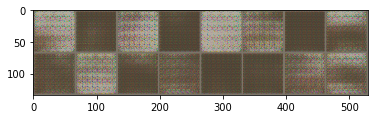

epoch: 0, time: 2.293s, D loss: 0.035, G loss: 6.603
epoch: 0, time: 4.313s, D loss: 0.008, G loss: 8.556
epoch: 0, time: 6.332s, D loss: 0.044, G loss: 7.862
epoch: 0, time: 8.330s, D loss: 0.020, G loss: 8.088
epoch: 0, time: 10.348s, D loss: 0.012, G loss: 8.064


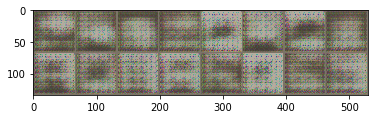

epoch: 0, time: 12.511s, D loss: 0.013, G loss: 6.765
epoch: 0, time: 14.530s, D loss: 0.013, G loss: 8.734
epoch: 0, time: 16.576s, D loss: 0.012, G loss: 7.864
epoch: 0, time: 18.617s, D loss: 0.019, G loss: 9.001
epoch: 0, time: 20.626s, D loss: 0.024, G loss: 9.110


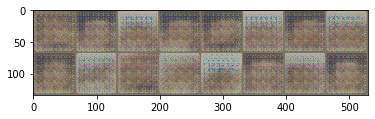

epoch: 0, time: 22.803s, D loss: 0.007, G loss: 8.581
epoch: 0, time: 24.852s, D loss: 0.020, G loss: 7.548
epoch: 0, time: 26.906s, D loss: 0.020, G loss: 6.872
epoch: 0, time: 28.934s, D loss: 0.036, G loss: 7.441
epoch: 0, time: 30.943s, D loss: 0.063, G loss: 9.325


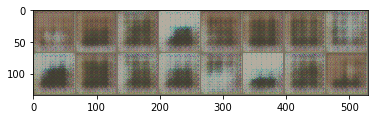

epoch: 0, time: 33.109s, D loss: 0.016, G loss: 6.660
epoch: 0, time: 35.119s, D loss: 0.023, G loss: 7.070
epoch: 0, time: 37.123s, D loss: 0.047, G loss: 6.421
epoch: 0, time: 39.107s, D loss: 0.026, G loss: 6.042


/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([80])) that is different to the input size (torch.Size([80, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


epoch: 1, time: 40.200s, D loss: 0.037, G loss: 5.683


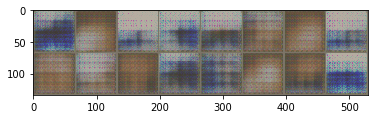

epoch: 1, time: 42.343s, D loss: 0.023, G loss: 7.996
epoch: 1, time: 44.360s, D loss: 0.007, G loss: 10.795
epoch: 1, time: 46.370s, D loss: 0.039, G loss: 6.777
epoch: 1, time: 48.364s, D loss: 0.056, G loss: 6.636
epoch: 1, time: 50.357s, D loss: 0.024, G loss: 7.010


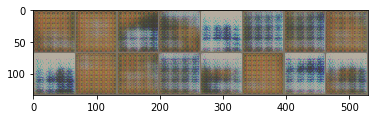

epoch: 1, time: 52.510s, D loss: 0.037, G loss: 7.732
epoch: 1, time: 54.524s, D loss: 0.028, G loss: 11.906
epoch: 1, time: 56.558s, D loss: 0.086, G loss: 6.557
epoch: 1, time: 58.580s, D loss: 0.030, G loss: 5.975
epoch: 1, time: 60.605s, D loss: 0.020, G loss: 7.852


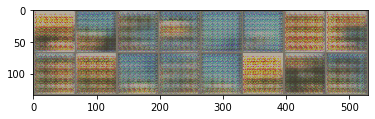

epoch: 1, time: 62.790s, D loss: 0.011, G loss: 8.409
epoch: 1, time: 64.786s, D loss: 0.015, G loss: 8.965
epoch: 1, time: 66.774s, D loss: 0.015, G loss: 9.166
epoch: 1, time: 68.771s, D loss: 0.020, G loss: 6.467
epoch: 1, time: 70.757s, D loss: 0.012, G loss: 8.128


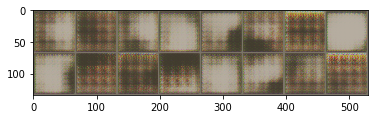

epoch: 1, time: 72.880s, D loss: 0.012, G loss: 7.515
epoch: 1, time: 74.872s, D loss: 0.030, G loss: 8.461
epoch: 1, time: 76.863s, D loss: 0.003, G loss: 10.105
epoch: 1, time: 78.868s, D loss: 0.029, G loss: 7.397
epoch: 2, time: 79.953s, D loss: 0.030, G loss: 8.231


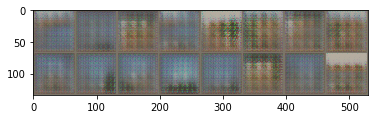

epoch: 2, time: 82.140s, D loss: 0.021, G loss: 6.959
epoch: 2, time: 84.120s, D loss: 0.034, G loss: 7.884
epoch: 2, time: 86.125s, D loss: 0.027, G loss: 6.197
epoch: 2, time: 88.101s, D loss: 0.026, G loss: 8.756
epoch: 2, time: 90.062s, D loss: 0.015, G loss: 8.742


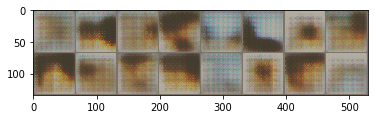

epoch: 2, time: 92.204s, D loss: 0.023, G loss: 11.483
epoch: 2, time: 94.188s, D loss: 0.004, G loss: 9.989
epoch: 2, time: 96.172s, D loss: 0.105, G loss: 7.906
epoch: 2, time: 98.157s, D loss: 0.076, G loss: 7.433
epoch: 2, time: 100.137s, D loss: 0.007, G loss: 9.907


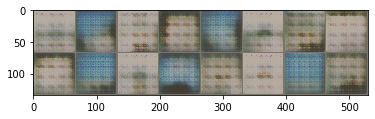

epoch: 2, time: 102.258s, D loss: 0.003, G loss: 9.902
epoch: 2, time: 104.248s, D loss: 0.052, G loss: 6.527
epoch: 2, time: 106.218s, D loss: 0.023, G loss: 7.706
epoch: 2, time: 108.193s, D loss: 0.016, G loss: 8.080
epoch: 2, time: 110.163s, D loss: 0.038, G loss: 10.605


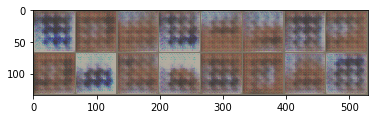

epoch: 2, time: 112.295s, D loss: 0.068, G loss: 8.277
epoch: 2, time: 114.270s, D loss: 0.002, G loss: 9.338
epoch: 2, time: 116.248s, D loss: 0.005, G loss: 13.967
epoch: 2, time: 118.230s, D loss: 0.040, G loss: 7.880
epoch: 3, time: 119.309s, D loss: 0.022, G loss: 7.409


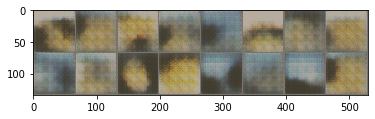

epoch: 3, time: 121.463s, D loss: 0.016, G loss: 8.067
epoch: 3, time: 123.433s, D loss: 0.093, G loss: 12.703
epoch: 3, time: 125.418s, D loss: 0.006, G loss: 10.392
epoch: 3, time: 127.365s, D loss: 0.010, G loss: 8.400
epoch: 3, time: 129.312s, D loss: 0.003, G loss: 10.277


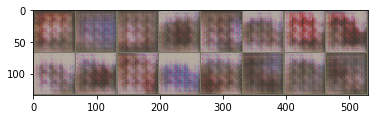

epoch: 3, time: 131.416s, D loss: 0.026, G loss: 9.965
epoch: 3, time: 133.340s, D loss: 0.243, G loss: 3.937
epoch: 3, time: 135.323s, D loss: 0.042, G loss: 5.476
epoch: 3, time: 137.290s, D loss: 0.021, G loss: 8.695
epoch: 3, time: 139.269s, D loss: 0.049, G loss: 7.557


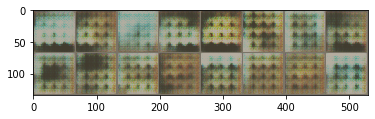

epoch: 3, time: 141.401s, D loss: 0.042, G loss: 7.279
epoch: 3, time: 143.371s, D loss: 0.028, G loss: 6.557
epoch: 3, time: 145.358s, D loss: 0.027, G loss: 7.341
epoch: 3, time: 147.321s, D loss: 0.052, G loss: 6.016
epoch: 3, time: 149.302s, D loss: 0.014, G loss: 9.317


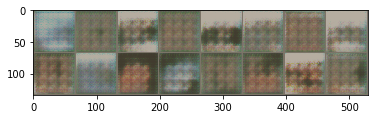

epoch: 3, time: 151.470s, D loss: 0.030, G loss: 7.028
epoch: 3, time: 153.438s, D loss: 0.016, G loss: 6.631
epoch: 3, time: 155.408s, D loss: 0.021, G loss: 6.989
epoch: 3, time: 157.371s, D loss: 0.062, G loss: 7.508
epoch: 4, time: 158.440s, D loss: 0.023, G loss: 9.067


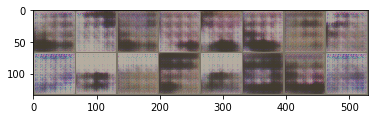

epoch: 4, time: 160.545s, D loss: 0.034, G loss: 8.401
epoch: 4, time: 162.498s, D loss: 0.024, G loss: 6.178
epoch: 4, time: 164.456s, D loss: 0.017, G loss: 8.218
epoch: 4, time: 166.412s, D loss: 0.014, G loss: 7.323
epoch: 4, time: 168.355s, D loss: 0.055, G loss: 8.221


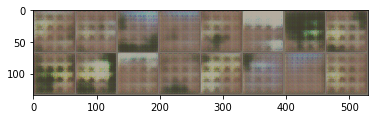

epoch: 4, time: 170.443s, D loss: 0.045, G loss: 5.898
epoch: 4, time: 172.411s, D loss: 0.021, G loss: 6.888
epoch: 4, time: 174.373s, D loss: 0.040, G loss: 8.581
epoch: 4, time: 176.324s, D loss: 0.115, G loss: 12.513
epoch: 4, time: 178.255s, D loss: 0.024, G loss: 8.673


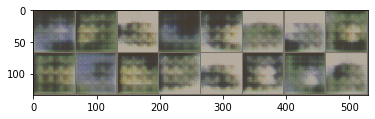

epoch: 4, time: 180.344s, D loss: 0.044, G loss: 6.778
epoch: 4, time: 182.329s, D loss: 0.041, G loss: 6.531
epoch: 4, time: 184.284s, D loss: 0.031, G loss: 7.106
epoch: 4, time: 186.246s, D loss: 0.002, G loss: 15.419
epoch: 4, time: 188.191s, D loss: 0.009, G loss: 9.382


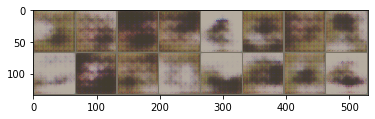

epoch: 4, time: 190.291s, D loss: 0.020, G loss: 7.975
epoch: 4, time: 192.245s, D loss: 0.044, G loss: 9.034
epoch: 4, time: 194.205s, D loss: 0.025, G loss: 6.740
epoch: 4, time: 196.162s, D loss: 0.018, G loss: 8.046
epoch: 5, time: 197.236s, D loss: 0.108, G loss: 10.834


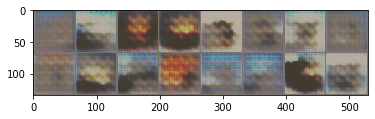

epoch: 5, time: 199.332s, D loss: 0.055, G loss: 10.517
epoch: 5, time: 201.270s, D loss: 0.015, G loss: 9.046
epoch: 5, time: 203.213s, D loss: 0.028, G loss: 6.629
epoch: 5, time: 205.189s, D loss: 0.012, G loss: 6.333
epoch: 5, time: 207.140s, D loss: 0.017, G loss: 8.354


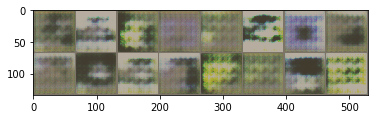

epoch: 5, time: 209.231s, D loss: 0.038, G loss: 6.878
epoch: 5, time: 211.177s, D loss: 0.058, G loss: 7.953
epoch: 5, time: 213.156s, D loss: 0.014, G loss: 6.992
epoch: 5, time: 215.132s, D loss: 0.023, G loss: 10.747
epoch: 5, time: 217.115s, D loss: 0.009, G loss: 8.091


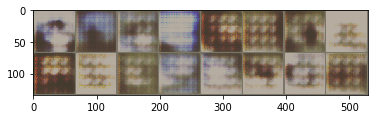

epoch: 5, time: 219.223s, D loss: 0.033, G loss: 11.205
epoch: 5, time: 221.177s, D loss: 0.065, G loss: 7.258
epoch: 5, time: 223.140s, D loss: 0.070, G loss: 7.501
epoch: 5, time: 225.123s, D loss: 0.040, G loss: 7.048
epoch: 5, time: 227.053s, D loss: 0.034, G loss: 7.169


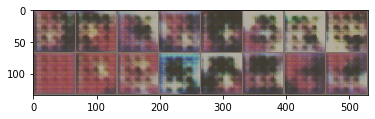

epoch: 5, time: 229.135s, D loss: 0.044, G loss: 6.568
epoch: 5, time: 231.077s, D loss: 0.014, G loss: 7.749
epoch: 5, time: 233.039s, D loss: 0.093, G loss: 6.504
epoch: 5, time: 235.011s, D loss: 0.001, G loss: 8.794
epoch: 6, time: 236.082s, D loss: 0.045, G loss: 8.960


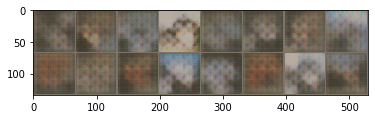

epoch: 6, time: 238.170s, D loss: 0.010, G loss: 9.644
epoch: 6, time: 240.107s, D loss: 0.630, G loss: 7.227
epoch: 6, time: 242.068s, D loss: 0.028, G loss: 10.211
epoch: 6, time: 244.018s, D loss: 0.160, G loss: 7.155
epoch: 6, time: 245.964s, D loss: 0.020, G loss: 9.597


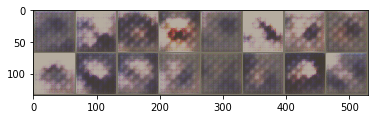

epoch: 6, time: 248.124s, D loss: 0.071, G loss: 7.881
epoch: 6, time: 250.078s, D loss: 0.022, G loss: 8.552
epoch: 6, time: 252.041s, D loss: 0.027, G loss: 5.543
epoch: 6, time: 254.008s, D loss: 0.059, G loss: 6.118
epoch: 6, time: 255.993s, D loss: 0.024, G loss: 6.902


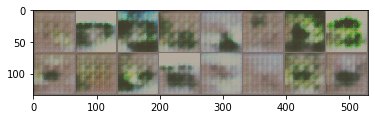

epoch: 6, time: 258.081s, D loss: 0.063, G loss: 5.906
epoch: 6, time: 260.020s, D loss: 0.024, G loss: 6.353
epoch: 6, time: 261.943s, D loss: 0.024, G loss: 6.583
epoch: 6, time: 263.876s, D loss: 0.069, G loss: 5.959
epoch: 6, time: 265.843s, D loss: 0.015, G loss: 7.702


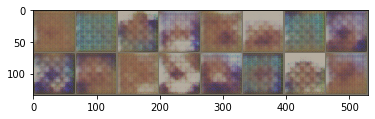

epoch: 6, time: 267.925s, D loss: 0.007, G loss: 6.847
epoch: 6, time: 269.863s, D loss: 0.028, G loss: 7.698
epoch: 6, time: 271.875s, D loss: 0.011, G loss: 8.492
epoch: 6, time: 273.863s, D loss: 0.062, G loss: 7.651
epoch: 7, time: 274.948s, D loss: 0.056, G loss: 7.731


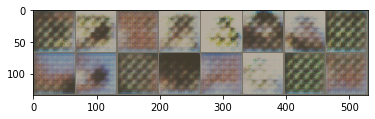

epoch: 7, time: 277.066s, D loss: 0.031, G loss: 7.911
epoch: 7, time: 279.009s, D loss: 0.028, G loss: 7.593
epoch: 7, time: 280.951s, D loss: 0.046, G loss: 5.468
epoch: 7, time: 282.912s, D loss: 0.033, G loss: 7.037
epoch: 7, time: 284.876s, D loss: 0.007, G loss: 9.372


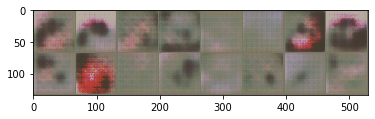

epoch: 7, time: 286.993s, D loss: 0.016, G loss: 7.471
epoch: 7, time: 288.948s, D loss: 0.062, G loss: 6.304
epoch: 7, time: 290.914s, D loss: 1.002, G loss: 18.215
epoch: 7, time: 292.864s, D loss: 0.010, G loss: 9.344
epoch: 7, time: 294.829s, D loss: 0.010, G loss: 6.101


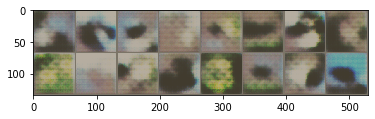

epoch: 7, time: 296.964s, D loss: 0.036, G loss: 6.330
epoch: 7, time: 298.928s, D loss: 0.385, G loss: 8.779
epoch: 7, time: 300.889s, D loss: 0.006, G loss: 8.690
epoch: 7, time: 302.848s, D loss: 0.051, G loss: 8.758
epoch: 7, time: 304.839s, D loss: 0.073, G loss: 5.569


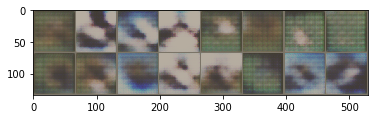

epoch: 7, time: 306.934s, D loss: 0.010, G loss: 6.480
epoch: 7, time: 308.889s, D loss: 0.034, G loss: 5.083
epoch: 7, time: 310.821s, D loss: 0.008, G loss: 11.408
epoch: 7, time: 312.753s, D loss: 0.027, G loss: 6.385
epoch: 8, time: 313.814s, D loss: 0.109, G loss: 6.679


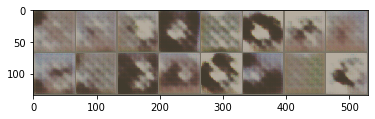

epoch: 8, time: 315.909s, D loss: 0.271, G loss: 7.945
epoch: 8, time: 317.832s, D loss: 0.075, G loss: 7.863
epoch: 8, time: 319.776s, D loss: 0.019, G loss: 8.573
epoch: 8, time: 321.714s, D loss: 0.009, G loss: 9.875
epoch: 8, time: 323.659s, D loss: 0.001, G loss: 9.832


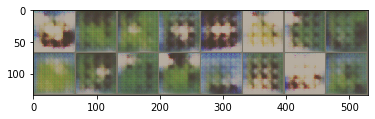

epoch: 8, time: 325.780s, D loss: 0.030, G loss: 5.506
epoch: 8, time: 327.724s, D loss: 0.084, G loss: 6.754
epoch: 8, time: 329.662s, D loss: 0.049, G loss: 6.871
epoch: 8, time: 331.623s, D loss: 0.013, G loss: 7.701
epoch: 8, time: 333.573s, D loss: 0.016, G loss: 11.084


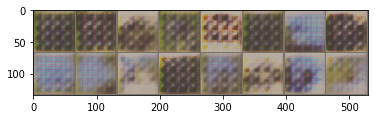

epoch: 8, time: 335.674s, D loss: 0.044, G loss: 6.385
epoch: 8, time: 337.607s, D loss: 0.078, G loss: 7.582
epoch: 8, time: 339.564s, D loss: 0.018, G loss: 7.322
epoch: 8, time: 341.492s, D loss: 0.005, G loss: 8.332
epoch: 8, time: 343.420s, D loss: 0.023, G loss: 9.283


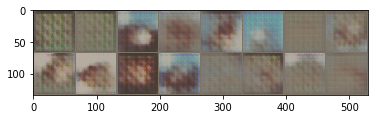

epoch: 8, time: 345.509s, D loss: 0.014, G loss: 7.341
epoch: 8, time: 347.431s, D loss: 0.003, G loss: 11.804
epoch: 8, time: 349.369s, D loss: 0.092, G loss: 5.580
epoch: 8, time: 351.304s, D loss: 0.029, G loss: 6.791
epoch: 9, time: 352.367s, D loss: 0.035, G loss: 5.325


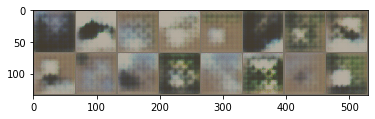

epoch: 9, time: 354.466s, D loss: 0.003, G loss: 9.271
epoch: 9, time: 356.400s, D loss: 0.178, G loss: 7.827
epoch: 9, time: 358.338s, D loss: 0.019, G loss: 12.194
epoch: 9, time: 360.268s, D loss: 0.033, G loss: 10.472
epoch: 9, time: 362.228s, D loss: 0.009, G loss: 7.486


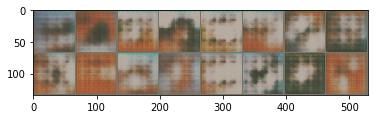

epoch: 9, time: 364.337s, D loss: 0.001, G loss: 11.635
epoch: 9, time: 366.280s, D loss: 0.010, G loss: 7.454
epoch: 9, time: 368.205s, D loss: 0.011, G loss: 12.993
epoch: 9, time: 370.144s, D loss: 0.106, G loss: 6.617
epoch: 9, time: 372.076s, D loss: 0.018, G loss: 8.304


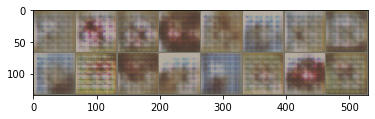

epoch: 9, time: 374.152s, D loss: 0.052, G loss: 7.554
epoch: 9, time: 376.110s, D loss: 0.021, G loss: 6.594
epoch: 9, time: 378.055s, D loss: 0.035, G loss: 7.017
epoch: 9, time: 380.040s, D loss: 0.007, G loss: 14.424
epoch: 9, time: 381.986s, D loss: 0.086, G loss: 7.772


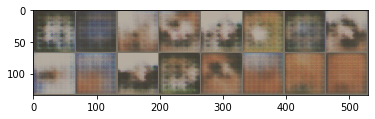

epoch: 9, time: 384.085s, D loss: 0.027, G loss: 6.984
epoch: 9, time: 386.042s, D loss: 0.013, G loss: 6.069
epoch: 9, time: 387.958s, D loss: 0.038, G loss: 8.922
epoch: 9, time: 389.846s, D loss: 0.335, G loss: 9.421
epoch: 10, time: 390.912s, D loss: 0.063, G loss: 8.637


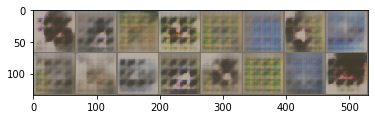

epoch: 10, time: 393.021s, D loss: 0.319, G loss: 16.380
epoch: 10, time: 394.969s, D loss: 0.033, G loss: 6.990
epoch: 10, time: 396.913s, D loss: 0.019, G loss: 8.908
epoch: 10, time: 398.850s, D loss: 0.044, G loss: 7.837
epoch: 10, time: 400.790s, D loss: 0.018, G loss: 7.945


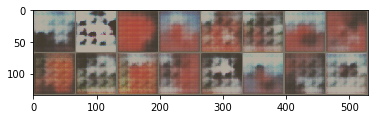

epoch: 10, time: 402.901s, D loss: 0.059, G loss: 8.867
epoch: 10, time: 404.850s, D loss: 0.006, G loss: 7.843
epoch: 10, time: 406.767s, D loss: 0.078, G loss: 6.028
epoch: 10, time: 408.687s, D loss: 0.074, G loss: 5.185
epoch: 10, time: 410.642s, D loss: 0.074, G loss: 7.890


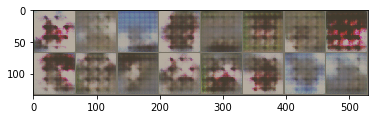

epoch: 10, time: 412.810s, D loss: 0.037, G loss: 6.675
epoch: 10, time: 414.752s, D loss: 0.045, G loss: 5.259
epoch: 10, time: 416.695s, D loss: 0.053, G loss: 5.853
epoch: 10, time: 418.614s, D loss: 0.070, G loss: 6.503
epoch: 10, time: 420.535s, D loss: 0.030, G loss: 8.406


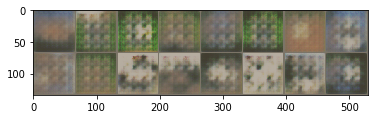

epoch: 10, time: 422.654s, D loss: 0.025, G loss: 10.468
epoch: 10, time: 424.620s, D loss: 0.066, G loss: 6.201
epoch: 10, time: 426.547s, D loss: 0.047, G loss: 9.179
epoch: 10, time: 428.471s, D loss: 0.192, G loss: 7.722
epoch: 11, time: 429.533s, D loss: 0.025, G loss: 7.742


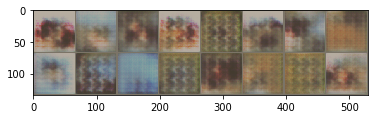

epoch: 11, time: 431.635s, D loss: 0.055, G loss: 3.373
epoch: 11, time: 433.567s, D loss: 0.026, G loss: 8.680
epoch: 11, time: 435.500s, D loss: 0.043, G loss: 7.611
epoch: 11, time: 437.429s, D loss: 0.012, G loss: 7.965
epoch: 11, time: 439.367s, D loss: 0.019, G loss: 9.125


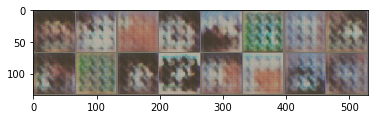

epoch: 11, time: 441.451s, D loss: 0.033, G loss: 7.004
epoch: 11, time: 443.387s, D loss: 0.054, G loss: 6.698
epoch: 11, time: 445.327s, D loss: 0.067, G loss: 6.586
epoch: 11, time: 447.270s, D loss: 0.023, G loss: 6.584
epoch: 11, time: 449.203s, D loss: 0.012, G loss: 8.897


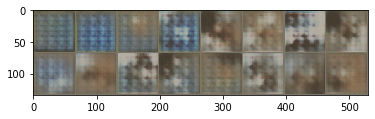

epoch: 11, time: 451.285s, D loss: 0.029, G loss: 7.050
epoch: 11, time: 453.249s, D loss: 0.025, G loss: 5.120
epoch: 11, time: 455.221s, D loss: 0.023, G loss: 7.320
epoch: 11, time: 457.176s, D loss: 0.027, G loss: 6.997
epoch: 11, time: 459.125s, D loss: 0.002, G loss: 9.331


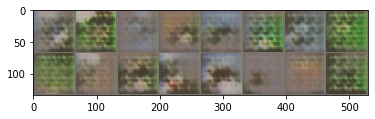

epoch: 11, time: 461.224s, D loss: 0.028, G loss: 7.254
epoch: 11, time: 463.170s, D loss: 0.060, G loss: 5.405
epoch: 11, time: 465.129s, D loss: 0.019, G loss: 8.342
epoch: 11, time: 467.054s, D loss: 0.014, G loss: 6.615
epoch: 12, time: 468.120s, D loss: 0.024, G loss: 6.748


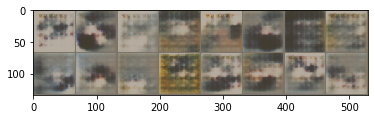

epoch: 12, time: 470.199s, D loss: 0.099, G loss: 5.642
epoch: 12, time: 472.158s, D loss: 0.014, G loss: 6.917
epoch: 12, time: 474.104s, D loss: 0.029, G loss: 7.402
epoch: 12, time: 476.073s, D loss: 0.030, G loss: 6.941
epoch: 12, time: 478.023s, D loss: 0.017, G loss: 6.754


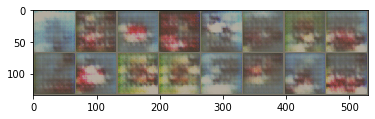

epoch: 12, time: 480.094s, D loss: 0.033, G loss: 6.938
epoch: 12, time: 482.033s, D loss: 0.024, G loss: 7.900
epoch: 12, time: 483.982s, D loss: 0.017, G loss: 6.859
epoch: 12, time: 485.912s, D loss: 0.026, G loss: 6.242
epoch: 12, time: 487.839s, D loss: 0.016, G loss: 7.290


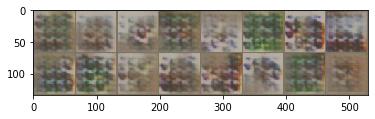

epoch: 12, time: 489.916s, D loss: 0.031, G loss: 6.969
epoch: 12, time: 491.852s, D loss: 0.006, G loss: 8.336
epoch: 12, time: 493.779s, D loss: 0.023, G loss: 7.918
epoch: 12, time: 495.705s, D loss: 0.018, G loss: 6.626
epoch: 12, time: 497.632s, D loss: 0.000, G loss: 18.939


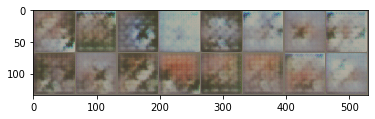

epoch: 12, time: 499.716s, D loss: 0.022, G loss: 9.293
epoch: 12, time: 501.655s, D loss: 0.119, G loss: 12.974
epoch: 12, time: 503.608s, D loss: 0.011, G loss: 8.235
epoch: 12, time: 505.562s, D loss: 0.021, G loss: 7.881
epoch: 13, time: 506.620s, D loss: 0.013, G loss: 11.562


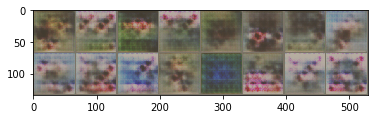

epoch: 13, time: 508.685s, D loss: 0.019, G loss: 7.046
epoch: 13, time: 510.610s, D loss: 0.027, G loss: 6.364
epoch: 13, time: 512.561s, D loss: 0.016, G loss: 12.190
epoch: 13, time: 514.497s, D loss: 0.031, G loss: 6.436
epoch: 13, time: 516.391s, D loss: 0.026, G loss: 9.771


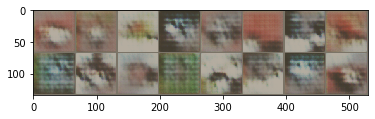

epoch: 13, time: 518.451s, D loss: 0.171, G loss: 8.019
epoch: 13, time: 520.378s, D loss: 0.041, G loss: 7.168
epoch: 13, time: 522.295s, D loss: 0.044, G loss: 7.592
epoch: 13, time: 524.226s, D loss: 0.043, G loss: 8.871
epoch: 13, time: 526.184s, D loss: 0.020, G loss: 7.631


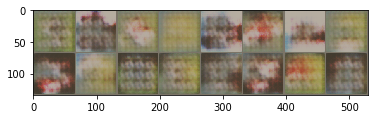

epoch: 13, time: 528.251s, D loss: 0.007, G loss: 9.154
epoch: 13, time: 530.169s, D loss: 0.025, G loss: 7.255
epoch: 13, time: 532.105s, D loss: 0.014, G loss: 7.840
epoch: 13, time: 534.042s, D loss: 0.010, G loss: 7.111
epoch: 13, time: 536.019s, D loss: 0.063, G loss: 5.758


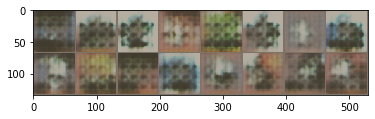

epoch: 13, time: 538.122s, D loss: 0.098, G loss: 6.659
epoch: 13, time: 540.071s, D loss: 0.057, G loss: 6.015
epoch: 13, time: 542.035s, D loss: 0.029, G loss: 6.605
epoch: 13, time: 543.997s, D loss: 0.130, G loss: 7.012
epoch: 14, time: 545.097s, D loss: 0.065, G loss: 6.887


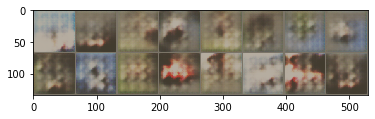

epoch: 14, time: 547.180s, D loss: 0.033, G loss: 5.484
epoch: 14, time: 549.115s, D loss: 0.205, G loss: 5.952
epoch: 14, time: 551.031s, D loss: 0.168, G loss: 4.558
epoch: 14, time: 552.960s, D loss: 0.029, G loss: 6.679
epoch: 14, time: 554.900s, D loss: 0.080, G loss: 7.065


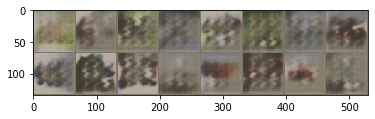

epoch: 14, time: 556.987s, D loss: 0.066, G loss: 6.240
epoch: 14, time: 558.917s, D loss: 0.010, G loss: 7.346
epoch: 14, time: 560.872s, D loss: 0.040, G loss: 6.016
epoch: 14, time: 562.836s, D loss: 0.050, G loss: 7.212
epoch: 14, time: 564.819s, D loss: 0.026, G loss: 8.396


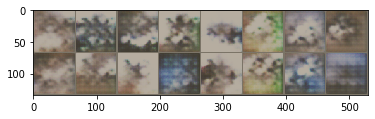

epoch: 14, time: 566.933s, D loss: 0.037, G loss: 6.724
epoch: 14, time: 568.872s, D loss: 0.025, G loss: 6.782
epoch: 14, time: 570.807s, D loss: 0.071, G loss: 5.957
epoch: 14, time: 572.784s, D loss: 0.001, G loss: 13.115
epoch: 14, time: 574.740s, D loss: 0.304, G loss: 5.389


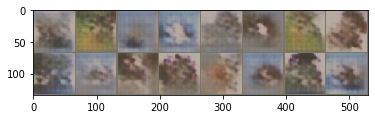

epoch: 14, time: 576.900s, D loss: 0.065, G loss: 8.721
epoch: 14, time: 578.836s, D loss: 0.092, G loss: 5.361
epoch: 14, time: 580.773s, D loss: 0.039, G loss: 7.341
epoch: 14, time: 582.696s, D loss: 0.004, G loss: 9.848
epoch: 15, time: 583.756s, D loss: 0.054, G loss: 8.489


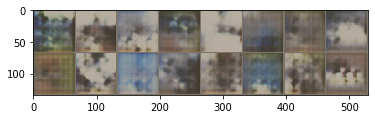

epoch: 15, time: 585.863s, D loss: 0.245, G loss: 6.421
epoch: 15, time: 587.792s, D loss: 0.060, G loss: 9.962
epoch: 15, time: 589.717s, D loss: 0.009, G loss: 8.328
epoch: 15, time: 591.670s, D loss: 0.035, G loss: 6.230
epoch: 15, time: 593.597s, D loss: 0.264, G loss: 5.762


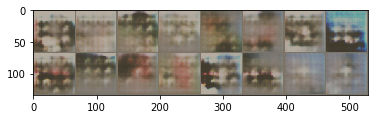

epoch: 15, time: 595.684s, D loss: 0.031, G loss: 5.185
epoch: 15, time: 597.633s, D loss: 0.008, G loss: 7.987
epoch: 15, time: 599.550s, D loss: 0.195, G loss: 7.907
epoch: 15, time: 601.516s, D loss: 0.005, G loss: 9.772
epoch: 15, time: 603.522s, D loss: 0.027, G loss: 5.648


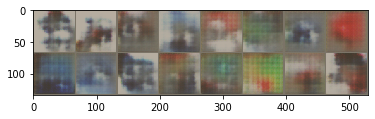

epoch: 15, time: 605.604s, D loss: 0.052, G loss: 6.652
epoch: 15, time: 607.565s, D loss: 0.017, G loss: 8.670
epoch: 15, time: 609.487s, D loss: 0.048, G loss: 7.942
epoch: 15, time: 611.419s, D loss: 0.076, G loss: 5.825
epoch: 15, time: 613.342s, D loss: 0.038, G loss: 10.038


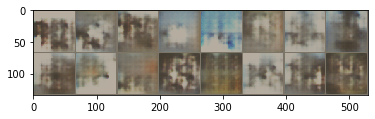

epoch: 15, time: 615.422s, D loss: 0.035, G loss: 11.261
epoch: 15, time: 617.375s, D loss: 0.001, G loss: 9.770
epoch: 15, time: 619.314s, D loss: 0.023, G loss: 8.068
epoch: 15, time: 621.271s, D loss: 0.025, G loss: 7.361
epoch: 16, time: 622.342s, D loss: 0.016, G loss: 8.554


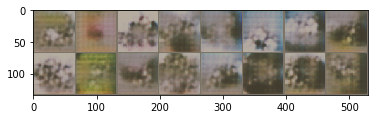

epoch: 16, time: 624.435s, D loss: 0.083, G loss: 7.586
epoch: 16, time: 626.376s, D loss: 0.028, G loss: 7.329
epoch: 16, time: 628.321s, D loss: 0.025, G loss: 9.000
epoch: 16, time: 630.232s, D loss: 0.041, G loss: 8.035
epoch: 16, time: 632.177s, D loss: 0.006, G loss: 7.261


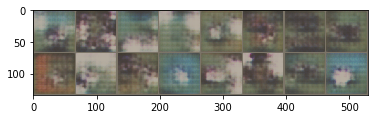

epoch: 16, time: 634.259s, D loss: 0.010, G loss: 6.601
epoch: 16, time: 636.190s, D loss: 0.059, G loss: 5.276
epoch: 16, time: 638.125s, D loss: 0.013, G loss: 8.407
epoch: 16, time: 640.042s, D loss: 0.012, G loss: 7.595
epoch: 16, time: 641.970s, D loss: 0.042, G loss: 6.665


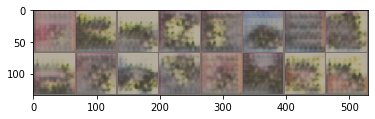

epoch: 16, time: 644.031s, D loss: 0.021, G loss: 8.049
epoch: 16, time: 645.934s, D loss: 0.029, G loss: 8.613
epoch: 16, time: 647.829s, D loss: 0.043, G loss: 7.288
epoch: 16, time: 649.714s, D loss: 0.013, G loss: 10.208
epoch: 16, time: 651.665s, D loss: 0.014, G loss: 9.058


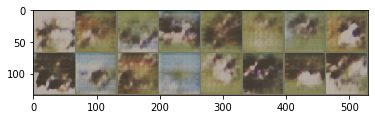

epoch: 16, time: 653.745s, D loss: 0.019, G loss: 6.622
epoch: 16, time: 655.700s, D loss: 0.040, G loss: 4.902
epoch: 16, time: 657.633s, D loss: 0.006, G loss: 8.593
epoch: 16, time: 659.575s, D loss: 0.014, G loss: 8.832
epoch: 17, time: 660.634s, D loss: 0.037, G loss: 6.742


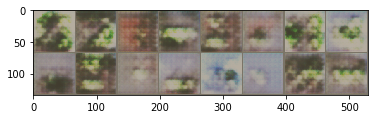

epoch: 17, time: 662.753s, D loss: 0.008, G loss: 8.747
epoch: 17, time: 664.698s, D loss: 0.054, G loss: 7.544
epoch: 17, time: 666.618s, D loss: 0.013, G loss: 7.188
epoch: 17, time: 668.537s, D loss: 0.013, G loss: 7.076
epoch: 17, time: 670.466s, D loss: 0.032, G loss: 5.860


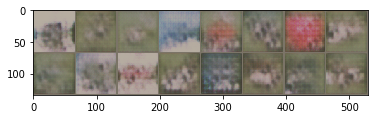

epoch: 17, time: 672.545s, D loss: 0.012, G loss: 10.341
epoch: 17, time: 674.478s, D loss: 0.042, G loss: 6.392
epoch: 17, time: 676.404s, D loss: 0.017, G loss: 8.948
epoch: 17, time: 678.328s, D loss: 0.003, G loss: 20.306
epoch: 17, time: 680.256s, D loss: 0.016, G loss: 9.211


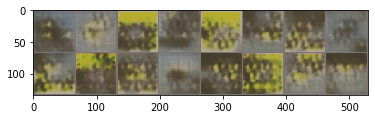

epoch: 17, time: 682.333s, D loss: 0.005, G loss: 8.722
epoch: 17, time: 684.277s, D loss: 0.002, G loss: 8.212
epoch: 17, time: 686.216s, D loss: 0.134, G loss: 7.129
epoch: 17, time: 688.143s, D loss: 0.007, G loss: 7.269
epoch: 17, time: 690.069s, D loss: 0.022, G loss: 6.255


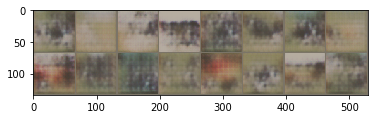

epoch: 17, time: 692.172s, D loss: 0.002, G loss: 10.889
epoch: 17, time: 694.121s, D loss: 0.033, G loss: 6.372
epoch: 17, time: 696.051s, D loss: 0.002, G loss: 7.479
epoch: 17, time: 697.985s, D loss: 0.044, G loss: 6.890
epoch: 18, time: 699.045s, D loss: 0.025, G loss: 5.950


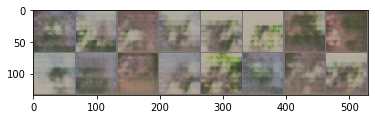

epoch: 18, time: 701.150s, D loss: 0.011, G loss: 8.396
epoch: 18, time: 703.089s, D loss: 0.018, G loss: 11.650
epoch: 18, time: 705.042s, D loss: 0.004, G loss: 9.414
epoch: 18, time: 706.977s, D loss: 0.045, G loss: 8.684
epoch: 18, time: 708.910s, D loss: 0.021, G loss: 10.860


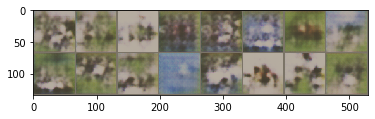

epoch: 18, time: 710.999s, D loss: 0.006, G loss: 8.936
epoch: 18, time: 712.935s, D loss: 0.023, G loss: 6.732
epoch: 18, time: 714.877s, D loss: 0.947, G loss: 10.501
epoch: 18, time: 716.834s, D loss: 0.019, G loss: 8.724
epoch: 18, time: 718.766s, D loss: 0.101, G loss: 6.142


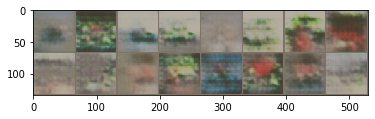

epoch: 18, time: 720.848s, D loss: 0.046, G loss: 5.585
epoch: 18, time: 722.772s, D loss: 0.171, G loss: 6.184
epoch: 18, time: 724.717s, D loss: 0.010, G loss: 12.114
epoch: 18, time: 726.647s, D loss: 0.013, G loss: 7.576
epoch: 18, time: 728.571s, D loss: 0.013, G loss: 5.790


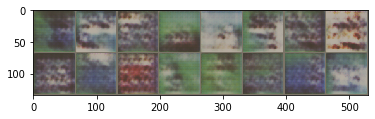

epoch: 18, time: 730.654s, D loss: 0.016, G loss: 7.285
epoch: 18, time: 732.571s, D loss: 0.055, G loss: 7.948
epoch: 18, time: 734.505s, D loss: 0.177, G loss: 5.116
epoch: 18, time: 736.421s, D loss: 0.034, G loss: 5.963
epoch: 19, time: 737.480s, D loss: 0.140, G loss: 5.249


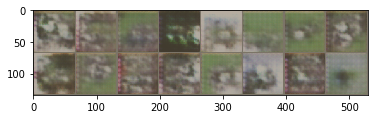

epoch: 19, time: 739.650s, D loss: 0.006, G loss: 8.938
epoch: 19, time: 741.584s, D loss: 0.008, G loss: 7.903
epoch: 19, time: 743.521s, D loss: 0.137, G loss: 5.329
epoch: 19, time: 745.463s, D loss: 0.123, G loss: 10.129
epoch: 19, time: 747.384s, D loss: 0.185, G loss: 7.581


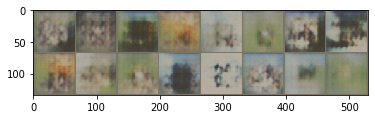

epoch: 19, time: 749.464s, D loss: 0.035, G loss: 9.270
epoch: 19, time: 751.430s, D loss: 0.006, G loss: 7.272
epoch: 19, time: 753.358s, D loss: 0.002, G loss: 11.345
epoch: 19, time: 755.301s, D loss: 0.042, G loss: 6.364
epoch: 19, time: 757.229s, D loss: 0.017, G loss: 6.375


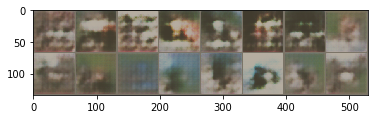

epoch: 19, time: 759.332s, D loss: 0.058, G loss: 4.971
epoch: 19, time: 761.274s, D loss: 0.055, G loss: 12.037
epoch: 19, time: 763.207s, D loss: 0.110, G loss: 4.035
epoch: 19, time: 765.150s, D loss: 0.021, G loss: 6.145
epoch: 19, time: 767.088s, D loss: 0.057, G loss: 5.884


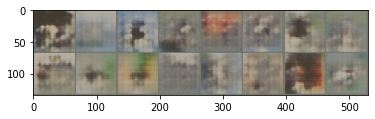

epoch: 19, time: 769.185s, D loss: 0.049, G loss: 6.478
epoch: 19, time: 771.110s, D loss: 0.055, G loss: 6.699
epoch: 19, time: 773.010s, D loss: 0.122, G loss: 5.927
epoch: 19, time: 774.909s, D loss: 0.014, G loss: 7.027
epoch: 20, time: 775.961s, D loss: 0.068, G loss: 6.390


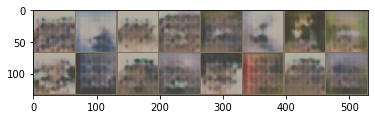

epoch: 20, time: 778.058s, D loss: 0.019, G loss: 7.134
epoch: 20, time: 779.994s, D loss: 0.060, G loss: 8.616
epoch: 20, time: 781.973s, D loss: 0.037, G loss: 6.255
epoch: 20, time: 783.931s, D loss: 0.039, G loss: 6.189
epoch: 20, time: 785.881s, D loss: 0.052, G loss: 7.147


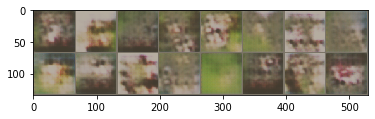

epoch: 20, time: 787.968s, D loss: 0.560, G loss: 13.795
epoch: 20, time: 789.905s, D loss: 0.002, G loss: 10.618
epoch: 20, time: 791.824s, D loss: 0.021, G loss: 6.113
epoch: 20, time: 793.752s, D loss: 0.011, G loss: 11.427
epoch: 20, time: 795.670s, D loss: 0.157, G loss: 6.130


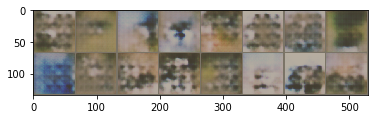

epoch: 20, time: 797.753s, D loss: 0.039, G loss: 14.753
epoch: 20, time: 799.678s, D loss: 0.071, G loss: 6.910
epoch: 20, time: 801.602s, D loss: 0.125, G loss: 6.384
epoch: 20, time: 803.544s, D loss: 0.044, G loss: 15.940
epoch: 20, time: 805.492s, D loss: 0.107, G loss: 6.202


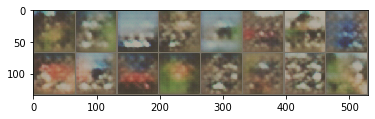

epoch: 20, time: 807.564s, D loss: 0.119, G loss: 5.787
epoch: 20, time: 809.495s, D loss: 0.044, G loss: 6.724
epoch: 20, time: 811.436s, D loss: 0.024, G loss: 7.273
epoch: 20, time: 813.361s, D loss: 0.039, G loss: 5.202
epoch: 21, time: 814.428s, D loss: 0.028, G loss: 6.759


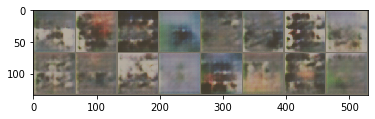

epoch: 21, time: 816.508s, D loss: 0.047, G loss: 5.559
epoch: 21, time: 818.435s, D loss: 0.073, G loss: 5.093
epoch: 21, time: 820.359s, D loss: 0.039, G loss: 6.672
epoch: 21, time: 822.276s, D loss: 0.036, G loss: 6.295
epoch: 21, time: 824.208s, D loss: 0.033, G loss: 5.019


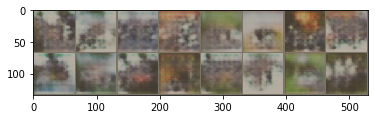

epoch: 21, time: 826.294s, D loss: 0.011, G loss: 7.809
epoch: 21, time: 828.212s, D loss: 0.086, G loss: 5.861
epoch: 21, time: 830.138s, D loss: 0.103, G loss: 6.220
epoch: 21, time: 832.081s, D loss: 0.126, G loss: 6.773
epoch: 21, time: 834.025s, D loss: 0.020, G loss: 6.124


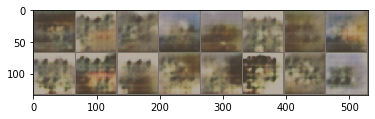

epoch: 21, time: 836.131s, D loss: 0.083, G loss: 5.655
epoch: 21, time: 838.065s, D loss: 0.026, G loss: 7.527
epoch: 21, time: 839.988s, D loss: 0.225, G loss: 5.217
epoch: 21, time: 841.924s, D loss: 0.025, G loss: 6.468
epoch: 21, time: 843.866s, D loss: 0.035, G loss: 7.280


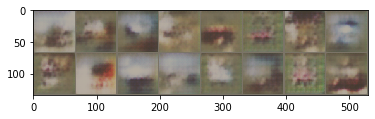

epoch: 21, time: 845.976s, D loss: 0.152, G loss: 6.455
epoch: 21, time: 847.894s, D loss: 0.019, G loss: 6.429
epoch: 21, time: 849.821s, D loss: 0.022, G loss: 5.045
epoch: 21, time: 851.746s, D loss: 0.009, G loss: 10.613
epoch: 22, time: 852.803s, D loss: 0.058, G loss: 6.876


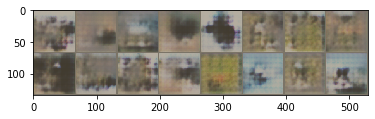

epoch: 22, time: 854.894s, D loss: 0.192, G loss: 4.936
epoch: 22, time: 856.822s, D loss: 0.005, G loss: 8.351
epoch: 22, time: 858.760s, D loss: 0.041, G loss: 8.246
epoch: 22, time: 860.700s, D loss: 0.014, G loss: 7.464
epoch: 22, time: 862.640s, D loss: 0.009, G loss: 9.380


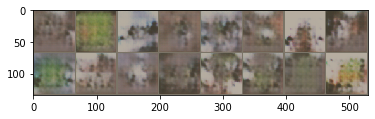

epoch: 22, time: 864.753s, D loss: 0.064, G loss: 9.739
epoch: 22, time: 866.710s, D loss: 0.037, G loss: 8.426
epoch: 22, time: 868.635s, D loss: 0.005, G loss: 9.011
epoch: 22, time: 870.560s, D loss: 0.112, G loss: 14.376
epoch: 22, time: 872.529s, D loss: 0.014, G loss: 8.162


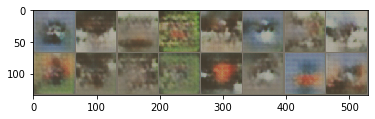

epoch: 22, time: 874.670s, D loss: 0.016, G loss: 7.269
epoch: 22, time: 876.611s, D loss: 0.032, G loss: 6.586
epoch: 22, time: 878.562s, D loss: 0.134, G loss: 7.891
epoch: 22, time: 880.505s, D loss: 0.014, G loss: 7.461
epoch: 22, time: 882.443s, D loss: 0.069, G loss: 6.456


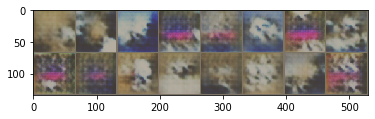

epoch: 22, time: 884.532s, D loss: 0.014, G loss: 6.769
epoch: 22, time: 886.465s, D loss: 0.000, G loss: 8.557
epoch: 22, time: 888.390s, D loss: 0.021, G loss: 9.634
epoch: 22, time: 890.316s, D loss: 0.045, G loss: 6.218
epoch: 23, time: 891.396s, D loss: 0.012, G loss: 6.292


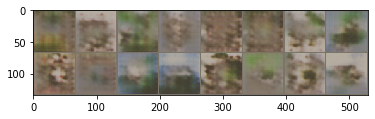

epoch: 23, time: 893.476s, D loss: 0.082, G loss: 5.455
epoch: 23, time: 895.433s, D loss: 0.004, G loss: 8.886
epoch: 23, time: 897.381s, D loss: 0.025, G loss: 10.568
epoch: 23, time: 899.284s, D loss: 0.070, G loss: 5.797
epoch: 23, time: 901.180s, D loss: 0.041, G loss: 5.374


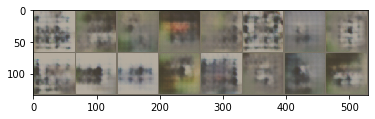

epoch: 23, time: 903.295s, D loss: 0.096, G loss: 5.914
epoch: 23, time: 905.252s, D loss: 0.037, G loss: 8.074
epoch: 23, time: 907.182s, D loss: 0.043, G loss: 11.487
epoch: 23, time: 909.110s, D loss: 0.012, G loss: 8.794
epoch: 23, time: 911.032s, D loss: 0.036, G loss: 7.296


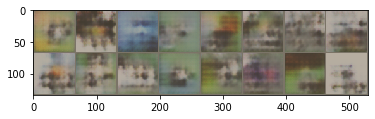

epoch: 23, time: 913.106s, D loss: 0.034, G loss: 5.958
epoch: 23, time: 915.044s, D loss: 0.059, G loss: 7.048
epoch: 23, time: 916.974s, D loss: 0.007, G loss: 8.615
epoch: 23, time: 918.893s, D loss: 0.021, G loss: 6.290
epoch: 23, time: 920.815s, D loss: 0.023, G loss: 7.097


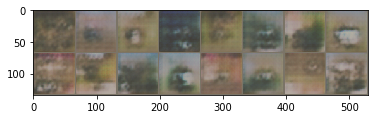

epoch: 23, time: 922.897s, D loss: 0.044, G loss: 9.283
epoch: 23, time: 924.838s, D loss: 0.026, G loss: 5.248
epoch: 23, time: 926.787s, D loss: 0.008, G loss: 6.891
epoch: 23, time: 928.712s, D loss: 0.063, G loss: 6.665
epoch: 24, time: 929.778s, D loss: 0.021, G loss: 6.614


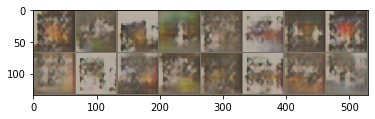

epoch: 24, time: 931.872s, D loss: 0.055, G loss: 7.220
epoch: 24, time: 933.802s, D loss: 0.014, G loss: 6.571
epoch: 24, time: 935.737s, D loss: 0.156, G loss: 4.861
epoch: 24, time: 937.667s, D loss: 0.002, G loss: 9.540
epoch: 24, time: 939.612s, D loss: 0.064, G loss: 9.423


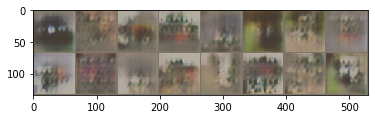

epoch: 24, time: 941.692s, D loss: 0.020, G loss: 10.100
epoch: 24, time: 943.637s, D loss: 0.138, G loss: 8.398
epoch: 24, time: 945.597s, D loss: 0.034, G loss: 6.436
epoch: 24, time: 947.538s, D loss: 0.108, G loss: 5.955
epoch: 24, time: 949.468s, D loss: 0.026, G loss: 8.613


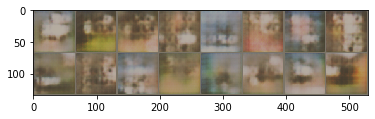

epoch: 24, time: 951.555s, D loss: 0.005, G loss: 8.452
epoch: 24, time: 953.471s, D loss: 0.013, G loss: 6.414
epoch: 24, time: 955.441s, D loss: 0.013, G loss: 8.416
epoch: 24, time: 957.370s, D loss: 0.011, G loss: 7.205
epoch: 24, time: 959.308s, D loss: 0.039, G loss: 5.490


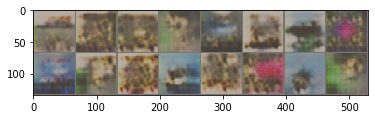

epoch: 24, time: 961.404s, D loss: 0.021, G loss: 6.003
epoch: 24, time: 963.325s, D loss: 0.002, G loss: 6.942
epoch: 24, time: 965.279s, D loss: 0.015, G loss: 6.764
epoch: 24, time: 967.207s, D loss: 0.013, G loss: 5.843
epoch: 25, time: 968.271s, D loss: 0.001, G loss: 11.432


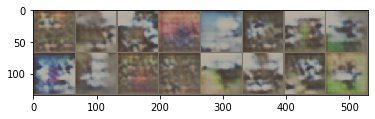

epoch: 25, time: 970.342s, D loss: 0.181, G loss: 7.116
epoch: 25, time: 972.271s, D loss: 0.145, G loss: 5.596
epoch: 25, time: 974.194s, D loss: 0.086, G loss: 14.778
epoch: 25, time: 976.133s, D loss: 0.032, G loss: 10.164
epoch: 25, time: 978.042s, D loss: 0.024, G loss: 9.477


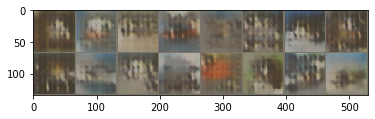

epoch: 25, time: 980.144s, D loss: 0.049, G loss: 8.377
epoch: 25, time: 982.073s, D loss: 0.003, G loss: 17.634
epoch: 25, time: 983.997s, D loss: 0.002, G loss: 9.930
epoch: 25, time: 985.963s, D loss: 0.001, G loss: 10.681
epoch: 25, time: 987.937s, D loss: 0.006, G loss: 9.898


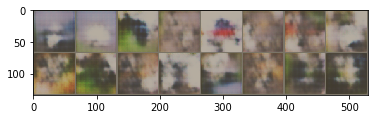

epoch: 25, time: 990.062s, D loss: 0.007, G loss: 8.732
epoch: 25, time: 992.082s, D loss: 0.089, G loss: 8.125
epoch: 25, time: 994.043s, D loss: 0.061, G loss: 6.613
epoch: 25, time: 995.986s, D loss: 0.010, G loss: 7.592
epoch: 25, time: 997.929s, D loss: 0.040, G loss: 4.821


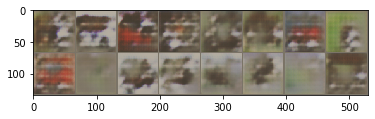

epoch: 25, time: 1000.025s, D loss: 0.069, G loss: 7.108
epoch: 25, time: 1001.952s, D loss: 0.004, G loss: 10.125
epoch: 25, time: 1003.881s, D loss: 0.112, G loss: 5.898
epoch: 25, time: 1005.823s, D loss: 0.142, G loss: 5.675
epoch: 26, time: 1006.883s, D loss: 0.023, G loss: 7.346


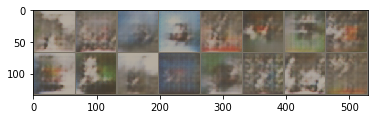

epoch: 26, time: 1008.980s, D loss: 0.020, G loss: 6.829
epoch: 26, time: 1010.908s, D loss: 0.018, G loss: 7.363
epoch: 26, time: 1012.820s, D loss: 0.024, G loss: 7.636
epoch: 26, time: 1014.754s, D loss: 0.029, G loss: 7.590
epoch: 26, time: 1016.701s, D loss: 0.125, G loss: 4.894


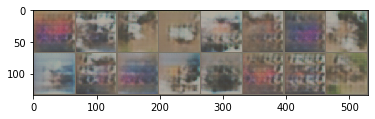

epoch: 26, time: 1018.783s, D loss: 0.011, G loss: 8.668
epoch: 26, time: 1020.716s, D loss: 0.012, G loss: 8.393
epoch: 26, time: 1022.673s, D loss: 0.024, G loss: 6.761
epoch: 26, time: 1024.617s, D loss: 0.009, G loss: 8.913
epoch: 26, time: 1026.516s, D loss: 0.068, G loss: 5.530


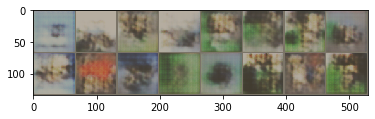

epoch: 26, time: 1028.576s, D loss: 0.029, G loss: 5.856
epoch: 26, time: 1030.509s, D loss: 0.104, G loss: 17.618
epoch: 26, time: 1032.439s, D loss: 0.097, G loss: 14.689
epoch: 26, time: 1034.391s, D loss: 0.075, G loss: 7.682
epoch: 26, time: 1036.307s, D loss: 0.332, G loss: 5.217


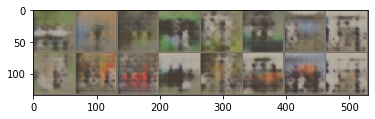

epoch: 26, time: 1038.390s, D loss: 0.019, G loss: 10.504
epoch: 26, time: 1040.339s, D loss: 0.017, G loss: 6.777
epoch: 26, time: 1042.276s, D loss: 0.076, G loss: 6.658
epoch: 26, time: 1044.206s, D loss: 0.108, G loss: 6.322
epoch: 27, time: 1045.270s, D loss: 0.024, G loss: 12.689


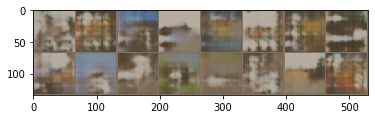

epoch: 27, time: 1047.361s, D loss: 0.017, G loss: 7.599
epoch: 27, time: 1049.286s, D loss: 0.022, G loss: 9.572
epoch: 27, time: 1051.247s, D loss: 0.004, G loss: 11.000
epoch: 27, time: 1053.188s, D loss: 0.079, G loss: 6.349
epoch: 27, time: 1055.133s, D loss: 0.007, G loss: 9.557


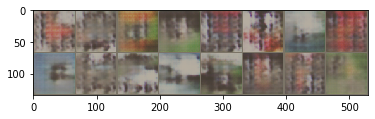

epoch: 27, time: 1057.212s, D loss: 0.086, G loss: 12.007
epoch: 27, time: 1059.159s, D loss: 0.101, G loss: 7.421
epoch: 27, time: 1061.101s, D loss: 0.066, G loss: 10.399
epoch: 27, time: 1063.020s, D loss: 0.033, G loss: 7.244
epoch: 27, time: 1064.998s, D loss: 0.016, G loss: 7.388


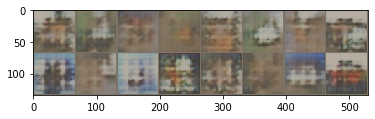

epoch: 27, time: 1067.159s, D loss: 0.017, G loss: 9.486
epoch: 27, time: 1069.085s, D loss: 0.014, G loss: 7.161
epoch: 27, time: 1071.027s, D loss: 0.020, G loss: 7.189
epoch: 27, time: 1072.975s, D loss: 1.541, G loss: 12.572
epoch: 27, time: 1074.912s, D loss: 0.005, G loss: 11.666


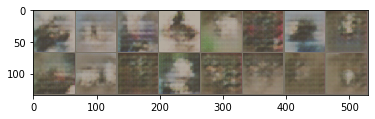

epoch: 27, time: 1077.011s, D loss: 0.041, G loss: 6.341
epoch: 27, time: 1078.926s, D loss: 0.160, G loss: 6.974
epoch: 27, time: 1080.852s, D loss: 0.006, G loss: 12.093
epoch: 27, time: 1082.816s, D loss: 0.000, G loss: 13.839
epoch: 28, time: 1083.888s, D loss: 0.004, G loss: 9.499


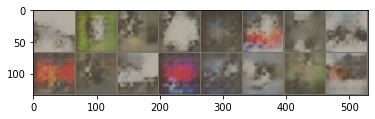

epoch: 28, time: 1085.976s, D loss: 0.023, G loss: 11.608
epoch: 28, time: 1087.904s, D loss: 0.038, G loss: 6.151
epoch: 28, time: 1089.838s, D loss: 0.023, G loss: 8.526
epoch: 28, time: 1091.783s, D loss: 0.040, G loss: 6.780
epoch: 28, time: 1093.713s, D loss: 0.025, G loss: 7.512


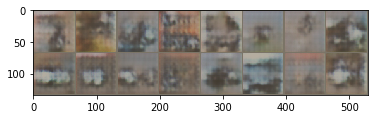

epoch: 28, time: 1095.802s, D loss: 0.013, G loss: 8.153
epoch: 28, time: 1097.725s, D loss: 0.009, G loss: 7.702
epoch: 28, time: 1099.664s, D loss: 0.016, G loss: 8.653
epoch: 28, time: 1101.601s, D loss: 0.035, G loss: 7.986
epoch: 28, time: 1103.556s, D loss: 0.069, G loss: 5.626


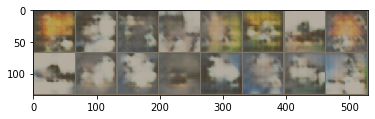

epoch: 28, time: 1105.661s, D loss: 0.014, G loss: 7.824
epoch: 28, time: 1107.596s, D loss: 0.054, G loss: 8.118
epoch: 28, time: 1109.528s, D loss: 0.031, G loss: 6.993
epoch: 28, time: 1111.483s, D loss: 0.008, G loss: 7.173
epoch: 28, time: 1113.426s, D loss: 0.035, G loss: 10.501


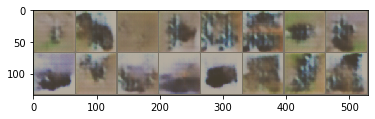

epoch: 28, time: 1115.516s, D loss: 0.019, G loss: 6.162
epoch: 28, time: 1117.440s, D loss: 0.008, G loss: 7.038
epoch: 28, time: 1119.372s, D loss: 0.002, G loss: 15.214
epoch: 28, time: 1121.305s, D loss: 0.031, G loss: 10.115
epoch: 29, time: 1122.364s, D loss: 0.020, G loss: 10.401


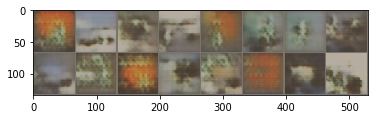

epoch: 29, time: 1124.468s, D loss: 0.007, G loss: 7.843
epoch: 29, time: 1126.394s, D loss: 0.067, G loss: 5.551
epoch: 29, time: 1128.331s, D loss: 0.055, G loss: 6.410
epoch: 29, time: 1130.261s, D loss: 0.011, G loss: 8.089
epoch: 29, time: 1132.208s, D loss: 0.015, G loss: 6.706


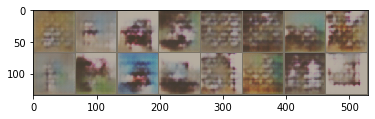

epoch: 29, time: 1134.314s, D loss: 0.035, G loss: 9.477
epoch: 29, time: 1136.243s, D loss: 0.097, G loss: 4.717
epoch: 29, time: 1138.170s, D loss: 0.181, G loss: 6.950
epoch: 29, time: 1140.104s, D loss: 0.052, G loss: 9.945
epoch: 29, time: 1142.059s, D loss: 0.128, G loss: 6.084


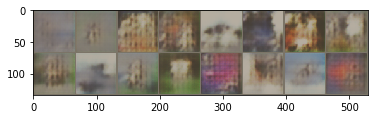

epoch: 29, time: 1144.151s, D loss: 0.040, G loss: 7.855
epoch: 29, time: 1146.110s, D loss: 0.034, G loss: 6.771
epoch: 29, time: 1148.048s, D loss: 0.041, G loss: 6.420
epoch: 29, time: 1149.996s, D loss: 0.112, G loss: 6.306
epoch: 29, time: 1151.911s, D loss: 0.003, G loss: 12.569


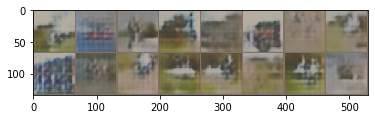

epoch: 29, time: 1153.970s, D loss: 0.019, G loss: 8.757
epoch: 29, time: 1155.891s, D loss: 0.058, G loss: 5.656
epoch: 29, time: 1157.818s, D loss: 0.024, G loss: 7.227
epoch: 29, time: 1159.748s, D loss: 0.023, G loss: 6.911
epoch: 30, time: 1160.817s, D loss: 0.006, G loss: 12.046


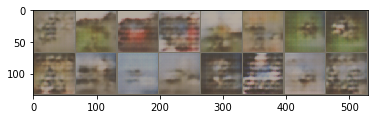

epoch: 30, time: 1162.902s, D loss: 0.001, G loss: 11.108
epoch: 30, time: 1164.854s, D loss: 0.087, G loss: 6.228
epoch: 30, time: 1166.808s, D loss: 0.029, G loss: 7.072
epoch: 30, time: 1168.731s, D loss: 0.082, G loss: 7.063
epoch: 30, time: 1170.657s, D loss: 0.037, G loss: 5.740


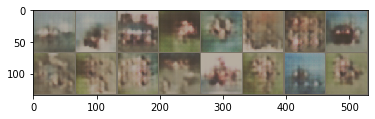

epoch: 30, time: 1172.749s, D loss: 0.016, G loss: 9.773
epoch: 30, time: 1174.704s, D loss: 0.098, G loss: 5.538
epoch: 30, time: 1176.642s, D loss: 0.023, G loss: 6.348
epoch: 30, time: 1178.574s, D loss: 0.005, G loss: 10.183
epoch: 30, time: 1180.527s, D loss: 0.056, G loss: 5.880


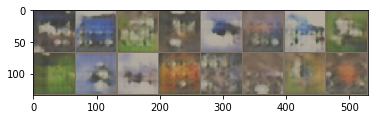

epoch: 30, time: 1182.661s, D loss: 0.015, G loss: 9.389
epoch: 30, time: 1184.615s, D loss: 0.044, G loss: 6.030
epoch: 30, time: 1186.551s, D loss: 0.011, G loss: 6.679
epoch: 30, time: 1188.495s, D loss: 0.024, G loss: 5.102
epoch: 30, time: 1190.449s, D loss: 0.003, G loss: 8.256


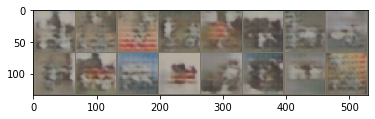

epoch: 30, time: 1192.588s, D loss: 0.053, G loss: 6.149
epoch: 30, time: 1194.533s, D loss: 0.038, G loss: 7.705
epoch: 30, time: 1196.483s, D loss: 0.044, G loss: 11.117
epoch: 30, time: 1198.414s, D loss: 0.012, G loss: 8.956
epoch: 31, time: 1199.469s, D loss: 0.074, G loss: 6.465


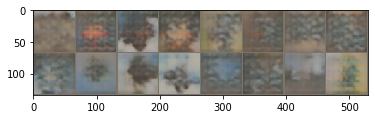

epoch: 31, time: 1201.577s, D loss: 0.010, G loss: 8.201
epoch: 31, time: 1203.502s, D loss: 0.005, G loss: 8.031
epoch: 31, time: 1205.447s, D loss: 0.058, G loss: 10.917
epoch: 31, time: 1207.405s, D loss: 0.118, G loss: 11.444
epoch: 31, time: 1209.337s, D loss: 0.011, G loss: 9.864


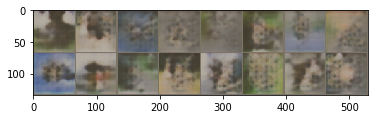

epoch: 31, time: 1211.419s, D loss: 0.112, G loss: 8.186
epoch: 31, time: 1213.339s, D loss: 0.054, G loss: 6.696
epoch: 31, time: 1215.268s, D loss: 0.015, G loss: 7.281
epoch: 31, time: 1217.211s, D loss: 0.001, G loss: 18.703
epoch: 31, time: 1219.145s, D loss: 0.004, G loss: 11.670


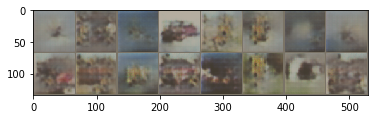

epoch: 31, time: 1221.231s, D loss: 0.028, G loss: 13.434
epoch: 31, time: 1223.164s, D loss: 0.050, G loss: 10.042
epoch: 31, time: 1225.135s, D loss: 0.023, G loss: 7.614
epoch: 31, time: 1227.070s, D loss: 0.025, G loss: 6.383
epoch: 31, time: 1228.993s, D loss: 0.020, G loss: 10.603


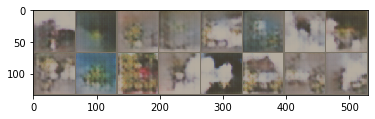

epoch: 31, time: 1231.135s, D loss: 0.004, G loss: 9.544
epoch: 31, time: 1233.073s, D loss: 0.085, G loss: 9.484
epoch: 31, time: 1235.016s, D loss: 0.083, G loss: 5.951
epoch: 31, time: 1236.941s, D loss: 0.141, G loss: 5.176
epoch: 32, time: 1238.029s, D loss: 0.264, G loss: 10.082


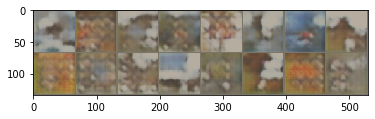

epoch: 32, time: 1240.115s, D loss: 0.043, G loss: 6.411
epoch: 32, time: 1242.064s, D loss: 0.048, G loss: 5.798
epoch: 32, time: 1243.994s, D loss: 0.065, G loss: 6.961
epoch: 32, time: 1245.922s, D loss: 0.035, G loss: 9.336
epoch: 32, time: 1247.863s, D loss: 0.008, G loss: 8.008


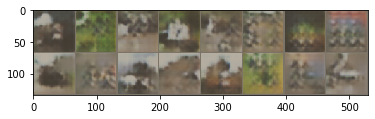

epoch: 32, time: 1249.934s, D loss: 0.054, G loss: 11.634
epoch: 32, time: 1251.889s, D loss: 0.014, G loss: 6.628
epoch: 32, time: 1253.822s, D loss: 0.033, G loss: 7.499
epoch: 32, time: 1255.776s, D loss: 0.006, G loss: 7.129
epoch: 32, time: 1257.705s, D loss: 0.025, G loss: 8.370


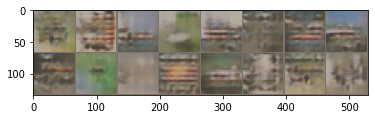

epoch: 32, time: 1259.780s, D loss: 0.037, G loss: 6.051
epoch: 32, time: 1261.748s, D loss: 0.014, G loss: 5.736
epoch: 32, time: 1263.683s, D loss: 0.015, G loss: 8.038
epoch: 32, time: 1265.640s, D loss: 0.011, G loss: 7.400
epoch: 32, time: 1267.582s, D loss: 0.010, G loss: 8.039


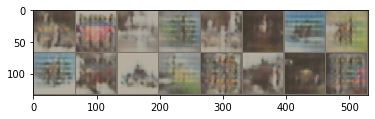

epoch: 32, time: 1269.694s, D loss: 0.005, G loss: 9.033
epoch: 32, time: 1271.641s, D loss: 0.010, G loss: 6.040
epoch: 32, time: 1273.567s, D loss: 0.010, G loss: 7.479
epoch: 32, time: 1275.518s, D loss: 0.015, G loss: 8.070
epoch: 33, time: 1276.579s, D loss: 0.008, G loss: 6.609


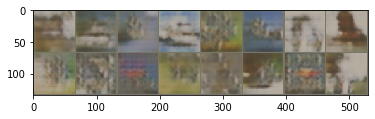

epoch: 33, time: 1278.671s, D loss: 0.016, G loss: 6.598
epoch: 33, time: 1280.556s, D loss: 0.024, G loss: 8.285
epoch: 33, time: 1282.460s, D loss: 0.030, G loss: 6.732
epoch: 33, time: 1284.368s, D loss: 0.015, G loss: 9.969
epoch: 33, time: 1286.328s, D loss: 0.022, G loss: 6.932


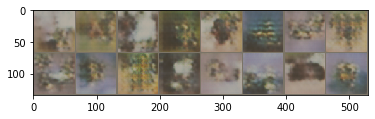

epoch: 33, time: 1288.396s, D loss: 0.006, G loss: 9.165
epoch: 33, time: 1290.311s, D loss: 0.016, G loss: 7.232
epoch: 33, time: 1292.244s, D loss: 0.009, G loss: 9.977
epoch: 33, time: 1294.180s, D loss: 0.045, G loss: 5.717
epoch: 33, time: 1296.145s, D loss: 0.018, G loss: 7.357


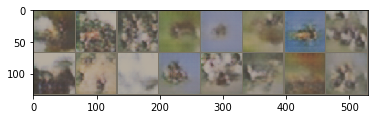

epoch: 33, time: 1298.218s, D loss: 0.035, G loss: 5.719
epoch: 33, time: 1300.155s, D loss: 0.017, G loss: 6.791
epoch: 33, time: 1302.108s, D loss: 0.008, G loss: 9.481
epoch: 33, time: 1304.026s, D loss: 0.045, G loss: 6.439
epoch: 33, time: 1305.963s, D loss: 0.015, G loss: 7.159


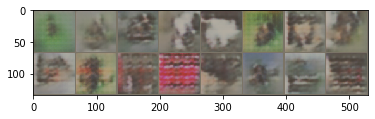

epoch: 33, time: 1308.053s, D loss: 0.096, G loss: 3.332
epoch: 33, time: 1309.987s, D loss: 0.039, G loss: 5.966
epoch: 33, time: 1311.918s, D loss: 0.028, G loss: 6.211
epoch: 33, time: 1313.863s, D loss: 0.530, G loss: 8.232
epoch: 34, time: 1314.937s, D loss: 0.015, G loss: 16.000


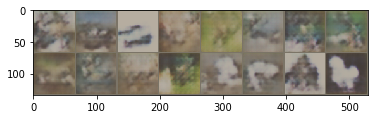

epoch: 34, time: 1317.054s, D loss: 0.024, G loss: 8.252
epoch: 34, time: 1318.981s, D loss: 0.010, G loss: 8.406
epoch: 34, time: 1320.896s, D loss: 0.499, G loss: 9.747
epoch: 34, time: 1322.834s, D loss: 0.479, G loss: 8.872
epoch: 34, time: 1324.786s, D loss: 0.024, G loss: 8.498


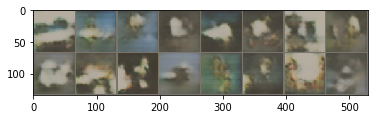

epoch: 34, time: 1326.868s, D loss: 0.020, G loss: 8.478
epoch: 34, time: 1328.796s, D loss: 0.012, G loss: 9.726
epoch: 34, time: 1330.723s, D loss: 0.005, G loss: 9.109
epoch: 34, time: 1332.644s, D loss: 0.046, G loss: 6.027
epoch: 34, time: 1334.580s, D loss: 0.017, G loss: 9.239


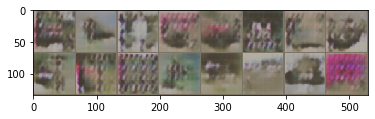

epoch: 34, time: 1336.648s, D loss: 0.070, G loss: 6.215
epoch: 34, time: 1338.582s, D loss: 0.050, G loss: 8.349
epoch: 34, time: 1340.525s, D loss: 0.019, G loss: 7.104
epoch: 34, time: 1342.474s, D loss: 0.048, G loss: 4.556
epoch: 34, time: 1344.433s, D loss: 0.011, G loss: 6.643


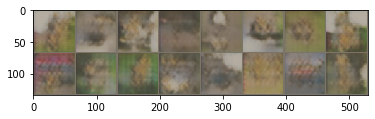

epoch: 34, time: 1346.552s, D loss: 0.027, G loss: 4.784
epoch: 34, time: 1348.487s, D loss: 0.015, G loss: 6.053
epoch: 34, time: 1350.424s, D loss: 0.032, G loss: 6.732
epoch: 34, time: 1352.412s, D loss: 0.052, G loss: 9.028
epoch: 35, time: 1353.470s, D loss: 0.016, G loss: 8.658


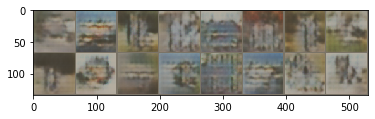

epoch: 35, time: 1355.565s, D loss: 0.004, G loss: 9.082
epoch: 35, time: 1357.500s, D loss: 0.073, G loss: 6.100
epoch: 35, time: 1359.428s, D loss: 0.026, G loss: 6.895
epoch: 35, time: 1361.363s, D loss: 0.027, G loss: 6.931
epoch: 35, time: 1363.281s, D loss: 0.041, G loss: 8.899


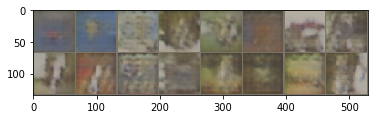

epoch: 35, time: 1365.380s, D loss: 0.026, G loss: 10.087
epoch: 35, time: 1367.309s, D loss: 0.026, G loss: 6.819
epoch: 35, time: 1369.254s, D loss: 0.040, G loss: 6.056
epoch: 35, time: 1371.198s, D loss: 0.206, G loss: 6.768
epoch: 35, time: 1373.163s, D loss: 0.012, G loss: 7.494


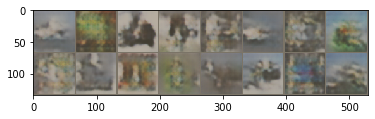

epoch: 35, time: 1375.258s, D loss: 0.032, G loss: 6.580
epoch: 35, time: 1377.204s, D loss: 0.026, G loss: 6.770
epoch: 35, time: 1379.137s, D loss: 0.017, G loss: 9.835
epoch: 35, time: 1381.063s, D loss: 0.018, G loss: 5.612
epoch: 35, time: 1383.011s, D loss: 0.051, G loss: 12.567


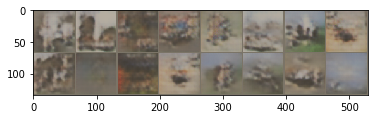

epoch: 35, time: 1385.134s, D loss: 0.101, G loss: 6.660
epoch: 35, time: 1387.043s, D loss: 0.113, G loss: 3.715
epoch: 35, time: 1388.965s, D loss: 0.068, G loss: 5.471
epoch: 35, time: 1390.897s, D loss: 0.041, G loss: 6.065
epoch: 36, time: 1391.977s, D loss: 0.034, G loss: 5.902


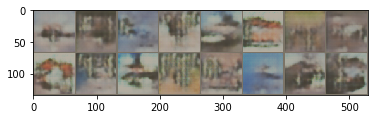

epoch: 36, time: 1394.143s, D loss: 0.026, G loss: 9.179
epoch: 36, time: 1396.085s, D loss: 0.028, G loss: 6.392
epoch: 36, time: 1397.998s, D loss: 0.048, G loss: 7.712
epoch: 36, time: 1399.918s, D loss: 0.011, G loss: 8.513
epoch: 36, time: 1401.853s, D loss: 0.015, G loss: 9.539


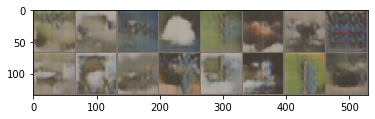

epoch: 36, time: 1403.937s, D loss: 0.005, G loss: 9.200
epoch: 36, time: 1405.884s, D loss: 0.005, G loss: 16.831
epoch: 36, time: 1407.781s, D loss: 0.037, G loss: 7.344
epoch: 36, time: 1409.662s, D loss: 0.041, G loss: 9.498
epoch: 36, time: 1411.604s, D loss: 0.040, G loss: 6.108


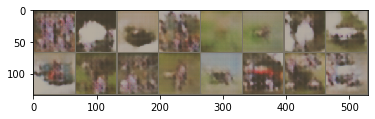

epoch: 36, time: 1413.693s, D loss: 0.039, G loss: 7.076
epoch: 36, time: 1415.624s, D loss: 0.020, G loss: 8.156
epoch: 36, time: 1417.529s, D loss: 0.051, G loss: 8.069
epoch: 36, time: 1419.456s, D loss: 0.008, G loss: 7.389
epoch: 36, time: 1421.390s, D loss: 0.084, G loss: 6.006


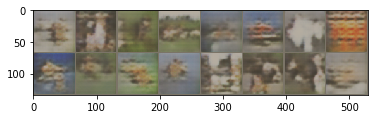

epoch: 36, time: 1423.483s, D loss: 0.008, G loss: 9.789
epoch: 36, time: 1425.448s, D loss: 0.002, G loss: 12.377
epoch: 36, time: 1427.379s, D loss: 0.008, G loss: 7.823
epoch: 36, time: 1429.314s, D loss: 0.031, G loss: 9.856
epoch: 37, time: 1430.383s, D loss: 0.002, G loss: 10.083


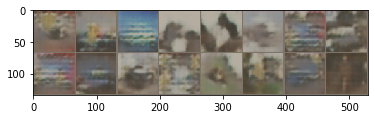

epoch: 37, time: 1432.487s, D loss: 0.028, G loss: 11.732
epoch: 37, time: 1434.429s, D loss: 0.012, G loss: 7.647
epoch: 37, time: 1436.370s, D loss: 0.038, G loss: 6.427
epoch: 37, time: 1438.304s, D loss: 0.107, G loss: 6.728
epoch: 37, time: 1440.235s, D loss: 0.003, G loss: 9.916


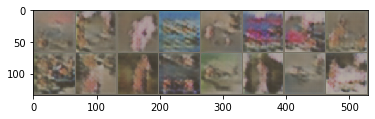

epoch: 37, time: 1442.326s, D loss: 0.020, G loss: 9.150
epoch: 37, time: 1444.266s, D loss: 0.011, G loss: 9.607
epoch: 37, time: 1446.185s, D loss: 0.003, G loss: 12.406
epoch: 37, time: 1448.124s, D loss: 0.092, G loss: 5.524
epoch: 37, time: 1450.065s, D loss: 0.013, G loss: 7.974


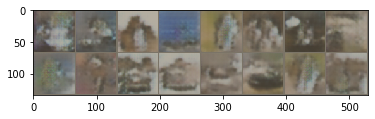

epoch: 37, time: 1452.124s, D loss: 0.205, G loss: 7.273
epoch: 37, time: 1454.051s, D loss: 0.051, G loss: 10.962
epoch: 37, time: 1455.986s, D loss: 0.006, G loss: 7.300
epoch: 37, time: 1457.897s, D loss: 0.010, G loss: 10.049
epoch: 37, time: 1459.819s, D loss: 0.054, G loss: 9.235


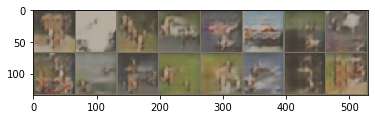

epoch: 37, time: 1461.914s, D loss: 0.002, G loss: 9.590
epoch: 37, time: 1463.845s, D loss: 0.009, G loss: 7.279
epoch: 37, time: 1465.800s, D loss: 0.019, G loss: 7.604
epoch: 37, time: 1467.711s, D loss: 0.006, G loss: 9.156
epoch: 38, time: 1468.771s, D loss: 0.011, G loss: 8.918


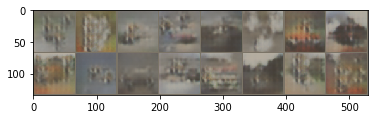

epoch: 38, time: 1470.850s, D loss: 0.023, G loss: 5.416
epoch: 38, time: 1472.794s, D loss: 0.045, G loss: 5.765
epoch: 38, time: 1474.751s, D loss: 0.037, G loss: 4.951
epoch: 38, time: 1476.683s, D loss: 0.130, G loss: 5.255
epoch: 38, time: 1478.607s, D loss: 0.043, G loss: 4.373


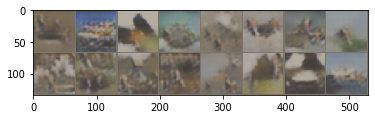

epoch: 38, time: 1480.680s, D loss: 0.095, G loss: 6.038
epoch: 38, time: 1482.608s, D loss: 0.015, G loss: 7.087
epoch: 38, time: 1484.548s, D loss: 0.022, G loss: 6.248
epoch: 38, time: 1486.495s, D loss: 0.011, G loss: 6.424
epoch: 38, time: 1488.401s, D loss: 0.024, G loss: 8.515


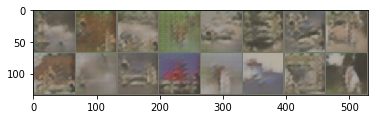

epoch: 38, time: 1490.491s, D loss: 0.013, G loss: 7.327
epoch: 38, time: 1492.427s, D loss: 0.031, G loss: 6.376
epoch: 38, time: 1494.389s, D loss: 0.147, G loss: 5.826
epoch: 38, time: 1496.357s, D loss: 0.022, G loss: 6.383
epoch: 38, time: 1498.307s, D loss: 0.019, G loss: 8.679


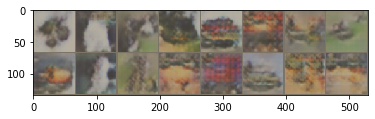

epoch: 38, time: 1500.424s, D loss: 0.025, G loss: 10.672
epoch: 38, time: 1502.400s, D loss: 0.012, G loss: 10.944
epoch: 38, time: 1504.369s, D loss: 0.168, G loss: 5.770
epoch: 38, time: 1506.311s, D loss: 0.045, G loss: 6.807
epoch: 39, time: 1507.381s, D loss: 0.009, G loss: 7.912


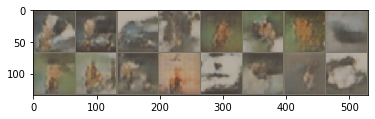

epoch: 39, time: 1509.493s, D loss: 0.038, G loss: 7.443
epoch: 39, time: 1511.464s, D loss: 0.225, G loss: 4.310
epoch: 39, time: 1513.421s, D loss: 0.014, G loss: 6.159
epoch: 39, time: 1515.353s, D loss: 0.051, G loss: 8.469
epoch: 39, time: 1517.269s, D loss: 0.007, G loss: 10.868


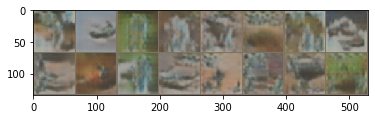

epoch: 39, time: 1519.342s, D loss: 0.010, G loss: 8.351
epoch: 39, time: 1521.289s, D loss: 0.163, G loss: 4.727
epoch: 39, time: 1523.258s, D loss: 0.104, G loss: 10.837
epoch: 39, time: 1525.245s, D loss: 0.000, G loss: 15.758
epoch: 39, time: 1527.288s, D loss: 0.079, G loss: 9.384


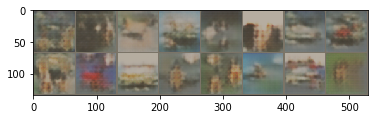

epoch: 39, time: 1529.529s, D loss: 0.116, G loss: 7.160
epoch: 39, time: 1531.635s, D loss: 0.407, G loss: 4.595
epoch: 39, time: 1533.705s, D loss: 0.027, G loss: 6.397
epoch: 39, time: 1535.820s, D loss: 0.032, G loss: 6.167
epoch: 39, time: 1537.932s, D loss: 0.002, G loss: 10.565


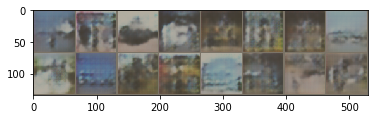

epoch: 39, time: 1540.125s, D loss: 0.017, G loss: 15.351
epoch: 39, time: 1542.069s, D loss: 0.044, G loss: 14.220
epoch: 39, time: 1543.997s, D loss: 0.110, G loss: 9.666
epoch: 39, time: 1545.940s, D loss: 0.208, G loss: 6.313
epoch: 40, time: 1547.020s, D loss: 0.017, G loss: 8.981


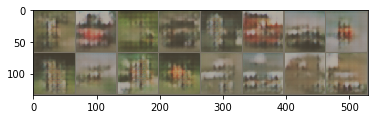

epoch: 40, time: 1549.082s, D loss: 0.030, G loss: 9.013
epoch: 40, time: 1551.010s, D loss: 0.031, G loss: 10.538
epoch: 40, time: 1552.939s, D loss: 0.243, G loss: 8.155
epoch: 40, time: 1554.870s, D loss: 0.043, G loss: 7.862
epoch: 40, time: 1556.785s, D loss: 0.343, G loss: 4.175


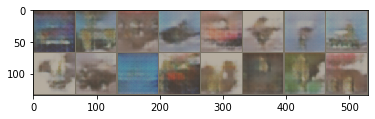

epoch: 40, time: 1558.942s, D loss: 0.019, G loss: 5.153
epoch: 40, time: 1560.859s, D loss: 0.270, G loss: 7.112
epoch: 40, time: 1562.812s, D loss: 0.007, G loss: 11.238
epoch: 40, time: 1564.765s, D loss: 0.046, G loss: 5.675
epoch: 40, time: 1566.677s, D loss: 0.015, G loss: 8.860


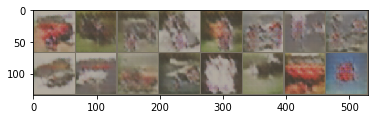

epoch: 40, time: 1568.779s, D loss: 0.034, G loss: 11.072
epoch: 40, time: 1570.713s, D loss: 0.023, G loss: 8.508
epoch: 40, time: 1572.642s, D loss: 0.049, G loss: 7.428
epoch: 40, time: 1574.568s, D loss: 0.085, G loss: 7.114
epoch: 40, time: 1576.502s, D loss: 0.031, G loss: 10.804


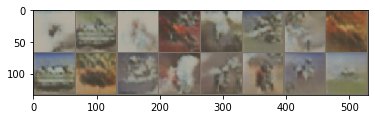

epoch: 40, time: 1578.599s, D loss: 0.001, G loss: 11.201
epoch: 40, time: 1580.529s, D loss: 0.031, G loss: 4.953
epoch: 40, time: 1582.453s, D loss: 0.020, G loss: 8.626
epoch: 40, time: 1584.402s, D loss: 0.140, G loss: 5.100
epoch: 41, time: 1585.489s, D loss: 0.038, G loss: 6.862


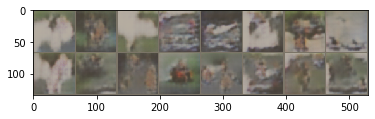

epoch: 41, time: 1587.598s, D loss: 0.007, G loss: 7.129
epoch: 41, time: 1589.532s, D loss: 0.036, G loss: 7.916
epoch: 41, time: 1591.491s, D loss: 0.015, G loss: 5.195
epoch: 41, time: 1593.453s, D loss: 0.156, G loss: 5.224
epoch: 41, time: 1595.402s, D loss: 0.021, G loss: 12.066


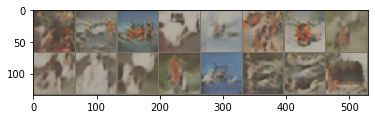

epoch: 41, time: 1597.483s, D loss: 0.034, G loss: 6.403
epoch: 41, time: 1599.429s, D loss: 0.025, G loss: 5.476
epoch: 41, time: 1601.359s, D loss: 0.099, G loss: 4.506
epoch: 41, time: 1603.287s, D loss: 0.013, G loss: 8.246
epoch: 41, time: 1605.233s, D loss: 1.229, G loss: 10.385


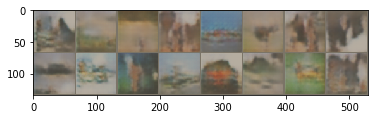

epoch: 41, time: 1607.310s, D loss: 0.008, G loss: 12.543
epoch: 41, time: 1609.235s, D loss: 0.090, G loss: 6.226
epoch: 41, time: 1611.173s, D loss: 0.079, G loss: 4.879
epoch: 41, time: 1613.106s, D loss: 0.007, G loss: 9.426
epoch: 41, time: 1615.035s, D loss: 0.034, G loss: 5.697


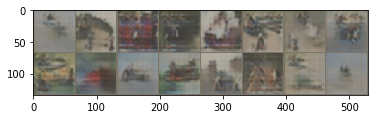

epoch: 41, time: 1617.137s, D loss: 0.005, G loss: 6.671
epoch: 41, time: 1619.083s, D loss: 0.177, G loss: 12.307
epoch: 41, time: 1621.012s, D loss: 0.080, G loss: 12.973
epoch: 41, time: 1622.960s, D loss: 0.029, G loss: 10.207
epoch: 42, time: 1624.040s, D loss: 0.040, G loss: 6.502


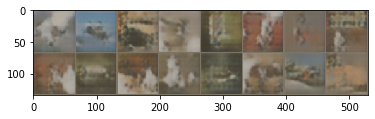

epoch: 42, time: 1626.141s, D loss: 0.028, G loss: 6.822
epoch: 42, time: 1628.071s, D loss: 0.045, G loss: 5.252
epoch: 42, time: 1630.014s, D loss: 0.033, G loss: 6.163
epoch: 42, time: 1631.953s, D loss: 0.356, G loss: 5.886
epoch: 42, time: 1633.870s, D loss: 0.105, G loss: 10.246


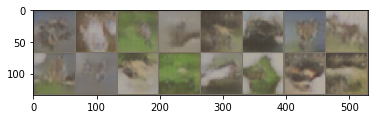

epoch: 42, time: 1635.974s, D loss: 0.191, G loss: 3.775
epoch: 42, time: 1637.900s, D loss: 0.048, G loss: 7.493
epoch: 42, time: 1639.838s, D loss: 0.009, G loss: 8.949
epoch: 42, time: 1641.751s, D loss: 0.079, G loss: 5.609
epoch: 42, time: 1643.674s, D loss: 0.029, G loss: 5.840


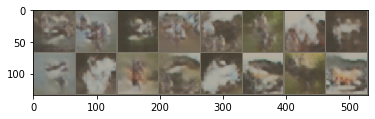

epoch: 42, time: 1645.778s, D loss: 0.030, G loss: 7.158
epoch: 42, time: 1647.704s, D loss: 0.067, G loss: 4.931
epoch: 42, time: 1649.634s, D loss: 0.014, G loss: 8.667
epoch: 42, time: 1651.586s, D loss: 0.022, G loss: 5.200
epoch: 42, time: 1653.528s, D loss: 0.251, G loss: 5.604


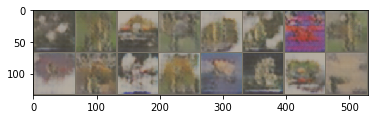

epoch: 42, time: 1655.623s, D loss: 0.008, G loss: 7.109
epoch: 42, time: 1657.552s, D loss: 0.024, G loss: 6.723
epoch: 42, time: 1659.465s, D loss: 0.047, G loss: 6.501
epoch: 42, time: 1661.387s, D loss: 0.110, G loss: 12.620
epoch: 43, time: 1662.454s, D loss: 0.029, G loss: 7.414


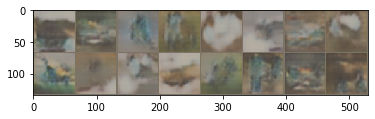

epoch: 43, time: 1664.559s, D loss: 0.007, G loss: 8.585
epoch: 43, time: 1666.488s, D loss: 0.066, G loss: 11.510
epoch: 43, time: 1668.420s, D loss: 0.141, G loss: 6.820
epoch: 43, time: 1670.379s, D loss: 0.014, G loss: 8.324
epoch: 43, time: 1672.328s, D loss: 0.085, G loss: 6.090


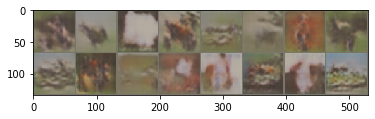

epoch: 43, time: 1674.442s, D loss: 0.015, G loss: 8.206
epoch: 43, time: 1676.416s, D loss: 0.015, G loss: 13.198
epoch: 43, time: 1678.353s, D loss: 0.015, G loss: 6.048
epoch: 43, time: 1680.295s, D loss: 0.074, G loss: 23.941
epoch: 43, time: 1682.233s, D loss: 0.137, G loss: 6.106


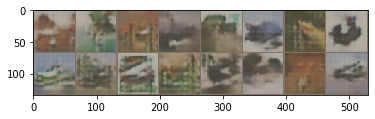

epoch: 43, time: 1684.299s, D loss: 0.044, G loss: 8.564
epoch: 43, time: 1686.198s, D loss: 0.045, G loss: 7.134
epoch: 43, time: 1688.112s, D loss: 0.148, G loss: 3.110
epoch: 43, time: 1690.042s, D loss: 0.090, G loss: 5.454
epoch: 43, time: 1691.982s, D loss: 0.098, G loss: 7.233


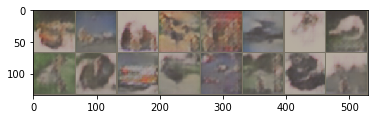

epoch: 43, time: 1694.064s, D loss: 0.060, G loss: 8.505
epoch: 43, time: 1695.990s, D loss: 0.151, G loss: 8.653
epoch: 43, time: 1697.927s, D loss: 0.179, G loss: 4.914
epoch: 43, time: 1699.864s, D loss: 0.025, G loss: 5.845
epoch: 44, time: 1700.938s, D loss: 0.163, G loss: 4.372


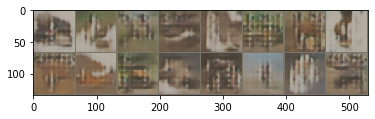

epoch: 44, time: 1703.025s, D loss: 0.023, G loss: 7.606
epoch: 44, time: 1704.985s, D loss: 0.034, G loss: 6.418
epoch: 44, time: 1706.926s, D loss: 0.034, G loss: 6.828
epoch: 44, time: 1708.853s, D loss: 0.188, G loss: 9.870
epoch: 44, time: 1710.794s, D loss: 0.106, G loss: 5.178


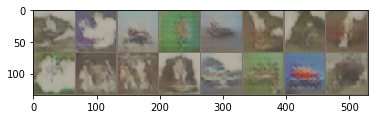

epoch: 44, time: 1712.899s, D loss: 0.029, G loss: 5.562
epoch: 44, time: 1714.849s, D loss: 0.051, G loss: 5.929
epoch: 44, time: 1716.776s, D loss: 0.017, G loss: 8.865
epoch: 44, time: 1718.705s, D loss: 0.025, G loss: 6.872
epoch: 44, time: 1720.642s, D loss: 0.014, G loss: 8.398


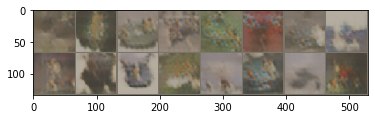

epoch: 44, time: 1722.824s, D loss: 0.053, G loss: 11.414
epoch: 44, time: 1724.761s, D loss: 0.035, G loss: 5.820
epoch: 44, time: 1726.693s, D loss: 0.409, G loss: 11.142
epoch: 44, time: 1728.621s, D loss: 0.025, G loss: 7.521
epoch: 44, time: 1730.543s, D loss: 0.024, G loss: 13.659


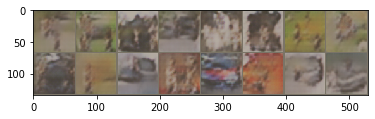

epoch: 44, time: 1732.662s, D loss: 0.168, G loss: 8.250
epoch: 44, time: 1734.605s, D loss: 0.017, G loss: 9.631
epoch: 44, time: 1736.546s, D loss: 0.032, G loss: 8.073
epoch: 44, time: 1738.463s, D loss: 0.051, G loss: 7.414
epoch: 45, time: 1739.517s, D loss: 0.044, G loss: 5.529


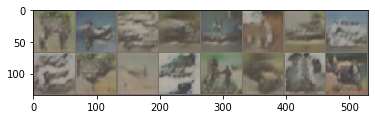

epoch: 45, time: 1741.639s, D loss: 0.083, G loss: 4.791
epoch: 45, time: 1743.581s, D loss: 0.018, G loss: 5.255
epoch: 45, time: 1745.549s, D loss: 0.020, G loss: 7.180
epoch: 45, time: 1747.484s, D loss: 0.061, G loss: 7.167
epoch: 45, time: 1749.427s, D loss: 0.081, G loss: 5.423


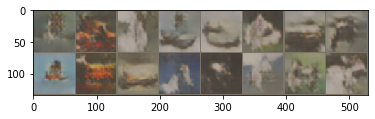

epoch: 45, time: 1751.516s, D loss: 0.019, G loss: 7.447
epoch: 45, time: 1753.470s, D loss: 0.109, G loss: 6.201
epoch: 45, time: 1755.415s, D loss: 0.049, G loss: 4.990
epoch: 45, time: 1757.333s, D loss: 0.026, G loss: 8.427
epoch: 45, time: 1759.257s, D loss: 0.023, G loss: 11.145


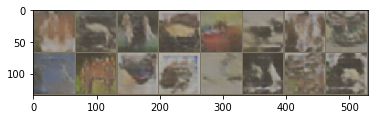

epoch: 45, time: 1761.329s, D loss: 0.012, G loss: 9.406
epoch: 45, time: 1763.258s, D loss: 0.093, G loss: 5.231
epoch: 45, time: 1765.221s, D loss: 0.025, G loss: 6.668
epoch: 45, time: 1767.148s, D loss: 0.169, G loss: 4.818
epoch: 45, time: 1769.075s, D loss: 0.029, G loss: 14.274


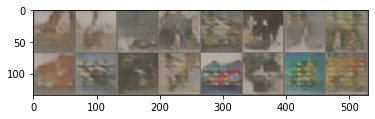

epoch: 45, time: 1771.153s, D loss: 0.018, G loss: 7.642
epoch: 45, time: 1773.091s, D loss: 0.043, G loss: 8.167
epoch: 45, time: 1775.047s, D loss: 0.015, G loss: 5.674
epoch: 45, time: 1776.988s, D loss: 0.197, G loss: 6.238
epoch: 46, time: 1778.060s, D loss: 0.048, G loss: 4.182


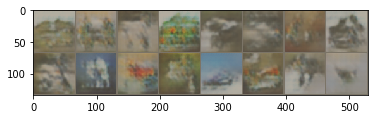

epoch: 46, time: 1780.141s, D loss: 0.003, G loss: 9.738
epoch: 46, time: 1782.071s, D loss: 0.031, G loss: 8.237
epoch: 46, time: 1784.021s, D loss: 0.102, G loss: 6.179
epoch: 46, time: 1785.957s, D loss: 0.008, G loss: 8.925
epoch: 46, time: 1787.902s, D loss: 0.015, G loss: 7.697


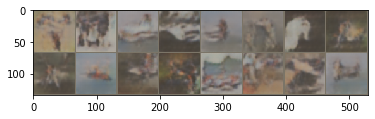

epoch: 46, time: 1789.996s, D loss: 0.074, G loss: 5.440
epoch: 46, time: 1791.939s, D loss: 0.022, G loss: 6.229
epoch: 46, time: 1793.885s, D loss: 0.056, G loss: 8.520
epoch: 46, time: 1795.841s, D loss: 0.010, G loss: 9.604
epoch: 46, time: 1797.777s, D loss: 0.019, G loss: 6.809


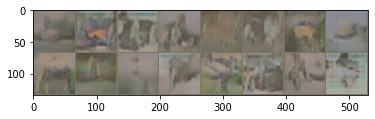

epoch: 46, time: 1799.869s, D loss: 0.031, G loss: 9.007
epoch: 46, time: 1801.840s, D loss: 0.018, G loss: 8.882
epoch: 46, time: 1803.812s, D loss: 4.663, G loss: 6.459
epoch: 46, time: 1805.794s, D loss: 0.179, G loss: 5.974
epoch: 46, time: 1807.748s, D loss: 0.039, G loss: 7.260


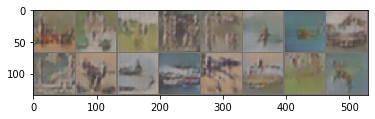

epoch: 46, time: 1809.850s, D loss: 0.009, G loss: 7.594
epoch: 46, time: 1811.770s, D loss: 0.079, G loss: 8.198
epoch: 46, time: 1813.718s, D loss: 0.214, G loss: 6.067
epoch: 46, time: 1815.667s, D loss: 0.250, G loss: 8.598
epoch: 47, time: 1816.730s, D loss: 0.027, G loss: 5.947


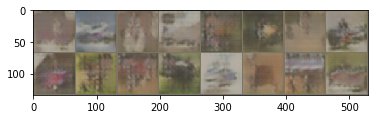

epoch: 47, time: 1818.829s, D loss: 0.184, G loss: 5.371
epoch: 47, time: 1820.770s, D loss: 0.141, G loss: 7.068
epoch: 47, time: 1822.698s, D loss: 0.118, G loss: 8.996
epoch: 47, time: 1824.655s, D loss: 0.511, G loss: 5.126
epoch: 47, time: 1826.628s, D loss: 0.195, G loss: 6.419


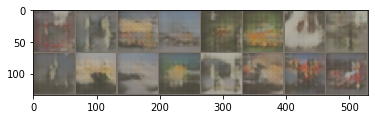

epoch: 47, time: 1828.727s, D loss: 0.006, G loss: 10.209
epoch: 47, time: 1830.677s, D loss: 0.206, G loss: 9.387
epoch: 47, time: 1832.645s, D loss: 0.051, G loss: 7.822
epoch: 47, time: 1834.620s, D loss: 0.207, G loss: 7.674
epoch: 47, time: 1836.549s, D loss: 0.018, G loss: 7.026


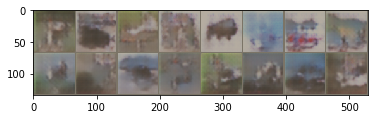

epoch: 47, time: 1838.633s, D loss: 0.029, G loss: 7.649
epoch: 47, time: 1840.555s, D loss: 0.022, G loss: 8.057
epoch: 47, time: 1842.481s, D loss: 0.022, G loss: 9.966
epoch: 47, time: 1844.423s, D loss: 0.077, G loss: 6.398
epoch: 47, time: 1846.358s, D loss: 0.023, G loss: 7.822


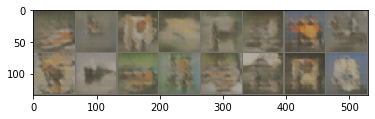

epoch: 47, time: 1848.430s, D loss: 0.039, G loss: 5.928
epoch: 47, time: 1850.366s, D loss: 0.014, G loss: 6.720
epoch: 47, time: 1852.303s, D loss: 0.164, G loss: 6.202
epoch: 47, time: 1854.232s, D loss: 0.055, G loss: 5.341
epoch: 48, time: 1855.298s, D loss: 0.118, G loss: 6.594


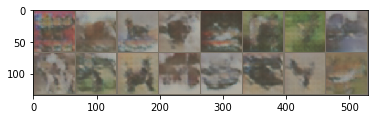

epoch: 48, time: 1857.395s, D loss: 0.062, G loss: 5.741
epoch: 48, time: 1859.335s, D loss: 0.048, G loss: 6.457
epoch: 48, time: 1861.261s, D loss: 0.073, G loss: 4.963
epoch: 48, time: 1863.207s, D loss: 0.015, G loss: 8.130
epoch: 48, time: 1865.172s, D loss: 0.020, G loss: 5.709


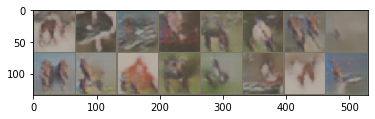

epoch: 48, time: 1867.251s, D loss: 0.017, G loss: 7.608
epoch: 48, time: 1869.179s, D loss: 0.017, G loss: 5.282
epoch: 48, time: 1871.103s, D loss: 0.030, G loss: 6.000
epoch: 48, time: 1873.052s, D loss: 0.022, G loss: 6.532
epoch: 48, time: 1875.002s, D loss: 0.038, G loss: 5.904


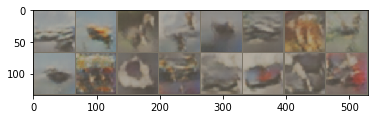

epoch: 48, time: 1877.094s, D loss: 0.060, G loss: 6.957
epoch: 48, time: 1879.032s, D loss: 0.089, G loss: 6.842
epoch: 48, time: 1880.962s, D loss: 0.027, G loss: 5.858
epoch: 48, time: 1882.890s, D loss: 0.118, G loss: 5.371
epoch: 48, time: 1884.825s, D loss: 0.020, G loss: 6.147


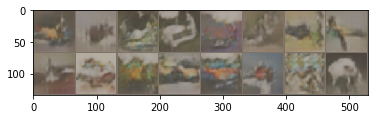

epoch: 48, time: 1887.006s, D loss: 0.024, G loss: 7.628
epoch: 48, time: 1888.936s, D loss: 0.014, G loss: 6.209
epoch: 48, time: 1890.883s, D loss: 0.019, G loss: 6.754
epoch: 48, time: 1892.840s, D loss: 0.015, G loss: 6.644
epoch: 49, time: 1893.918s, D loss: 0.009, G loss: 7.739


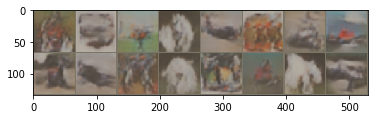

epoch: 49, time: 1895.999s, D loss: 0.043, G loss: 4.451
epoch: 49, time: 1897.931s, D loss: 0.091, G loss: 8.148
epoch: 49, time: 1899.873s, D loss: 0.004, G loss: 12.970
epoch: 49, time: 1901.801s, D loss: 0.053, G loss: 8.184
epoch: 49, time: 1905.046s, D loss: 0.066, G loss: 6.845


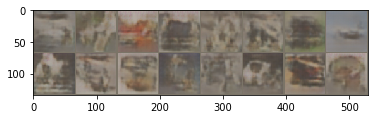

epoch: 49, time: 1907.143s, D loss: 0.202, G loss: 5.285
epoch: 49, time: 1909.090s, D loss: 0.374, G loss: 4.479
epoch: 49, time: 1911.253s, D loss: 0.010, G loss: 9.206
epoch: 49, time: 1913.196s, D loss: 0.117, G loss: 7.951
epoch: 49, time: 1915.164s, D loss: 0.120, G loss: 6.007


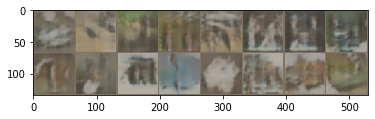

epoch: 49, time: 1917.261s, D loss: 0.082, G loss: 5.162
epoch: 49, time: 1919.187s, D loss: 0.202, G loss: 4.738
epoch: 49, time: 1921.115s, D loss: 0.021, G loss: 8.508
epoch: 49, time: 1923.067s, D loss: 0.086, G loss: 6.355
epoch: 49, time: 1925.032s, D loss: 0.065, G loss: 5.721


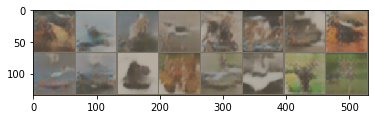

epoch: 49, time: 1927.127s, D loss: 0.005, G loss: 16.685
epoch: 49, time: 1929.053s, D loss: 0.018, G loss: 10.245
epoch: 49, time: 1930.985s, D loss: 0.044, G loss: 6.439
epoch: 49, time: 1932.902s, D loss: 0.003, G loss: 11.128
epoch: 50, time: 1933.969s, D loss: 0.071, G loss: 5.363


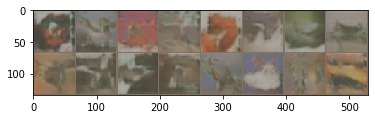

epoch: 50, time: 1936.076s, D loss: 0.075, G loss: 6.915
epoch: 50, time: 1937.979s, D loss: 0.005, G loss: 9.107
epoch: 50, time: 1939.890s, D loss: 0.027, G loss: 5.221
epoch: 50, time: 1941.787s, D loss: 0.027, G loss: 4.589
epoch: 50, time: 1943.732s, D loss: 0.332, G loss: 6.147


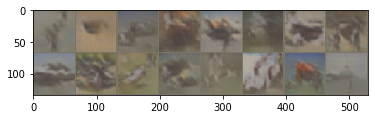

epoch: 50, time: 1945.858s, D loss: 0.017, G loss: 7.728
epoch: 50, time: 1947.814s, D loss: 0.056, G loss: 4.622
epoch: 50, time: 1949.741s, D loss: 0.078, G loss: 7.336
epoch: 50, time: 1951.704s, D loss: 0.040, G loss: 6.075
epoch: 50, time: 1953.649s, D loss: 0.094, G loss: 6.317


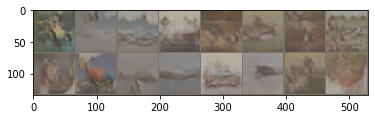

epoch: 50, time: 1955.739s, D loss: 0.009, G loss: 6.427
epoch: 50, time: 1957.663s, D loss: 0.012, G loss: 5.175
epoch: 50, time: 1959.592s, D loss: 0.027, G loss: 6.061
epoch: 50, time: 1961.529s, D loss: 0.010, G loss: 7.766
epoch: 50, time: 1963.457s, D loss: 0.017, G loss: 6.346


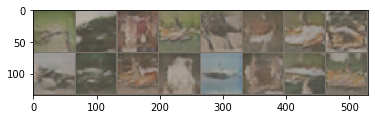

epoch: 50, time: 1965.550s, D loss: 0.012, G loss: 7.135
epoch: 50, time: 1967.474s, D loss: 0.012, G loss: 7.187
epoch: 50, time: 1969.402s, D loss: 0.045, G loss: 6.707
epoch: 50, time: 1971.345s, D loss: 0.025, G loss: 6.657
epoch: 51, time: 1972.417s, D loss: 0.010, G loss: 6.594


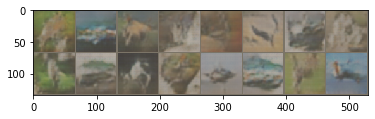

epoch: 51, time: 1974.515s, D loss: 0.017, G loss: 7.807
epoch: 51, time: 1976.472s, D loss: 0.083, G loss: 5.043
epoch: 51, time: 1978.422s, D loss: 0.035, G loss: 7.524
epoch: 51, time: 1980.367s, D loss: 0.017, G loss: 6.637
epoch: 51, time: 1982.334s, D loss: 0.018, G loss: 6.186


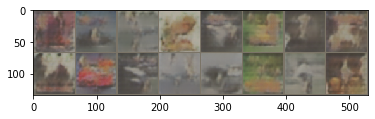

epoch: 51, time: 1984.479s, D loss: 0.125, G loss: 6.937
epoch: 51, time: 1986.433s, D loss: 0.022, G loss: 7.747
epoch: 51, time: 1988.365s, D loss: 0.064, G loss: 6.364
epoch: 51, time: 1990.309s, D loss: 0.005, G loss: 6.521
epoch: 51, time: 1992.258s, D loss: 0.061, G loss: 7.315


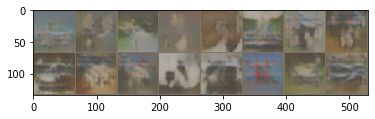

epoch: 51, time: 1994.381s, D loss: 0.065, G loss: 6.199
epoch: 51, time: 1996.314s, D loss: 0.079, G loss: 6.939
epoch: 51, time: 1998.258s, D loss: 0.001, G loss: 9.569
epoch: 51, time: 2000.197s, D loss: 0.060, G loss: 6.137
epoch: 51, time: 2002.108s, D loss: 0.007, G loss: 7.862


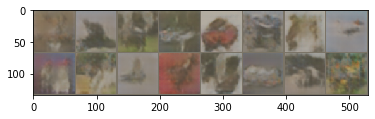

epoch: 51, time: 2004.215s, D loss: 0.008, G loss: 8.311
epoch: 51, time: 2006.171s, D loss: 0.012, G loss: 6.998
epoch: 51, time: 2008.103s, D loss: 0.017, G loss: 2.790
epoch: 51, time: 2010.038s, D loss: 0.119, G loss: 6.075
epoch: 52, time: 2011.108s, D loss: 0.230, G loss: 5.185


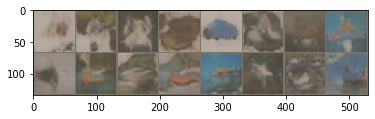

epoch: 52, time: 2013.220s, D loss: 0.062, G loss: 6.051
epoch: 52, time: 2015.174s, D loss: 0.006, G loss: 7.616
epoch: 52, time: 2017.090s, D loss: 0.005, G loss: 10.229
epoch: 52, time: 2019.007s, D loss: 0.197, G loss: 5.852
epoch: 52, time: 2020.928s, D loss: 0.037, G loss: 4.945


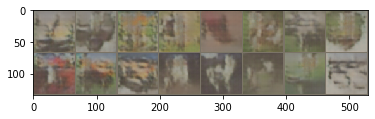

epoch: 52, time: 2023.016s, D loss: 0.076, G loss: 6.921
epoch: 52, time: 2024.962s, D loss: 0.050, G loss: 7.732
epoch: 52, time: 2026.897s, D loss: 0.025, G loss: 8.186
epoch: 52, time: 2028.816s, D loss: 0.086, G loss: 4.791
epoch: 52, time: 2030.739s, D loss: 0.006, G loss: 11.230


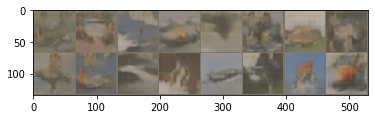

epoch: 52, time: 2032.846s, D loss: 0.022, G loss: 6.801
epoch: 52, time: 2034.790s, D loss: 0.035, G loss: 9.438
epoch: 52, time: 2036.733s, D loss: 0.059, G loss: 5.584
epoch: 52, time: 2038.661s, D loss: 0.063, G loss: 5.073
epoch: 52, time: 2040.594s, D loss: 0.048, G loss: 6.826


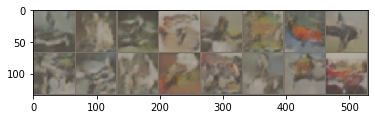

epoch: 52, time: 2042.704s, D loss: 0.023, G loss: 5.602
epoch: 52, time: 2044.656s, D loss: 0.066, G loss: 5.897
epoch: 52, time: 2046.602s, D loss: 0.057, G loss: 5.740
epoch: 52, time: 2048.533s, D loss: 0.024, G loss: 5.918
epoch: 53, time: 2049.593s, D loss: 0.104, G loss: 11.727


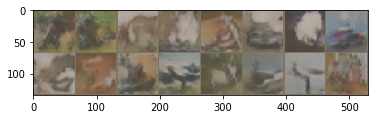

epoch: 53, time: 2051.747s, D loss: 0.003, G loss: 7.297
epoch: 53, time: 2053.675s, D loss: 0.043, G loss: 7.055
epoch: 53, time: 2055.635s, D loss: 0.020, G loss: 6.614
epoch: 53, time: 2057.569s, D loss: 0.025, G loss: 7.096
epoch: 53, time: 2059.506s, D loss: 0.013, G loss: 7.324


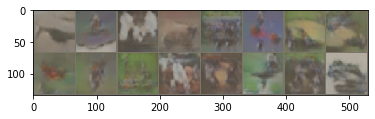

epoch: 53, time: 2061.596s, D loss: 0.038, G loss: 5.877
epoch: 53, time: 2063.520s, D loss: 0.010, G loss: 6.375
epoch: 53, time: 2065.462s, D loss: 0.008, G loss: 6.710
epoch: 53, time: 2067.392s, D loss: 0.035, G loss: 5.388
epoch: 53, time: 2069.319s, D loss: 0.121, G loss: 8.019


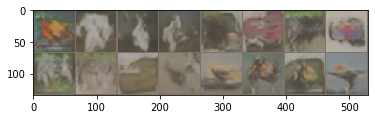

epoch: 53, time: 2071.454s, D loss: 0.033, G loss: 8.017
epoch: 53, time: 2073.404s, D loss: 0.017, G loss: 6.682
epoch: 53, time: 2075.366s, D loss: 0.020, G loss: 5.469
epoch: 53, time: 2077.298s, D loss: 0.025, G loss: 5.535
epoch: 53, time: 2079.231s, D loss: 0.021, G loss: 5.765


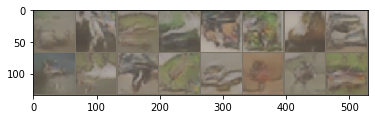

epoch: 53, time: 2081.320s, D loss: 0.037, G loss: 5.686
epoch: 53, time: 2083.255s, D loss: 0.008, G loss: 5.919
epoch: 53, time: 2085.217s, D loss: 0.028, G loss: 5.113
epoch: 53, time: 2087.148s, D loss: 0.011, G loss: 6.777
epoch: 54, time: 2088.210s, D loss: 0.492, G loss: 2.993


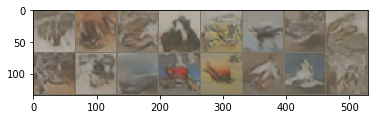

epoch: 54, time: 2090.298s, D loss: 0.691, G loss: 4.020
epoch: 54, time: 2092.230s, D loss: 0.347, G loss: 3.664
epoch: 54, time: 2094.163s, D loss: 0.180, G loss: 4.278
epoch: 54, time: 2096.117s, D loss: 0.129, G loss: 6.531
epoch: 54, time: 2098.041s, D loss: 0.189, G loss: 5.645


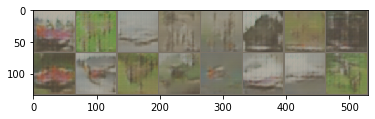

epoch: 54, time: 2100.131s, D loss: 0.052, G loss: 6.336
epoch: 54, time: 2102.076s, D loss: 0.110, G loss: 8.733
epoch: 54, time: 2104.015s, D loss: 0.038, G loss: 4.183
epoch: 54, time: 2105.939s, D loss: 0.105, G loss: 8.176
epoch: 54, time: 2107.877s, D loss: 0.036, G loss: 6.469


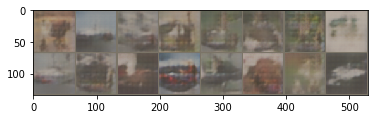

epoch: 54, time: 2109.972s, D loss: 0.090, G loss: 7.736
epoch: 54, time: 2111.892s, D loss: 0.064, G loss: 6.061
epoch: 54, time: 2113.834s, D loss: 0.058, G loss: 5.531
epoch: 54, time: 2115.818s, D loss: 0.121, G loss: 11.762
epoch: 54, time: 2117.771s, D loss: 0.128, G loss: 6.183


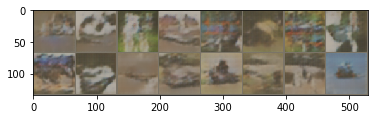

epoch: 54, time: 2119.874s, D loss: 0.174, G loss: 5.062
epoch: 54, time: 2121.825s, D loss: 0.050, G loss: 3.774
epoch: 54, time: 2123.787s, D loss: 0.046, G loss: 5.585
epoch: 54, time: 2125.736s, D loss: 0.096, G loss: 5.838
epoch: 55, time: 2126.799s, D loss: 0.083, G loss: 5.399


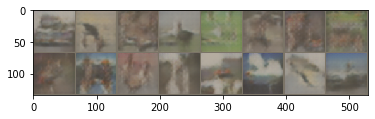

epoch: 55, time: 2128.892s, D loss: 0.034, G loss: 7.363
epoch: 55, time: 2130.834s, D loss: 0.040, G loss: 6.816
epoch: 55, time: 2132.802s, D loss: 0.198, G loss: 5.840
epoch: 55, time: 2134.765s, D loss: 0.023, G loss: 6.277
epoch: 55, time: 2136.704s, D loss: 0.112, G loss: 7.188


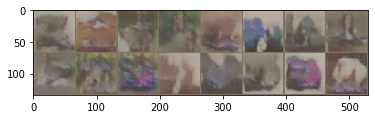

epoch: 55, time: 2138.797s, D loss: 0.050, G loss: 4.149
epoch: 55, time: 2140.718s, D loss: 0.045, G loss: 5.884
epoch: 55, time: 2142.645s, D loss: 0.031, G loss: 9.066
epoch: 55, time: 2144.592s, D loss: 0.023, G loss: 7.538
epoch: 55, time: 2146.534s, D loss: 0.017, G loss: 8.048


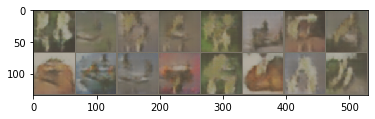

epoch: 55, time: 2148.630s, D loss: 0.081, G loss: 5.154
epoch: 55, time: 2150.563s, D loss: 0.029, G loss: 8.068
epoch: 55, time: 2152.504s, D loss: 0.010, G loss: 9.453
epoch: 55, time: 2154.450s, D loss: 0.033, G loss: 5.927
epoch: 55, time: 2156.415s, D loss: 0.094, G loss: 5.272


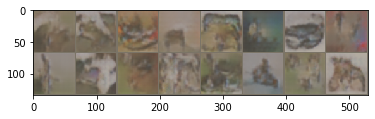

epoch: 55, time: 2158.518s, D loss: 0.052, G loss: 7.325
epoch: 55, time: 2160.450s, D loss: 0.032, G loss: 7.496
epoch: 55, time: 2162.416s, D loss: 0.030, G loss: 4.609
epoch: 55, time: 2164.360s, D loss: 0.018, G loss: 7.654
epoch: 56, time: 2165.433s, D loss: 0.017, G loss: 6.383


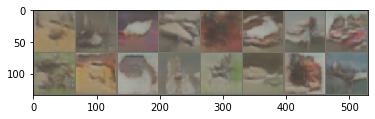

epoch: 56, time: 2167.512s, D loss: 0.076, G loss: 5.433
epoch: 56, time: 2169.438s, D loss: 0.053, G loss: 6.161
epoch: 56, time: 2171.369s, D loss: 0.004, G loss: 7.105
epoch: 56, time: 2173.298s, D loss: 0.066, G loss: 7.586
epoch: 56, time: 2175.235s, D loss: 0.168, G loss: 3.137


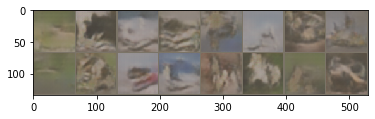

epoch: 56, time: 2177.325s, D loss: 0.067, G loss: 11.111
epoch: 56, time: 2179.248s, D loss: 0.130, G loss: 10.026
epoch: 56, time: 2181.170s, D loss: 0.040, G loss: 5.371
epoch: 56, time: 2183.092s, D loss: 0.076, G loss: 5.651
epoch: 56, time: 2185.036s, D loss: 0.020, G loss: 8.070


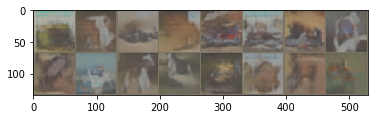

epoch: 56, time: 2187.116s, D loss: 0.017, G loss: 7.290
epoch: 56, time: 2189.040s, D loss: 0.058, G loss: 6.324
epoch: 56, time: 2190.970s, D loss: 0.012, G loss: 8.603
epoch: 56, time: 2192.881s, D loss: 0.025, G loss: 5.461
epoch: 56, time: 2194.806s, D loss: 0.016, G loss: 6.810


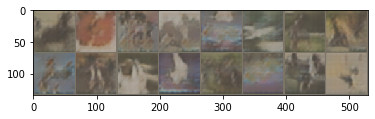

epoch: 56, time: 2196.873s, D loss: 0.056, G loss: 5.632
epoch: 56, time: 2198.809s, D loss: 0.018, G loss: 6.525
epoch: 56, time: 2200.731s, D loss: 0.018, G loss: 5.197
epoch: 56, time: 2202.665s, D loss: 0.042, G loss: 6.047
epoch: 57, time: 2203.736s, D loss: 0.117, G loss: 8.510


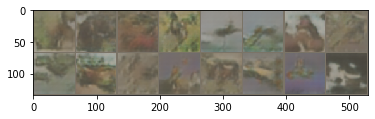

epoch: 57, time: 2205.856s, D loss: 0.008, G loss: 6.484
epoch: 57, time: 2207.780s, D loss: 0.023, G loss: 6.506
epoch: 57, time: 2209.701s, D loss: 0.011, G loss: 6.872
epoch: 57, time: 2211.643s, D loss: 0.025, G loss: 5.623
epoch: 57, time: 2213.572s, D loss: 0.006, G loss: 7.963


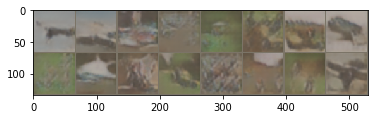

epoch: 57, time: 2215.738s, D loss: 0.041, G loss: 6.275
epoch: 57, time: 2217.672s, D loss: 0.168, G loss: 7.071
epoch: 57, time: 2219.598s, D loss: 0.014, G loss: 6.112
epoch: 57, time: 2221.556s, D loss: 0.012, G loss: 8.413
epoch: 57, time: 2223.491s, D loss: 0.032, G loss: 6.899


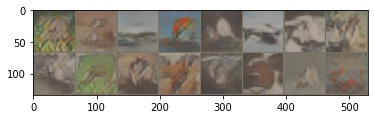

epoch: 57, time: 2225.577s, D loss: 0.020, G loss: 5.889
epoch: 57, time: 2227.507s, D loss: 0.015, G loss: 4.902
epoch: 57, time: 2229.443s, D loss: 0.009, G loss: 6.336
epoch: 57, time: 2231.394s, D loss: 0.008, G loss: 7.766
epoch: 57, time: 2233.345s, D loss: 0.040, G loss: 7.342


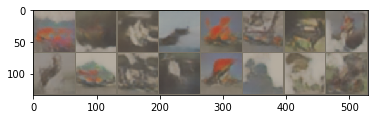

epoch: 57, time: 2235.469s, D loss: 0.106, G loss: 6.854
epoch: 57, time: 2237.402s, D loss: 0.207, G loss: 4.839
epoch: 57, time: 2239.331s, D loss: 0.007, G loss: 6.365
epoch: 57, time: 2241.260s, D loss: 0.013, G loss: 6.702
epoch: 58, time: 2242.318s, D loss: 0.022, G loss: 6.480


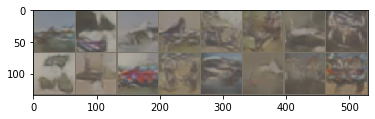

epoch: 58, time: 2244.408s, D loss: 0.010, G loss: 7.811
epoch: 58, time: 2246.345s, D loss: 0.047, G loss: 10.149
epoch: 58, time: 2248.279s, D loss: 0.011, G loss: 6.935
epoch: 58, time: 2250.202s, D loss: 0.016, G loss: 6.382
epoch: 58, time: 2252.157s, D loss: 0.123, G loss: 3.188


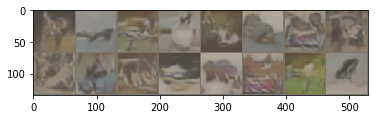

epoch: 58, time: 2254.245s, D loss: 0.013, G loss: 8.737
epoch: 58, time: 2256.179s, D loss: 0.009, G loss: 11.667
epoch: 58, time: 2258.104s, D loss: 0.057, G loss: 6.620
epoch: 58, time: 2260.028s, D loss: 0.536, G loss: 8.173
epoch: 58, time: 2261.960s, D loss: 0.020, G loss: 3.716


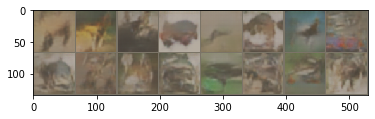

epoch: 58, time: 2264.047s, D loss: 2.218, G loss: 7.695
epoch: 58, time: 2265.992s, D loss: 0.432, G loss: 3.545
epoch: 58, time: 2267.924s, D loss: 0.053, G loss: 7.133
epoch: 58, time: 2269.842s, D loss: 0.139, G loss: 5.344
epoch: 58, time: 2271.765s, D loss: 0.086, G loss: 5.551


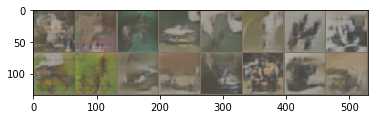

epoch: 58, time: 2273.861s, D loss: 0.093, G loss: 4.692
epoch: 58, time: 2275.811s, D loss: 0.102, G loss: 8.226
epoch: 58, time: 2277.758s, D loss: 0.003, G loss: 10.645
epoch: 58, time: 2279.693s, D loss: 0.631, G loss: 9.426
epoch: 59, time: 2280.751s, D loss: 0.030, G loss: 10.140


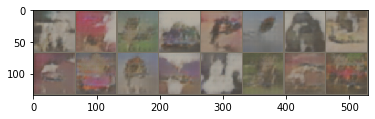

epoch: 59, time: 2282.846s, D loss: 0.409, G loss: 8.177
epoch: 59, time: 2284.822s, D loss: 0.079, G loss: 8.780
epoch: 59, time: 2286.760s, D loss: 0.037, G loss: 10.889
epoch: 59, time: 2288.705s, D loss: 0.012, G loss: 7.797
epoch: 59, time: 2290.638s, D loss: 0.021, G loss: 7.753


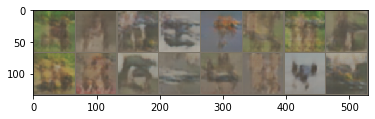

epoch: 59, time: 2292.718s, D loss: 0.017, G loss: 6.363
epoch: 59, time: 2294.674s, D loss: 0.014, G loss: 7.652
epoch: 59, time: 2296.614s, D loss: 0.010, G loss: 7.119
epoch: 59, time: 2298.539s, D loss: 0.027, G loss: 8.115
epoch: 59, time: 2300.473s, D loss: 0.017, G loss: 5.855


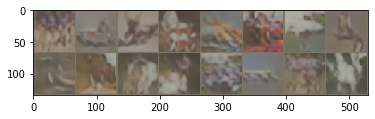

epoch: 59, time: 2302.568s, D loss: 0.010, G loss: 6.507
epoch: 59, time: 2304.504s, D loss: 0.013, G loss: 8.357
epoch: 59, time: 2306.432s, D loss: 0.012, G loss: 5.925
epoch: 59, time: 2308.396s, D loss: 0.011, G loss: 6.359
epoch: 59, time: 2310.332s, D loss: 0.007, G loss: 6.847


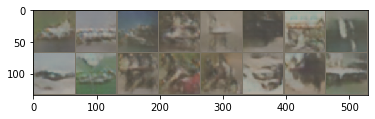

epoch: 59, time: 2312.445s, D loss: 0.014, G loss: 8.070
epoch: 59, time: 2314.399s, D loss: 0.020, G loss: 5.166
epoch: 59, time: 2316.340s, D loss: 0.009, G loss: 7.470
epoch: 59, time: 2318.250s, D loss: 0.039, G loss: 6.009
epoch: 60, time: 2319.292s, D loss: 0.066, G loss: 7.048


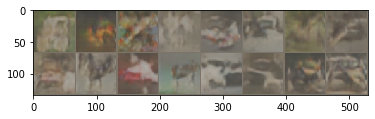

epoch: 60, time: 2321.353s, D loss: 0.023, G loss: 7.230
epoch: 60, time: 2323.246s, D loss: 0.007, G loss: 7.742
epoch: 60, time: 2325.181s, D loss: 0.007, G loss: 7.239
epoch: 60, time: 2327.108s, D loss: 0.015, G loss: 6.097
epoch: 60, time: 2329.045s, D loss: 0.008, G loss: 8.339


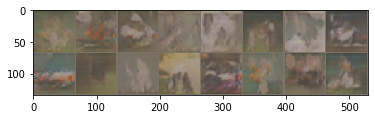

epoch: 60, time: 2331.128s, D loss: 0.013, G loss: 5.394
epoch: 60, time: 2333.071s, D loss: 0.013, G loss: 6.301
epoch: 60, time: 2335.017s, D loss: 0.097, G loss: 5.956
epoch: 60, time: 2336.962s, D loss: 0.001, G loss: 9.195
epoch: 60, time: 2338.895s, D loss: 0.010, G loss: 7.663


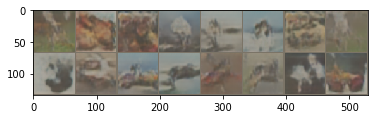

epoch: 60, time: 2340.978s, D loss: 0.006, G loss: 8.561
epoch: 60, time: 2342.925s, D loss: 0.009, G loss: 8.487
epoch: 60, time: 2344.865s, D loss: 0.004, G loss: 16.927
epoch: 60, time: 2346.786s, D loss: 0.018, G loss: 9.384
epoch: 60, time: 2348.717s, D loss: 0.104, G loss: 7.268


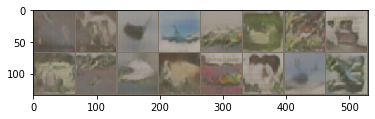

epoch: 60, time: 2350.799s, D loss: 0.049, G loss: 11.097
epoch: 60, time: 2352.729s, D loss: 0.156, G loss: 7.098
epoch: 60, time: 2354.672s, D loss: 0.017, G loss: 11.306
epoch: 60, time: 2356.613s, D loss: 0.062, G loss: 9.544
epoch: 61, time: 2357.669s, D loss: 0.032, G loss: 7.502


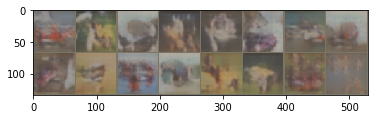

epoch: 61, time: 2359.766s, D loss: 0.008, G loss: 9.286
epoch: 61, time: 2361.697s, D loss: 0.010, G loss: 8.593
epoch: 61, time: 2363.628s, D loss: 0.024, G loss: 7.950
epoch: 61, time: 2365.571s, D loss: 1.135, G loss: 14.808
epoch: 61, time: 2367.485s, D loss: 0.004, G loss: 10.468


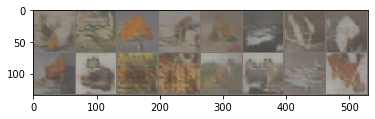

epoch: 61, time: 2369.560s, D loss: 0.009, G loss: 9.731
epoch: 61, time: 2371.504s, D loss: 0.044, G loss: 6.769
epoch: 61, time: 2373.427s, D loss: 0.162, G loss: 4.286
epoch: 61, time: 2375.368s, D loss: 0.009, G loss: 7.718
epoch: 61, time: 2377.293s, D loss: 0.024, G loss: 11.747


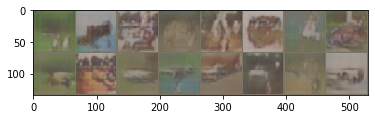

epoch: 61, time: 2379.447s, D loss: 0.024, G loss: 18.509
epoch: 61, time: 2381.372s, D loss: 0.019, G loss: 12.415
epoch: 61, time: 2383.309s, D loss: 0.018, G loss: 9.405
epoch: 61, time: 2385.265s, D loss: 0.013, G loss: 9.557
epoch: 61, time: 2387.187s, D loss: 0.204, G loss: 6.156


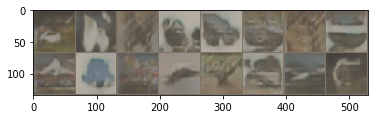

epoch: 61, time: 2389.298s, D loss: 0.013, G loss: 7.056
epoch: 61, time: 2391.248s, D loss: 0.231, G loss: 6.967
epoch: 61, time: 2393.186s, D loss: 0.015, G loss: 7.832
epoch: 61, time: 2395.159s, D loss: 0.028, G loss: 7.049
epoch: 62, time: 2396.226s, D loss: 0.027, G loss: 5.772


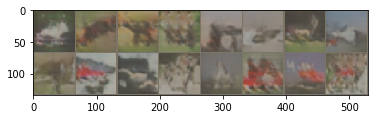

epoch: 62, time: 2398.340s, D loss: 0.023, G loss: 5.503
epoch: 62, time: 2400.246s, D loss: 0.157, G loss: 4.629
epoch: 62, time: 2402.185s, D loss: 0.068, G loss: 4.959
epoch: 62, time: 2404.112s, D loss: 0.004, G loss: 9.270
epoch: 62, time: 2406.048s, D loss: 0.019, G loss: 6.828


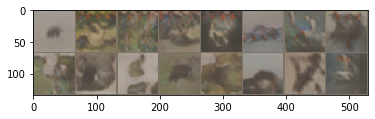

epoch: 62, time: 2408.133s, D loss: 0.050, G loss: 9.978
epoch: 62, time: 2410.064s, D loss: 0.016, G loss: 8.920
epoch: 62, time: 2411.988s, D loss: 0.032, G loss: 7.286
epoch: 62, time: 2413.921s, D loss: 0.025, G loss: 6.006
epoch: 62, time: 2415.860s, D loss: 0.009, G loss: 9.135


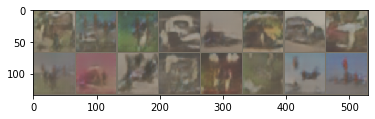

epoch: 62, time: 2417.938s, D loss: 0.016, G loss: 7.685
epoch: 62, time: 2419.879s, D loss: 0.011, G loss: 7.677
epoch: 62, time: 2421.809s, D loss: 0.017, G loss: 6.990
epoch: 62, time: 2423.767s, D loss: 0.091, G loss: 8.068
epoch: 62, time: 2425.796s, D loss: 0.009, G loss: 7.013


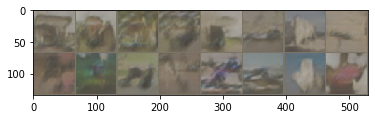

epoch: 62, time: 2427.907s, D loss: 0.014, G loss: 7.513
epoch: 62, time: 2429.844s, D loss: 0.013, G loss: 9.069
epoch: 62, time: 2431.831s, D loss: 0.005, G loss: 7.513
epoch: 62, time: 2433.797s, D loss: 0.008, G loss: 7.480
epoch: 63, time: 2434.891s, D loss: 0.015, G loss: 5.388


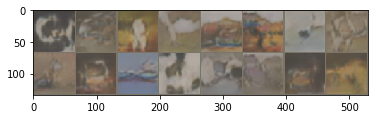

epoch: 63, time: 2436.979s, D loss: 0.013, G loss: 6.702
epoch: 63, time: 2438.904s, D loss: 0.017, G loss: 5.977
epoch: 63, time: 2440.840s, D loss: 0.034, G loss: 4.498
epoch: 63, time: 2442.771s, D loss: 0.012, G loss: 4.687
epoch: 63, time: 2444.707s, D loss: 1.519, G loss: 3.979


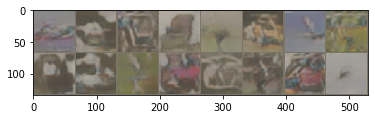

epoch: 63, time: 2446.794s, D loss: 0.048, G loss: 14.036
epoch: 63, time: 2448.707s, D loss: 0.100, G loss: 8.713
epoch: 63, time: 2450.590s, D loss: 0.274, G loss: 4.449
epoch: 63, time: 2452.506s, D loss: 0.075, G loss: 8.277
epoch: 63, time: 2454.414s, D loss: 0.167, G loss: 6.508


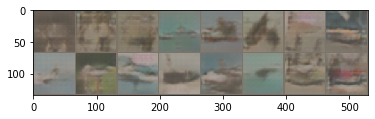

epoch: 63, time: 2456.506s, D loss: 0.036, G loss: 8.757
epoch: 63, time: 2458.453s, D loss: 0.082, G loss: 7.198
epoch: 63, time: 2460.397s, D loss: 0.108, G loss: 6.112
epoch: 63, time: 2462.351s, D loss: 0.071, G loss: 7.570
epoch: 63, time: 2464.300s, D loss: 0.010, G loss: 9.355


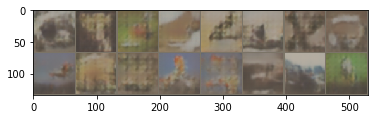

epoch: 63, time: 2466.372s, D loss: 0.108, G loss: 8.505
epoch: 63, time: 2468.310s, D loss: 0.042, G loss: 7.428
epoch: 63, time: 2470.250s, D loss: 0.069, G loss: 7.527
epoch: 63, time: 2472.183s, D loss: 0.006, G loss: 7.574
epoch: 64, time: 2473.246s, D loss: 0.084, G loss: 4.301


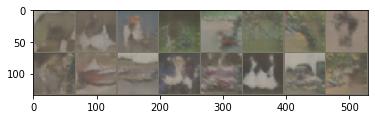

epoch: 64, time: 2475.363s, D loss: 0.004, G loss: 7.688
epoch: 64, time: 2477.297s, D loss: 0.047, G loss: 6.033
epoch: 64, time: 2479.232s, D loss: 0.011, G loss: 6.692
epoch: 64, time: 2481.160s, D loss: 0.059, G loss: 6.011
epoch: 64, time: 2483.095s, D loss: 0.068, G loss: 4.543


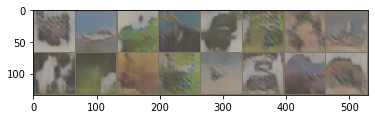

epoch: 64, time: 2485.192s, D loss: 0.022, G loss: 6.907
epoch: 64, time: 2487.129s, D loss: 0.018, G loss: 7.888
epoch: 64, time: 2489.058s, D loss: 0.014, G loss: 7.116
epoch: 64, time: 2490.987s, D loss: 0.043, G loss: 5.698
epoch: 64, time: 2492.930s, D loss: 0.028, G loss: 7.280


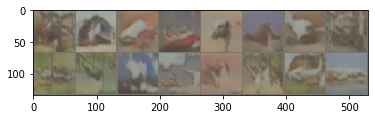

epoch: 64, time: 2495.027s, D loss: 0.053, G loss: 7.711
epoch: 64, time: 2496.949s, D loss: 0.009, G loss: 7.666
epoch: 64, time: 2498.881s, D loss: 0.008, G loss: 11.342
epoch: 64, time: 2500.795s, D loss: 0.011, G loss: 11.386
epoch: 64, time: 2502.714s, D loss: 0.012, G loss: 4.043


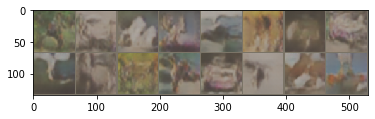

epoch: 64, time: 2504.812s, D loss: 0.026, G loss: 6.182
epoch: 64, time: 2506.734s, D loss: 0.014, G loss: 6.004
epoch: 64, time: 2508.663s, D loss: 0.010, G loss: 6.825
epoch: 64, time: 2510.592s, D loss: 0.007, G loss: 6.753
epoch: 65, time: 2511.665s, D loss: 0.008, G loss: 6.899


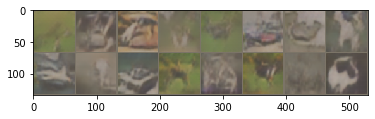

epoch: 65, time: 2513.763s, D loss: 0.024, G loss: 6.373
epoch: 65, time: 2515.721s, D loss: 0.014, G loss: 8.516
epoch: 65, time: 2517.650s, D loss: 0.025, G loss: 6.924
epoch: 65, time: 2519.578s, D loss: 0.022, G loss: 9.881
epoch: 65, time: 2521.520s, D loss: 0.093, G loss: 4.704


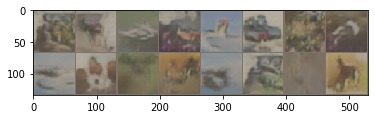

epoch: 65, time: 2523.601s, D loss: 0.015, G loss: 6.823
epoch: 65, time: 2525.533s, D loss: 0.008, G loss: 7.604
epoch: 65, time: 2527.459s, D loss: 0.068, G loss: 9.263
epoch: 65, time: 2529.385s, D loss: 0.025, G loss: 5.905
epoch: 65, time: 2531.308s, D loss: 0.078, G loss: 6.666


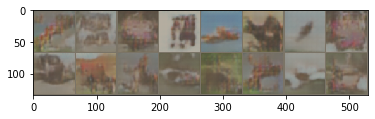

epoch: 65, time: 2533.397s, D loss: 0.024, G loss: 7.680
epoch: 65, time: 2535.341s, D loss: 0.035, G loss: 6.195
epoch: 65, time: 2537.254s, D loss: 0.006, G loss: 8.629
epoch: 65, time: 2539.183s, D loss: 0.006, G loss: 8.857
epoch: 65, time: 2541.106s, D loss: 0.021, G loss: 7.353


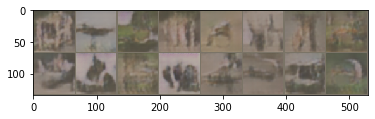

epoch: 65, time: 2543.246s, D loss: 0.014, G loss: 8.931
epoch: 65, time: 2545.190s, D loss: 0.005, G loss: 10.728
epoch: 65, time: 2547.119s, D loss: 0.002, G loss: 10.151
epoch: 65, time: 2549.058s, D loss: 0.004, G loss: 9.134
epoch: 66, time: 2550.136s, D loss: 0.007, G loss: 8.004


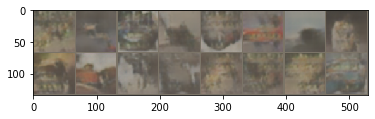

epoch: 66, time: 2552.262s, D loss: 0.103, G loss: 5.683
epoch: 66, time: 2554.201s, D loss: 0.001, G loss: 13.460
epoch: 66, time: 2556.145s, D loss: 0.163, G loss: 8.680
epoch: 66, time: 2558.087s, D loss: 0.007, G loss: 7.968
epoch: 66, time: 2560.018s, D loss: 0.053, G loss: 13.577


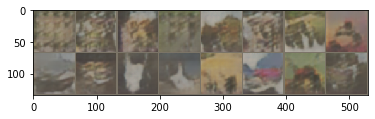

epoch: 66, time: 2562.086s, D loss: 0.004, G loss: 7.654
epoch: 66, time: 2564.011s, D loss: 0.013, G loss: 7.304
epoch: 66, time: 2565.946s, D loss: 0.015, G loss: 9.686
epoch: 66, time: 2567.870s, D loss: 0.011, G loss: 7.358
epoch: 66, time: 2569.787s, D loss: 0.008, G loss: 7.251


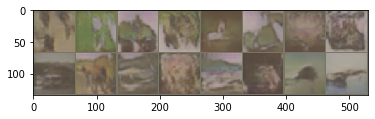

epoch: 66, time: 2571.889s, D loss: 0.005, G loss: 9.327
epoch: 66, time: 2573.808s, D loss: 0.014, G loss: 5.614
epoch: 66, time: 2575.726s, D loss: 0.006, G loss: 7.158
epoch: 66, time: 2577.629s, D loss: 0.010, G loss: 8.437
epoch: 66, time: 2579.517s, D loss: 0.008, G loss: 6.374


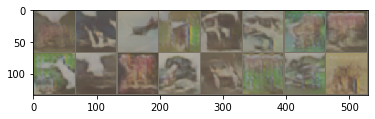

epoch: 66, time: 2581.614s, D loss: 0.056, G loss: 8.699
epoch: 66, time: 2583.539s, D loss: 0.056, G loss: 5.222
epoch: 66, time: 2585.484s, D loss: 0.010, G loss: 7.494
epoch: 66, time: 2587.398s, D loss: 0.025, G loss: 5.793
epoch: 67, time: 2588.461s, D loss: 0.107, G loss: 4.089


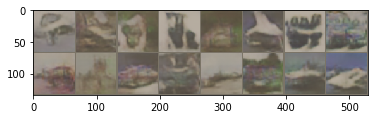

epoch: 67, time: 2590.556s, D loss: 0.004, G loss: 9.861
epoch: 67, time: 2592.493s, D loss: 0.009, G loss: 8.503
epoch: 67, time: 2594.453s, D loss: 0.009, G loss: 8.497
epoch: 67, time: 2596.393s, D loss: 0.005, G loss: 9.995
epoch: 67, time: 2598.321s, D loss: 0.006, G loss: 6.721


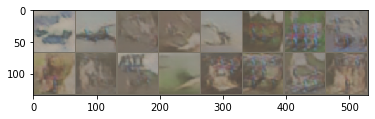

epoch: 67, time: 2600.408s, D loss: 0.005, G loss: 7.795
epoch: 67, time: 2602.337s, D loss: 0.002, G loss: 9.764
epoch: 67, time: 2604.270s, D loss: 0.010, G loss: 10.521
epoch: 67, time: 2606.222s, D loss: 0.001, G loss: 8.262
epoch: 67, time: 2608.146s, D loss: 0.016, G loss: 6.428


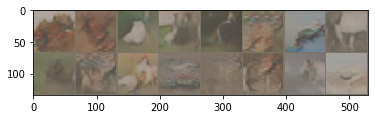

epoch: 67, time: 2610.224s, D loss: 0.009, G loss: 6.751
epoch: 67, time: 2612.179s, D loss: 0.007, G loss: 8.031
epoch: 67, time: 2614.107s, D loss: 0.004, G loss: 7.219
epoch: 67, time: 2616.043s, D loss: 0.006, G loss: 11.203
epoch: 67, time: 2617.970s, D loss: 0.007, G loss: 7.555


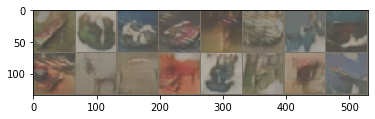

epoch: 67, time: 2620.051s, D loss: 0.002, G loss: 8.044
epoch: 67, time: 2621.977s, D loss: 0.010, G loss: 6.510
epoch: 67, time: 2623.908s, D loss: 0.060, G loss: 8.881
epoch: 67, time: 2625.840s, D loss: 0.001, G loss: 9.882
epoch: 68, time: 2626.897s, D loss: 0.002, G loss: 9.888


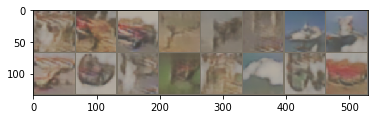

epoch: 68, time: 2628.991s, D loss: 0.001, G loss: 9.822
epoch: 68, time: 2630.926s, D loss: 0.066, G loss: 6.979
epoch: 68, time: 2632.876s, D loss: 0.002, G loss: 9.700
epoch: 68, time: 2634.818s, D loss: 0.004, G loss: 8.520
epoch: 68, time: 2636.773s, D loss: 0.011, G loss: 6.450


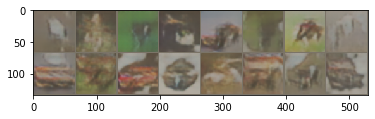

epoch: 68, time: 2638.889s, D loss: 0.027, G loss: 4.711
epoch: 68, time: 2640.823s, D loss: 0.002, G loss: 7.880
epoch: 68, time: 2642.767s, D loss: 0.002, G loss: 7.178
epoch: 68, time: 2644.718s, D loss: 0.003, G loss: 8.164
epoch: 68, time: 2646.631s, D loss: 0.002, G loss: 9.236


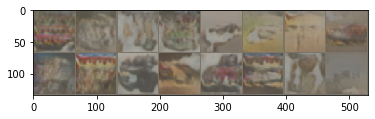

epoch: 68, time: 2648.725s, D loss: 0.002, G loss: 8.119
epoch: 68, time: 2650.653s, D loss: 0.099, G loss: 7.551
epoch: 68, time: 2652.577s, D loss: 0.066, G loss: 13.538
epoch: 68, time: 2654.519s, D loss: 0.003, G loss: 9.594
epoch: 68, time: 2656.439s, D loss: 0.008, G loss: 7.254


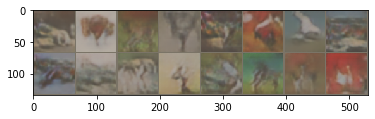

epoch: 68, time: 2658.531s, D loss: 0.007, G loss: 7.233
epoch: 68, time: 2660.457s, D loss: 0.011, G loss: 8.477
epoch: 68, time: 2662.389s, D loss: 0.003, G loss: 7.750
epoch: 68, time: 2664.311s, D loss: 0.009, G loss: 8.215
epoch: 69, time: 2665.381s, D loss: 0.006, G loss: 6.822


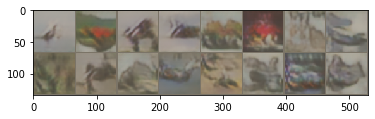

epoch: 69, time: 2667.451s, D loss: 0.006, G loss: 7.082
epoch: 69, time: 2669.391s, D loss: 0.033, G loss: 6.278
epoch: 69, time: 2671.322s, D loss: 0.009, G loss: 5.801
epoch: 69, time: 2673.279s, D loss: 0.011, G loss: 4.680
epoch: 69, time: 2675.222s, D loss: 0.756, G loss: 21.974


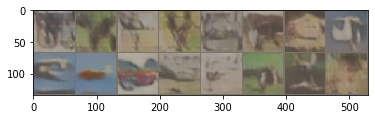

epoch: 69, time: 2677.296s, D loss: 0.131, G loss: 5.366
epoch: 69, time: 2679.215s, D loss: 0.016, G loss: 12.180
epoch: 69, time: 2681.137s, D loss: 1.152, G loss: 4.167
epoch: 69, time: 2683.054s, D loss: 0.009, G loss: 13.500
epoch: 69, time: 2684.996s, D loss: 0.044, G loss: 8.881


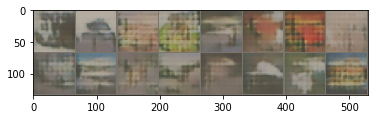

epoch: 69, time: 2687.085s, D loss: 0.273, G loss: 9.890
epoch: 69, time: 2689.015s, D loss: 0.237, G loss: 6.781
epoch: 69, time: 2690.939s, D loss: 0.258, G loss: 8.305
epoch: 69, time: 2692.859s, D loss: 0.017, G loss: 10.572
epoch: 69, time: 2694.801s, D loss: 0.268, G loss: 6.024


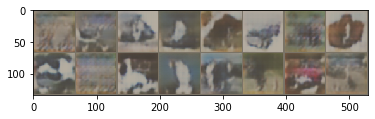

epoch: 69, time: 2696.908s, D loss: 0.103, G loss: 9.066
epoch: 69, time: 2698.833s, D loss: 0.007, G loss: 11.124
epoch: 69, time: 2700.759s, D loss: 0.079, G loss: 5.326
epoch: 69, time: 2702.699s, D loss: 0.275, G loss: 6.618
epoch: 70, time: 2703.763s, D loss: 0.046, G loss: 6.350


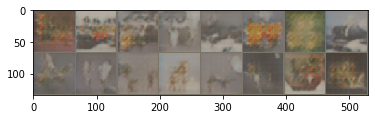

epoch: 70, time: 2705.903s, D loss: 0.248, G loss: 4.935
epoch: 70, time: 2707.785s, D loss: 0.115, G loss: 7.146
epoch: 70, time: 2709.718s, D loss: 0.038, G loss: 9.279
epoch: 70, time: 2711.648s, D loss: 0.054, G loss: 9.094
epoch: 70, time: 2713.584s, D loss: 0.136, G loss: 6.617


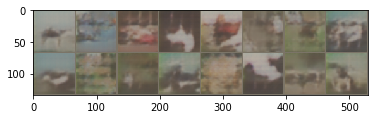

epoch: 70, time: 2715.689s, D loss: 0.241, G loss: 6.409
epoch: 70, time: 2717.623s, D loss: 0.284, G loss: 8.254
epoch: 70, time: 2719.559s, D loss: 0.047, G loss: 6.550
epoch: 70, time: 2721.493s, D loss: 0.226, G loss: 4.230
epoch: 70, time: 2723.437s, D loss: 0.747, G loss: 6.689


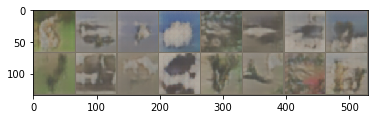

epoch: 70, time: 2725.533s, D loss: 0.001, G loss: 14.460
epoch: 70, time: 2727.448s, D loss: 0.141, G loss: 4.945
epoch: 70, time: 2729.377s, D loss: 0.002, G loss: 14.365
epoch: 70, time: 2731.293s, D loss: 0.220, G loss: 5.306
epoch: 70, time: 2733.219s, D loss: 0.211, G loss: 3.225


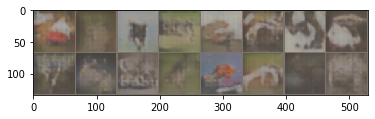

epoch: 70, time: 2735.359s, D loss: 0.187, G loss: 6.834
epoch: 70, time: 2737.308s, D loss: 0.120, G loss: 5.007
epoch: 70, time: 2739.263s, D loss: 0.107, G loss: 7.255
epoch: 70, time: 2741.214s, D loss: 0.040, G loss: 6.335
epoch: 71, time: 2742.280s, D loss: 0.096, G loss: 4.468


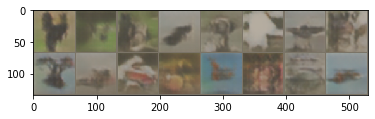

epoch: 71, time: 2744.381s, D loss: 0.009, G loss: 11.438
epoch: 71, time: 2746.322s, D loss: 0.152, G loss: 5.648
epoch: 71, time: 2748.232s, D loss: 0.042, G loss: 7.674
epoch: 71, time: 2750.155s, D loss: 0.023, G loss: 6.505
epoch: 71, time: 2752.083s, D loss: 0.067, G loss: 5.403


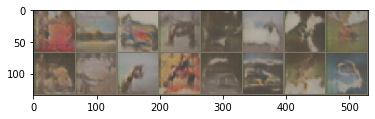

epoch: 71, time: 2754.169s, D loss: 0.024, G loss: 9.619
epoch: 71, time: 2756.118s, D loss: 0.144, G loss: 4.603
epoch: 71, time: 2758.049s, D loss: 0.000, G loss: 22.126
epoch: 71, time: 2759.980s, D loss: 0.001, G loss: 11.572
epoch: 71, time: 2761.913s, D loss: 0.210, G loss: 18.854


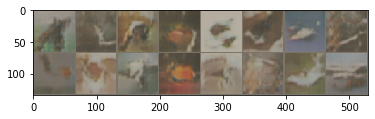

epoch: 71, time: 2764.008s, D loss: 0.119, G loss: 4.773
epoch: 71, time: 2765.949s, D loss: 0.008, G loss: 10.224
epoch: 71, time: 2767.873s, D loss: 0.300, G loss: 5.731
epoch: 71, time: 2769.798s, D loss: 0.043, G loss: 8.178
epoch: 71, time: 2771.716s, D loss: 0.076, G loss: 6.837


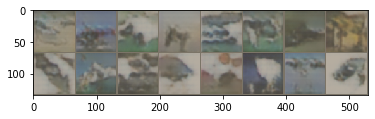

epoch: 71, time: 2773.795s, D loss: 0.208, G loss: 14.877
epoch: 71, time: 2775.734s, D loss: 0.120, G loss: 4.880
epoch: 71, time: 2777.650s, D loss: 0.395, G loss: 8.852
epoch: 71, time: 2779.587s, D loss: 0.013, G loss: 7.054
epoch: 72, time: 2780.654s, D loss: 0.076, G loss: 5.900


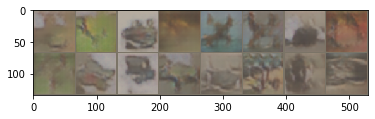

epoch: 72, time: 2782.735s, D loss: 0.066, G loss: 3.597
epoch: 72, time: 2784.678s, D loss: 0.032, G loss: 6.039
epoch: 72, time: 2786.619s, D loss: 0.020, G loss: 5.748
epoch: 72, time: 2788.539s, D loss: 0.011, G loss: 7.917
epoch: 72, time: 2790.471s, D loss: 0.046, G loss: 5.768


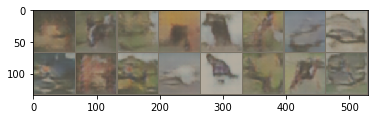

epoch: 72, time: 2792.578s, D loss: 0.010, G loss: 6.132
epoch: 72, time: 2794.540s, D loss: 0.094, G loss: 6.252
epoch: 72, time: 2796.482s, D loss: 0.006, G loss: 9.010
epoch: 72, time: 2798.420s, D loss: 0.103, G loss: 3.531
epoch: 72, time: 2800.357s, D loss: 0.077, G loss: 4.827


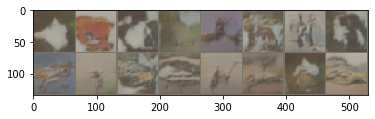

epoch: 72, time: 2802.420s, D loss: 0.015, G loss: 8.805
epoch: 72, time: 2804.345s, D loss: 0.061, G loss: 7.867
epoch: 72, time: 2806.284s, D loss: 0.045, G loss: 7.123
epoch: 72, time: 2808.224s, D loss: 0.090, G loss: 5.739
epoch: 72, time: 2810.147s, D loss: 0.033, G loss: 6.058


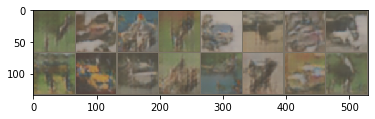

epoch: 72, time: 2812.238s, D loss: 0.032, G loss: 6.343
epoch: 72, time: 2814.162s, D loss: 0.019, G loss: 6.012
epoch: 72, time: 2816.118s, D loss: 0.039, G loss: 7.822
epoch: 72, time: 2818.053s, D loss: 0.020, G loss: 5.667
epoch: 73, time: 2819.114s, D loss: 0.007, G loss: 6.821


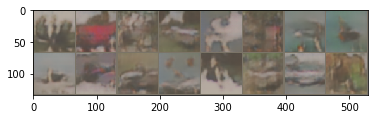

epoch: 73, time: 2821.225s, D loss: 0.013, G loss: 7.977
epoch: 73, time: 2823.154s, D loss: 0.009, G loss: 7.279
epoch: 73, time: 2825.091s, D loss: 0.205, G loss: 5.931
epoch: 73, time: 2827.003s, D loss: 0.003, G loss: 8.684
epoch: 73, time: 2828.929s, D loss: 0.026, G loss: 6.928


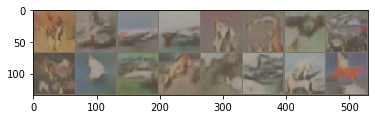

epoch: 73, time: 2830.980s, D loss: 0.019, G loss: 7.086
epoch: 73, time: 2832.879s, D loss: 0.025, G loss: 5.718
epoch: 73, time: 2834.796s, D loss: 0.015, G loss: 6.792
epoch: 73, time: 2836.717s, D loss: 0.023, G loss: 6.939
epoch: 73, time: 2838.648s, D loss: 0.016, G loss: 5.947


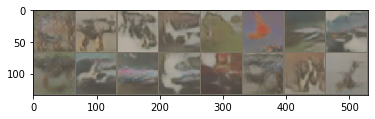

epoch: 73, time: 2840.721s, D loss: 0.057, G loss: 5.606
epoch: 73, time: 2842.638s, D loss: 0.010, G loss: 6.901
epoch: 73, time: 2844.586s, D loss: 0.012, G loss: 7.232
epoch: 73, time: 2846.516s, D loss: 0.027, G loss: 3.599
epoch: 73, time: 2848.438s, D loss: 0.016, G loss: 10.274


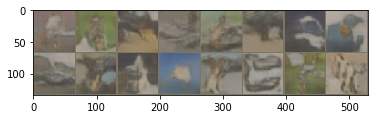

epoch: 73, time: 2850.528s, D loss: 0.051, G loss: 7.093
epoch: 73, time: 2852.468s, D loss: 0.065, G loss: 7.045
epoch: 73, time: 2854.424s, D loss: 0.008, G loss: 7.283
epoch: 73, time: 2856.361s, D loss: 0.029, G loss: 6.598
epoch: 74, time: 2857.421s, D loss: 0.032, G loss: 5.989


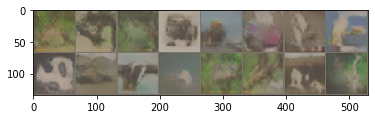

epoch: 74, time: 2859.509s, D loss: 0.026, G loss: 7.379
epoch: 74, time: 2861.444s, D loss: 0.015, G loss: 7.628
epoch: 74, time: 2863.360s, D loss: 0.009, G loss: 6.142
epoch: 74, time: 2865.288s, D loss: 0.016, G loss: 6.183
epoch: 74, time: 2867.220s, D loss: 0.022, G loss: 6.983


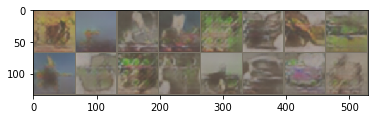

epoch: 74, time: 2869.368s, D loss: 0.034, G loss: 5.863
epoch: 74, time: 2871.328s, D loss: 0.033, G loss: 8.402
epoch: 74, time: 2873.265s, D loss: 0.004, G loss: 6.580
epoch: 74, time: 2875.213s, D loss: 0.018, G loss: 5.957
epoch: 74, time: 2877.156s, D loss: 0.023, G loss: 6.850


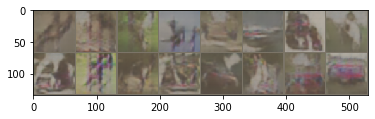

epoch: 74, time: 2879.246s, D loss: 0.023, G loss: 5.398
epoch: 74, time: 2881.180s, D loss: 0.003, G loss: 8.580
epoch: 74, time: 2883.131s, D loss: 0.004, G loss: 6.685
epoch: 74, time: 2885.094s, D loss: 0.009, G loss: 6.727
epoch: 74, time: 2887.015s, D loss: 0.012, G loss: 6.104


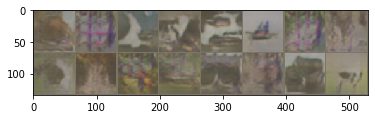

epoch: 74, time: 2889.085s, D loss: 0.010, G loss: 7.310
epoch: 74, time: 2891.017s, D loss: 0.007, G loss: 6.895
epoch: 74, time: 2892.953s, D loss: 0.007, G loss: 6.685
epoch: 74, time: 2894.896s, D loss: 0.003, G loss: 7.960
epoch: 75, time: 2895.976s, D loss: 0.006, G loss: 7.142


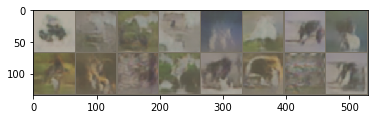

epoch: 75, time: 2898.074s, D loss: 0.017, G loss: 6.674
epoch: 75, time: 2900.029s, D loss: 0.022, G loss: 10.627
epoch: 75, time: 2901.950s, D loss: 0.003, G loss: 8.540
epoch: 75, time: 2903.874s, D loss: 0.001, G loss: 8.516
epoch: 75, time: 2905.836s, D loss: 0.003, G loss: 7.741


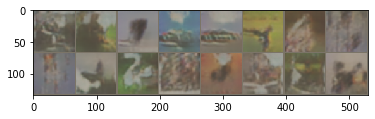

epoch: 75, time: 2907.911s, D loss: 0.003, G loss: 8.214
epoch: 75, time: 2909.833s, D loss: 0.035, G loss: 9.444
epoch: 75, time: 2911.774s, D loss: 0.012, G loss: 8.398
epoch: 75, time: 2913.703s, D loss: 0.011, G loss: 6.349
epoch: 75, time: 2915.641s, D loss: 0.006, G loss: 7.062


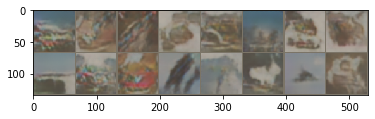

epoch: 75, time: 2917.725s, D loss: 0.065, G loss: 8.692
epoch: 75, time: 2919.647s, D loss: 0.003, G loss: 10.321
epoch: 75, time: 2921.568s, D loss: 0.002, G loss: 9.968
epoch: 75, time: 2923.496s, D loss: 0.002, G loss: 10.469
epoch: 75, time: 2925.441s, D loss: 0.011, G loss: 8.594


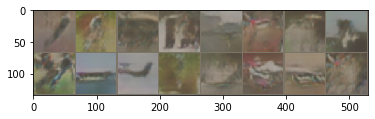

epoch: 75, time: 2927.523s, D loss: 0.005, G loss: 7.334
epoch: 75, time: 2929.440s, D loss: 0.009, G loss: 6.916
epoch: 75, time: 2931.370s, D loss: 0.013, G loss: 6.807
epoch: 75, time: 2933.290s, D loss: 0.008, G loss: 9.329
epoch: 76, time: 2934.369s, D loss: 0.017, G loss: 8.749


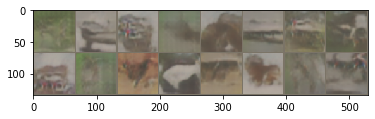

epoch: 76, time: 2936.461s, D loss: 0.029, G loss: 5.012
epoch: 76, time: 2938.386s, D loss: 0.003, G loss: 6.788
epoch: 76, time: 2940.313s, D loss: 0.004, G loss: 10.550
epoch: 76, time: 2942.249s, D loss: 0.006, G loss: 6.337
epoch: 76, time: 2944.181s, D loss: 0.003, G loss: 7.224


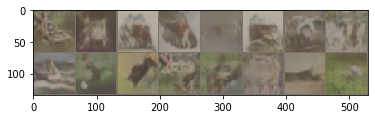

epoch: 76, time: 2946.286s, D loss: 0.003, G loss: 7.978
epoch: 76, time: 2948.200s, D loss: 0.006, G loss: 6.894
epoch: 76, time: 2950.135s, D loss: 0.006, G loss: 7.119
epoch: 76, time: 2952.071s, D loss: 0.005, G loss: 7.696
epoch: 76, time: 2954.011s, D loss: 0.005, G loss: 6.449


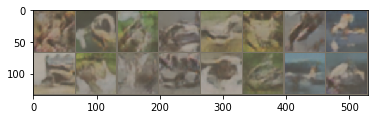

epoch: 76, time: 2956.124s, D loss: 0.006, G loss: 6.829
epoch: 76, time: 2958.013s, D loss: 0.009, G loss: 8.412
epoch: 76, time: 2959.920s, D loss: 0.005, G loss: 6.762
epoch: 76, time: 2961.809s, D loss: 0.028, G loss: 6.009
epoch: 76, time: 2963.742s, D loss: 0.019, G loss: 10.279


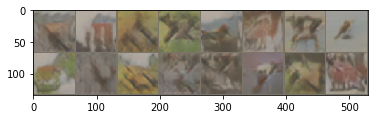

epoch: 76, time: 2965.832s, D loss: 0.223, G loss: 4.565
epoch: 76, time: 2967.754s, D loss: 0.122, G loss: 6.168
epoch: 76, time: 2969.677s, D loss: 0.024, G loss: 9.037
epoch: 76, time: 2971.613s, D loss: 0.310, G loss: 5.619
epoch: 77, time: 2972.676s, D loss: 0.086, G loss: 4.527


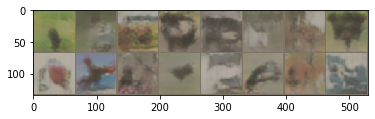

epoch: 77, time: 2974.794s, D loss: 0.158, G loss: 5.323
epoch: 77, time: 2976.725s, D loss: 0.214, G loss: 5.091
epoch: 77, time: 2978.656s, D loss: 0.212, G loss: 3.892
epoch: 77, time: 2980.574s, D loss: 0.176, G loss: 5.313
epoch: 77, time: 2982.502s, D loss: 0.033, G loss: 9.126


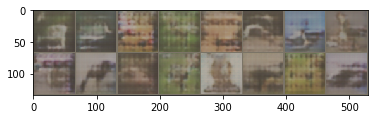

epoch: 77, time: 2984.601s, D loss: 0.051, G loss: 7.689
epoch: 77, time: 2986.527s, D loss: 0.174, G loss: 4.494
epoch: 77, time: 2988.447s, D loss: 0.105, G loss: 7.231
epoch: 77, time: 2990.384s, D loss: 0.087, G loss: 8.723
epoch: 77, time: 2992.324s, D loss: 0.071, G loss: 5.896


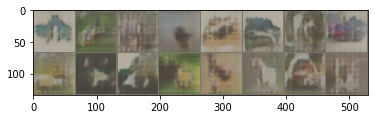

epoch: 77, time: 2994.411s, D loss: 0.016, G loss: 6.285
epoch: 77, time: 2996.344s, D loss: 0.032, G loss: 5.331
epoch: 77, time: 2998.278s, D loss: 0.142, G loss: 6.083
epoch: 77, time: 3000.208s, D loss: 0.117, G loss: 6.038
epoch: 77, time: 3002.147s, D loss: 0.231, G loss: 7.274


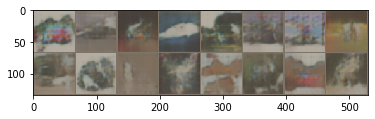

epoch: 77, time: 3004.232s, D loss: 0.060, G loss: 6.927
epoch: 77, time: 3006.171s, D loss: 0.063, G loss: 6.892
epoch: 77, time: 3008.095s, D loss: 0.109, G loss: 5.499
epoch: 77, time: 3010.012s, D loss: 0.219, G loss: 5.725
epoch: 78, time: 3011.073s, D loss: 0.015, G loss: 7.165


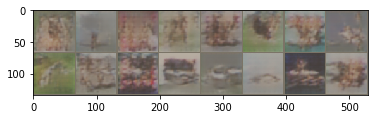

epoch: 78, time: 3013.146s, D loss: 0.150, G loss: 5.430
epoch: 78, time: 3015.078s, D loss: 0.091, G loss: 6.840
epoch: 78, time: 3017.002s, D loss: 0.120, G loss: 8.204
epoch: 78, time: 3018.920s, D loss: 0.040, G loss: 7.789
epoch: 78, time: 3020.840s, D loss: 0.030, G loss: 6.338


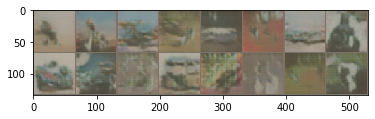

epoch: 78, time: 3022.907s, D loss: 0.050, G loss: 6.523
epoch: 78, time: 3024.846s, D loss: 0.038, G loss: 6.832
epoch: 78, time: 3026.779s, D loss: 0.223, G loss: 4.593
epoch: 78, time: 3028.704s, D loss: 0.046, G loss: 5.799
epoch: 78, time: 3030.629s, D loss: 0.037, G loss: 6.502


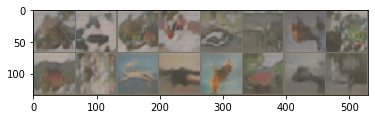

epoch: 78, time: 3032.800s, D loss: 0.015, G loss: 7.325
epoch: 78, time: 3034.748s, D loss: 0.036, G loss: 6.497
epoch: 78, time: 3036.682s, D loss: 0.007, G loss: 8.312
epoch: 78, time: 3038.614s, D loss: 0.036, G loss: 5.844
epoch: 78, time: 3040.545s, D loss: 0.067, G loss: 8.318


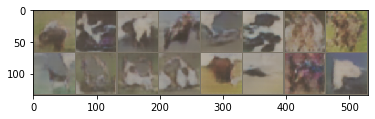

epoch: 78, time: 3042.623s, D loss: 0.055, G loss: 8.180
epoch: 78, time: 3044.567s, D loss: 0.012, G loss: 5.830
epoch: 78, time: 3046.513s, D loss: 0.075, G loss: 7.155
epoch: 78, time: 3048.470s, D loss: 0.063, G loss: 5.172
epoch: 79, time: 3049.543s, D loss: 0.014, G loss: 7.464


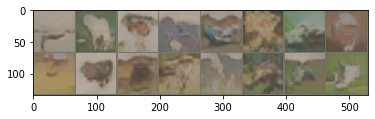

epoch: 79, time: 3051.676s, D loss: 0.005, G loss: 9.661
epoch: 79, time: 3053.609s, D loss: 0.134, G loss: 7.814
epoch: 79, time: 3055.577s, D loss: 0.023, G loss: 10.017
epoch: 79, time: 3057.515s, D loss: 0.092, G loss: 6.737
epoch: 79, time: 3059.428s, D loss: 0.006, G loss: 10.013


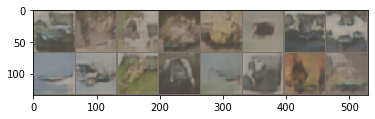

epoch: 79, time: 3061.504s, D loss: 0.023, G loss: 9.370
epoch: 79, time: 3063.422s, D loss: 0.025, G loss: 6.911
epoch: 79, time: 3065.373s, D loss: 0.020, G loss: 6.925
epoch: 79, time: 3067.292s, D loss: 0.162, G loss: 12.438
epoch: 79, time: 3069.211s, D loss: 0.056, G loss: 6.114


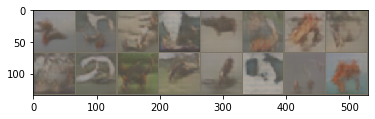

epoch: 79, time: 3071.290s, D loss: 0.010, G loss: 14.715
epoch: 79, time: 3073.221s, D loss: 0.218, G loss: 8.236
epoch: 79, time: 3075.161s, D loss: 0.095, G loss: 9.223
epoch: 79, time: 3077.067s, D loss: 0.281, G loss: 5.115
epoch: 79, time: 3079.001s, D loss: 0.071, G loss: 10.010


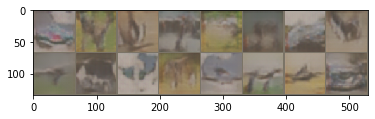

epoch: 79, time: 3081.083s, D loss: 0.387, G loss: 5.633
epoch: 79, time: 3082.997s, D loss: 0.064, G loss: 6.977
epoch: 79, time: 3084.908s, D loss: 0.559, G loss: 6.024
epoch: 79, time: 3086.810s, D loss: 0.014, G loss: 9.303
epoch: 80, time: 3087.869s, D loss: 0.095, G loss: 7.684


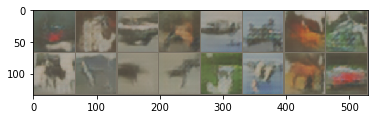

epoch: 80, time: 3089.943s, D loss: 0.019, G loss: 7.204
epoch: 80, time: 3091.896s, D loss: 0.010, G loss: 9.739
epoch: 80, time: 3093.837s, D loss: 0.010, G loss: 9.055
epoch: 80, time: 3095.773s, D loss: 0.053, G loss: 6.152
epoch: 80, time: 3097.692s, D loss: 0.051, G loss: 5.580


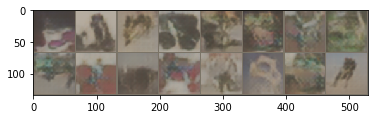

epoch: 80, time: 3099.777s, D loss: 0.272, G loss: 7.798
epoch: 80, time: 3101.702s, D loss: 0.466, G loss: 6.996
epoch: 80, time: 3103.635s, D loss: 0.067, G loss: 5.975
epoch: 80, time: 3105.569s, D loss: 0.074, G loss: 9.289
epoch: 80, time: 3107.495s, D loss: 0.003, G loss: 10.873


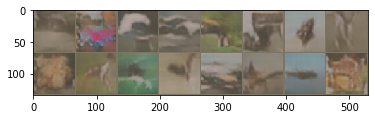

epoch: 80, time: 3109.586s, D loss: 0.008, G loss: 7.134
epoch: 80, time: 3111.524s, D loss: 0.043, G loss: 6.444
epoch: 80, time: 3113.469s, D loss: 0.034, G loss: 8.417
epoch: 80, time: 3115.438s, D loss: 0.074, G loss: 4.340
epoch: 80, time: 3117.389s, D loss: 0.072, G loss: 4.903


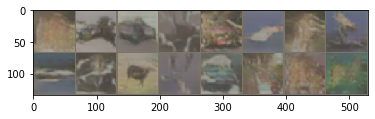

epoch: 80, time: 3119.493s, D loss: 0.100, G loss: 4.654
epoch: 80, time: 3121.437s, D loss: 0.028, G loss: 5.207
epoch: 80, time: 3123.357s, D loss: 0.026, G loss: 6.825
epoch: 80, time: 3125.299s, D loss: 0.026, G loss: 7.109
epoch: 81, time: 3126.358s, D loss: 0.022, G loss: 5.828


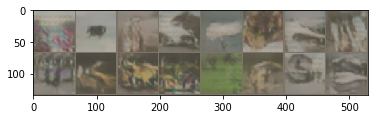

epoch: 81, time: 3128.440s, D loss: 0.042, G loss: 6.283
epoch: 81, time: 3130.353s, D loss: 0.051, G loss: 5.082
epoch: 81, time: 3132.289s, D loss: 0.022, G loss: 5.863
epoch: 81, time: 3134.208s, D loss: 0.010, G loss: 6.900
epoch: 81, time: 3136.145s, D loss: 0.020, G loss: 4.884


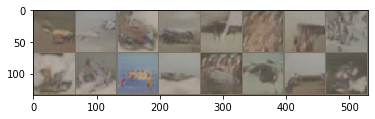

epoch: 81, time: 3138.213s, D loss: 0.004, G loss: 7.094
epoch: 81, time: 3140.135s, D loss: 0.015, G loss: 7.231
epoch: 81, time: 3142.056s, D loss: 0.007, G loss: 8.975
epoch: 81, time: 3143.986s, D loss: 0.022, G loss: 5.692
epoch: 81, time: 3145.930s, D loss: 0.007, G loss: 5.839


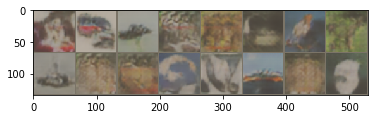

epoch: 81, time: 3148.013s, D loss: 0.016, G loss: 6.214
epoch: 81, time: 3149.949s, D loss: 0.021, G loss: 5.911
epoch: 81, time: 3151.893s, D loss: 0.013, G loss: 7.101
epoch: 81, time: 3153.823s, D loss: 0.028, G loss: 5.384
epoch: 81, time: 3155.761s, D loss: 0.013, G loss: 6.112


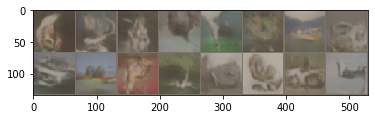

epoch: 81, time: 3157.855s, D loss: 0.017, G loss: 6.449
epoch: 81, time: 3159.782s, D loss: 0.012, G loss: 6.288
epoch: 81, time: 3161.707s, D loss: 0.014, G loss: 6.311
epoch: 81, time: 3163.630s, D loss: 0.028, G loss: 6.706
epoch: 82, time: 3164.710s, D loss: 0.091, G loss: 3.609


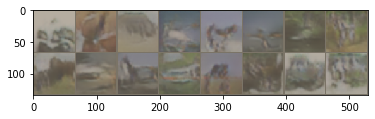

epoch: 82, time: 3166.786s, D loss: 0.023, G loss: 7.074
epoch: 82, time: 3168.715s, D loss: 0.013, G loss: 7.916
epoch: 82, time: 3170.646s, D loss: 0.006, G loss: 8.227
epoch: 82, time: 3172.570s, D loss: 0.014, G loss: 7.465
epoch: 82, time: 3174.506s, D loss: 0.020, G loss: 5.494


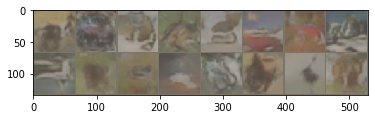

epoch: 82, time: 3176.605s, D loss: 0.016, G loss: 7.274
epoch: 82, time: 3178.539s, D loss: 0.016, G loss: 6.964
epoch: 82, time: 3180.462s, D loss: 0.031, G loss: 4.623
epoch: 82, time: 3182.402s, D loss: 0.052, G loss: 6.996
epoch: 82, time: 3184.336s, D loss: 0.014, G loss: 6.371


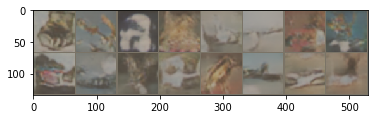

epoch: 82, time: 3186.428s, D loss: 0.770, G loss: 3.560
epoch: 82, time: 3188.341s, D loss: 0.004, G loss: 9.676
epoch: 82, time: 3190.260s, D loss: 0.130, G loss: 8.604
epoch: 82, time: 3192.201s, D loss: 0.173, G loss: 5.883
epoch: 82, time: 3194.137s, D loss: 0.075, G loss: 5.537


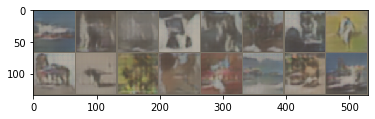

epoch: 82, time: 3196.317s, D loss: 0.143, G loss: 6.425
epoch: 82, time: 3198.254s, D loss: 0.067, G loss: 6.557
epoch: 82, time: 3200.188s, D loss: 0.114, G loss: 3.659
epoch: 82, time: 3202.122s, D loss: 0.085, G loss: 4.996
epoch: 83, time: 3203.196s, D loss: 0.035, G loss: 6.732


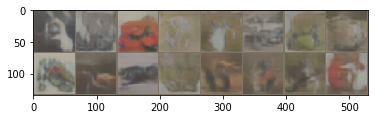

epoch: 83, time: 3205.331s, D loss: 0.081, G loss: 5.833
epoch: 83, time: 3207.262s, D loss: 0.037, G loss: 5.192
epoch: 83, time: 3209.179s, D loss: 0.030, G loss: 4.413
epoch: 83, time: 3211.078s, D loss: 0.389, G loss: 3.735
epoch: 83, time: 3212.990s, D loss: 0.053, G loss: 6.350


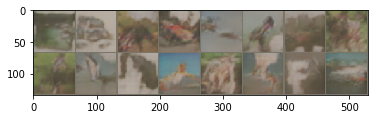

epoch: 83, time: 3215.069s, D loss: 0.025, G loss: 6.592
epoch: 83, time: 3216.992s, D loss: 0.042, G loss: 6.078
epoch: 83, time: 3218.924s, D loss: 0.011, G loss: 6.814
epoch: 83, time: 3220.851s, D loss: 0.015, G loss: 7.310
epoch: 83, time: 3222.797s, D loss: 0.015, G loss: 6.981


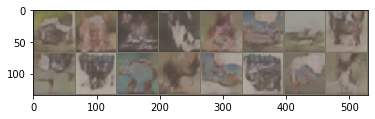

epoch: 83, time: 3224.902s, D loss: 0.118, G loss: 6.300
epoch: 83, time: 3226.816s, D loss: 0.005, G loss: 7.959
epoch: 83, time: 3228.753s, D loss: 0.010, G loss: 6.976
epoch: 83, time: 3230.696s, D loss: 0.084, G loss: 5.961
epoch: 83, time: 3232.634s, D loss: 0.006, G loss: 7.886


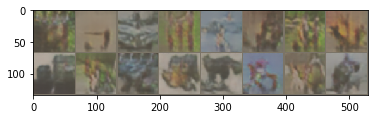

epoch: 83, time: 3234.710s, D loss: 0.320, G loss: 4.664
epoch: 83, time: 3236.644s, D loss: 0.039, G loss: 5.810
epoch: 83, time: 3238.580s, D loss: 0.005, G loss: 7.219
epoch: 83, time: 3240.521s, D loss: 0.026, G loss: 6.253
epoch: 84, time: 3241.599s, D loss: 0.025, G loss: 5.776


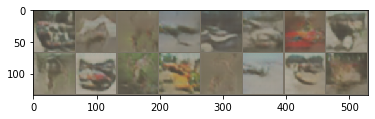

epoch: 84, time: 3243.710s, D loss: 0.011, G loss: 6.930
epoch: 84, time: 3245.653s, D loss: 0.006, G loss: 7.732
epoch: 84, time: 3247.580s, D loss: 0.038, G loss: 5.936
epoch: 84, time: 3249.525s, D loss: 0.026, G loss: 9.270
epoch: 84, time: 3251.452s, D loss: 0.003, G loss: 7.064


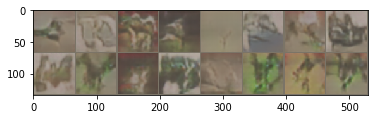

epoch: 84, time: 3253.523s, D loss: 0.003, G loss: 7.380
epoch: 84, time: 3255.464s, D loss: 0.002, G loss: 8.107
epoch: 84, time: 3257.401s, D loss: 0.008, G loss: 8.526
epoch: 84, time: 3259.325s, D loss: 0.007, G loss: 9.154
epoch: 84, time: 3261.245s, D loss: 0.014, G loss: 5.529


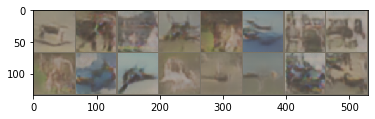

epoch: 84, time: 3263.317s, D loss: 0.012, G loss: 5.973
epoch: 84, time: 3265.263s, D loss: 0.007, G loss: 6.716
epoch: 84, time: 3267.185s, D loss: 0.005, G loss: 7.418
epoch: 84, time: 3269.116s, D loss: 0.019, G loss: 6.662
epoch: 84, time: 3271.044s, D loss: 0.003, G loss: 8.168


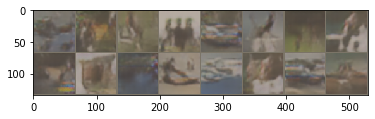

epoch: 84, time: 3273.141s, D loss: 0.007, G loss: 7.896
epoch: 84, time: 3275.099s, D loss: 0.016, G loss: 5.679
epoch: 84, time: 3277.029s, D loss: 0.023, G loss: 8.174
epoch: 84, time: 3278.962s, D loss: 0.007, G loss: 6.622
epoch: 85, time: 3280.038s, D loss: 0.003, G loss: 9.028


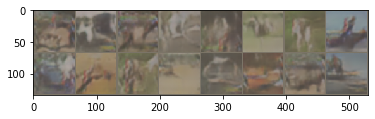

epoch: 85, time: 3282.123s, D loss: 0.015, G loss: 3.529
epoch: 85, time: 3284.057s, D loss: 0.002, G loss: 10.393
epoch: 85, time: 3285.989s, D loss: 0.003, G loss: 8.407
epoch: 85, time: 3287.916s, D loss: 0.006, G loss: 6.687
epoch: 85, time: 3289.832s, D loss: 0.011, G loss: 6.504


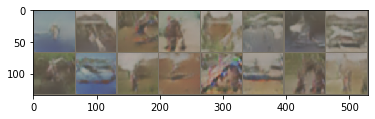

epoch: 85, time: 3291.902s, D loss: 0.003, G loss: 8.656
epoch: 85, time: 3293.826s, D loss: 0.004, G loss: 7.419
epoch: 85, time: 3295.759s, D loss: 0.016, G loss: 5.603
epoch: 85, time: 3297.690s, D loss: 0.006, G loss: 10.231
epoch: 85, time: 3299.606s, D loss: 0.003, G loss: 8.050


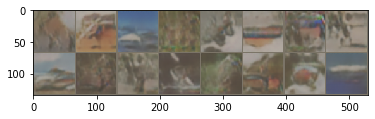

epoch: 85, time: 3301.711s, D loss: 0.010, G loss: 6.128
epoch: 85, time: 3303.650s, D loss: 0.026, G loss: 4.740
epoch: 85, time: 3305.583s, D loss: 0.015, G loss: 12.435
epoch: 85, time: 3307.514s, D loss: 0.007, G loss: 8.905
epoch: 85, time: 3309.424s, D loss: 0.001, G loss: 8.311


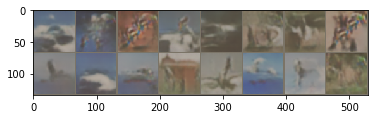

epoch: 85, time: 3311.494s, D loss: 0.002, G loss: 7.788
epoch: 85, time: 3313.415s, D loss: 0.008, G loss: 8.812
epoch: 85, time: 3315.349s, D loss: 0.004, G loss: 8.111
epoch: 85, time: 3317.274s, D loss: 0.008, G loss: 9.515
epoch: 86, time: 3318.354s, D loss: 0.002, G loss: 9.493


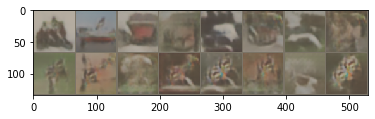

epoch: 86, time: 3320.428s, D loss: 0.023, G loss: 9.993
epoch: 86, time: 3322.337s, D loss: 0.005, G loss: 6.898
epoch: 86, time: 3324.257s, D loss: 0.003, G loss: 7.414
epoch: 86, time: 3326.210s, D loss: 0.051, G loss: 4.850
epoch: 86, time: 3328.138s, D loss: 0.035, G loss: 26.908


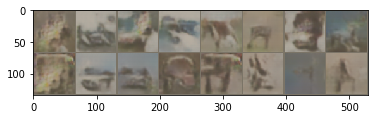

epoch: 86, time: 3330.222s, D loss: 0.168, G loss: 12.815
epoch: 86, time: 3332.162s, D loss: 0.044, G loss: 8.559
epoch: 86, time: 3334.103s, D loss: 0.030, G loss: 11.211
epoch: 86, time: 3336.045s, D loss: 0.087, G loss: 7.622
epoch: 86, time: 3337.973s, D loss: 0.035, G loss: 5.374


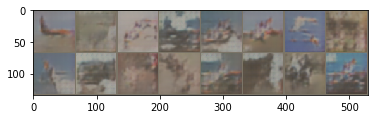

epoch: 86, time: 3340.068s, D loss: 0.024, G loss: 7.391
epoch: 86, time: 3341.971s, D loss: 0.131, G loss: 4.306
epoch: 86, time: 3343.880s, D loss: 0.009, G loss: 10.920
epoch: 86, time: 3345.791s, D loss: 0.048, G loss: 8.014
epoch: 86, time: 3347.709s, D loss: 0.014, G loss: 8.527


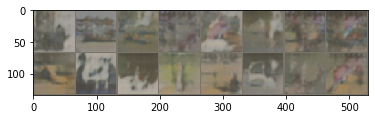

epoch: 86, time: 3349.796s, D loss: 0.080, G loss: 6.063
epoch: 86, time: 3351.738s, D loss: 0.009, G loss: 8.001
epoch: 86, time: 3353.662s, D loss: 0.011, G loss: 7.322
epoch: 86, time: 3355.643s, D loss: 0.017, G loss: 8.218
epoch: 87, time: 3356.740s, D loss: 0.006, G loss: 9.435


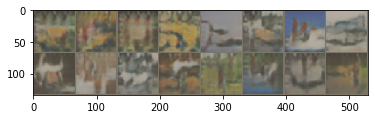

epoch: 87, time: 3358.914s, D loss: 0.059, G loss: 6.067
epoch: 87, time: 3360.857s, D loss: 0.079, G loss: 5.773
epoch: 87, time: 3362.840s, D loss: 0.001, G loss: 9.663
epoch: 87, time: 3364.817s, D loss: 0.016, G loss: 7.128
epoch: 87, time: 3366.771s, D loss: 0.011, G loss: 7.162


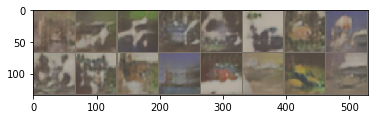

epoch: 87, time: 3368.864s, D loss: 0.008, G loss: 7.421
epoch: 87, time: 3370.802s, D loss: 0.012, G loss: 9.538
epoch: 87, time: 3372.727s, D loss: 0.014, G loss: 8.488
epoch: 87, time: 3374.677s, D loss: 0.007, G loss: 7.718
epoch: 87, time: 3376.589s, D loss: 0.010, G loss: 6.562


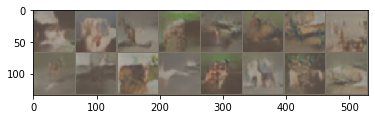

epoch: 87, time: 3378.673s, D loss: 0.012, G loss: 7.333
epoch: 87, time: 3380.596s, D loss: 0.019, G loss: 6.133
epoch: 87, time: 3382.509s, D loss: 0.008, G loss: 10.001
epoch: 87, time: 3384.443s, D loss: 0.046, G loss: 5.552
epoch: 87, time: 3386.386s, D loss: 0.017, G loss: 6.468


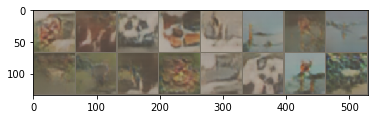

epoch: 87, time: 3388.463s, D loss: 0.008, G loss: 6.994
epoch: 87, time: 3390.390s, D loss: 0.018, G loss: 6.546
epoch: 87, time: 3392.337s, D loss: 0.005, G loss: 7.698
epoch: 87, time: 3394.282s, D loss: 0.036, G loss: 11.638
epoch: 88, time: 3395.358s, D loss: 0.024, G loss: 9.544


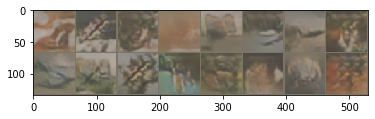

epoch: 88, time: 3397.453s, D loss: 0.005, G loss: 8.753
epoch: 88, time: 3399.381s, D loss: 0.005, G loss: 7.301
epoch: 88, time: 3401.295s, D loss: 0.005, G loss: 8.708
epoch: 88, time: 3403.219s, D loss: 0.007, G loss: 6.581
epoch: 88, time: 3405.165s, D loss: 0.009, G loss: 6.787


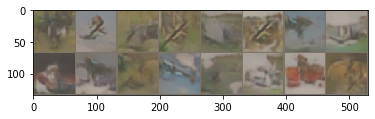

epoch: 88, time: 3407.239s, D loss: 0.041, G loss: 5.581
epoch: 88, time: 3409.160s, D loss: 0.060, G loss: 6.972
epoch: 88, time: 3411.084s, D loss: 0.135, G loss: 15.970
epoch: 88, time: 3413.024s, D loss: 0.192, G loss: 5.546
epoch: 88, time: 3414.964s, D loss: 0.183, G loss: 7.355


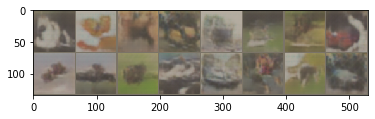

epoch: 88, time: 3417.060s, D loss: 0.051, G loss: 6.675
epoch: 88, time: 3418.991s, D loss: 0.028, G loss: 7.033
epoch: 88, time: 3420.927s, D loss: 0.087, G loss: 6.227
epoch: 88, time: 3422.860s, D loss: 0.061, G loss: 6.597
epoch: 88, time: 3424.816s, D loss: 0.042, G loss: 7.783


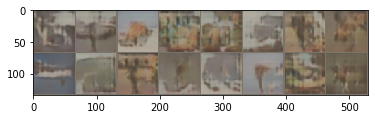

epoch: 88, time: 3426.890s, D loss: 0.120, G loss: 4.579
epoch: 88, time: 3428.816s, D loss: 0.125, G loss: 5.842
epoch: 88, time: 3430.748s, D loss: 0.225, G loss: 5.283
epoch: 88, time: 3432.687s, D loss: 0.052, G loss: 7.119
epoch: 89, time: 3433.754s, D loss: 0.541, G loss: 5.293


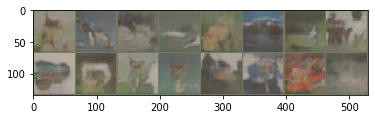

epoch: 89, time: 3435.869s, D loss: 0.034, G loss: 6.758
epoch: 89, time: 3437.806s, D loss: 0.681, G loss: 16.650
epoch: 89, time: 3439.751s, D loss: 0.061, G loss: 7.170
epoch: 89, time: 3441.681s, D loss: 0.418, G loss: 4.471
epoch: 89, time: 3443.605s, D loss: 0.173, G loss: 5.518


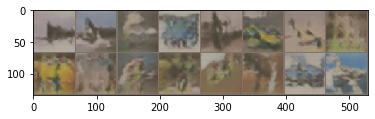

epoch: 89, time: 3445.720s, D loss: 0.023, G loss: 6.970
epoch: 89, time: 3447.644s, D loss: 0.009, G loss: 9.656
epoch: 89, time: 3449.560s, D loss: 0.123, G loss: 5.617
epoch: 89, time: 3451.497s, D loss: 0.076, G loss: 6.190
epoch: 89, time: 3453.418s, D loss: 0.040, G loss: 7.464


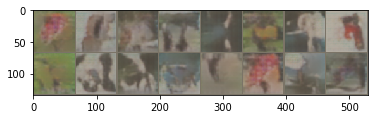

epoch: 89, time: 3455.507s, D loss: 0.174, G loss: 6.840
epoch: 89, time: 3457.415s, D loss: 0.916, G loss: 9.009
epoch: 89, time: 3459.336s, D loss: 0.006, G loss: 13.609
epoch: 89, time: 3461.277s, D loss: 0.083, G loss: 7.143
epoch: 89, time: 3463.190s, D loss: 0.119, G loss: 6.701


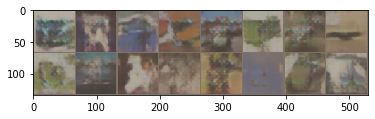

epoch: 89, time: 3465.296s, D loss: 0.095, G loss: 5.511
epoch: 89, time: 3467.218s, D loss: 0.175, G loss: 12.528
epoch: 89, time: 3469.137s, D loss: 0.071, G loss: 5.406
epoch: 89, time: 3471.036s, D loss: 0.151, G loss: 4.516
epoch: 90, time: 3472.081s, D loss: 0.046, G loss: 9.667


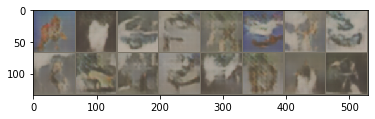

epoch: 90, time: 3474.112s, D loss: 0.021, G loss: 5.775
epoch: 90, time: 3476.050s, D loss: 0.068, G loss: 8.553
epoch: 90, time: 3477.993s, D loss: 0.115, G loss: 4.368
epoch: 90, time: 3479.914s, D loss: 0.179, G loss: 10.943
epoch: 90, time: 3481.859s, D loss: 0.033, G loss: 6.788


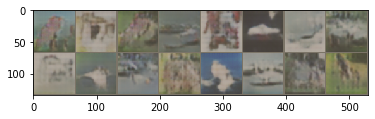

epoch: 90, time: 3483.940s, D loss: 0.074, G loss: 11.951
epoch: 90, time: 3485.875s, D loss: 0.054, G loss: 5.738
epoch: 90, time: 3487.786s, D loss: 0.040, G loss: 4.890
epoch: 90, time: 3489.703s, D loss: 0.370, G loss: 8.694
epoch: 90, time: 3491.635s, D loss: 0.022, G loss: 8.198


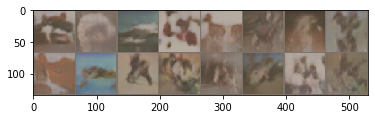

epoch: 90, time: 3493.717s, D loss: 0.090, G loss: 5.225
epoch: 90, time: 3495.659s, D loss: 0.488, G loss: 6.278
epoch: 90, time: 3497.581s, D loss: 0.112, G loss: 9.375
epoch: 90, time: 3499.512s, D loss: 0.108, G loss: 4.550
epoch: 90, time: 3501.432s, D loss: 0.320, G loss: 3.974


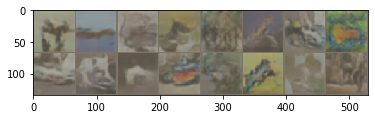

epoch: 90, time: 3503.518s, D loss: 0.058, G loss: 4.978
epoch: 90, time: 3505.482s, D loss: 0.064, G loss: 7.012
epoch: 90, time: 3507.428s, D loss: 0.122, G loss: 8.004
epoch: 90, time: 3509.365s, D loss: 0.380, G loss: 6.508
epoch: 91, time: 3510.430s, D loss: 0.039, G loss: 5.121


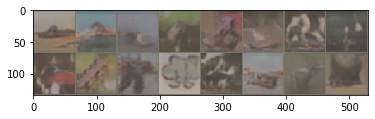

epoch: 91, time: 3512.540s, D loss: 0.143, G loss: 10.151
epoch: 91, time: 3514.486s, D loss: 0.031, G loss: 5.726
epoch: 91, time: 3516.424s, D loss: 0.042, G loss: 7.358
epoch: 91, time: 3518.359s, D loss: 0.287, G loss: 6.376
epoch: 91, time: 3520.300s, D loss: 0.034, G loss: 5.918


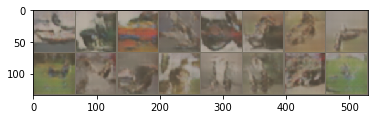

epoch: 91, time: 3522.457s, D loss: 0.012, G loss: 10.258
epoch: 91, time: 3524.398s, D loss: 0.017, G loss: 6.032
epoch: 91, time: 3526.326s, D loss: 0.067, G loss: 6.833
epoch: 91, time: 3528.237s, D loss: 0.017, G loss: 7.599
epoch: 91, time: 3530.164s, D loss: 0.035, G loss: 7.212


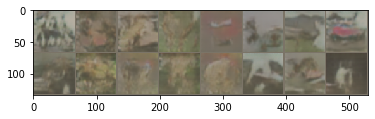

epoch: 91, time: 3532.240s, D loss: 0.015, G loss: 8.467
epoch: 91, time: 3534.153s, D loss: 0.004, G loss: 7.473
epoch: 91, time: 3536.113s, D loss: 0.014, G loss: 7.293
epoch: 91, time: 3538.050s, D loss: 0.015, G loss: 6.808
epoch: 91, time: 3539.965s, D loss: 0.057, G loss: 5.767


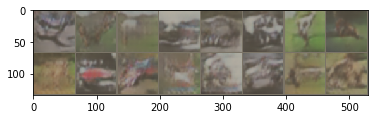

epoch: 91, time: 3542.069s, D loss: 0.009, G loss: 7.232
epoch: 91, time: 3543.996s, D loss: 0.008, G loss: 7.281
epoch: 91, time: 3545.929s, D loss: 0.029, G loss: 7.202
epoch: 91, time: 3547.847s, D loss: 0.017, G loss: 7.760
epoch: 92, time: 3548.911s, D loss: 0.010, G loss: 8.261


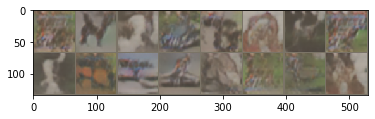

epoch: 92, time: 3550.981s, D loss: 0.042, G loss: 5.929
epoch: 92, time: 3552.899s, D loss: 0.008, G loss: 5.949
epoch: 92, time: 3554.845s, D loss: 0.028, G loss: 7.489
epoch: 92, time: 3556.773s, D loss: 0.007, G loss: 9.080
epoch: 92, time: 3558.700s, D loss: 0.007, G loss: 5.880


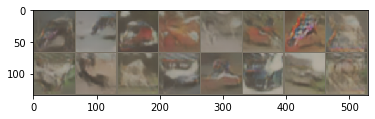

epoch: 92, time: 3560.783s, D loss: 0.005, G loss: 7.268
epoch: 92, time: 3562.713s, D loss: 0.010, G loss: 6.960
epoch: 92, time: 3564.647s, D loss: 0.036, G loss: 5.415
epoch: 92, time: 3566.592s, D loss: 0.016, G loss: 5.873
epoch: 92, time: 3568.504s, D loss: 0.017, G loss: 6.199


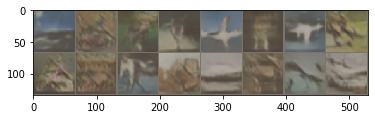

epoch: 92, time: 3570.578s, D loss: 0.017, G loss: 6.262
epoch: 92, time: 3572.531s, D loss: 0.008, G loss: 8.025
epoch: 92, time: 3574.470s, D loss: 0.011, G loss: 7.585
epoch: 92, time: 3576.390s, D loss: 0.025, G loss: 6.327
epoch: 92, time: 3578.318s, D loss: 0.025, G loss: 13.393


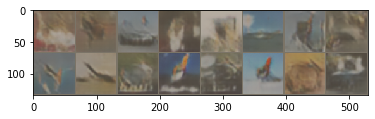

epoch: 92, time: 3580.391s, D loss: 0.027, G loss: 8.467
epoch: 92, time: 3582.329s, D loss: 0.007, G loss: 6.845
epoch: 92, time: 3584.260s, D loss: 0.059, G loss: 6.922
epoch: 92, time: 3586.208s, D loss: 0.017, G loss: 10.073
epoch: 93, time: 3587.263s, D loss: 0.112, G loss: 4.944


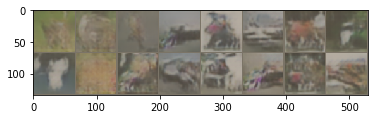

epoch: 93, time: 3589.349s, D loss: 0.007, G loss: 9.940
epoch: 93, time: 3591.262s, D loss: 0.012, G loss: 7.068
epoch: 93, time: 3593.203s, D loss: 0.874, G loss: 8.903
epoch: 93, time: 3595.166s, D loss: 0.210, G loss: 10.094
epoch: 93, time: 3597.109s, D loss: 0.011, G loss: 7.601


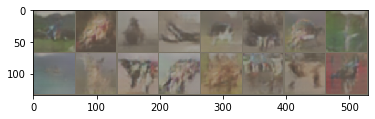

epoch: 93, time: 3599.153s, D loss: 0.033, G loss: 6.648
epoch: 93, time: 3601.073s, D loss: 0.038, G loss: 6.056
epoch: 93, time: 3603.011s, D loss: 0.001, G loss: 9.020
epoch: 93, time: 3604.948s, D loss: 0.005, G loss: 7.604
epoch: 93, time: 3606.860s, D loss: 0.007, G loss: 8.926


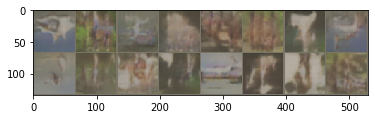

epoch: 93, time: 3608.948s, D loss: 0.009, G loss: 7.722
epoch: 93, time: 3610.894s, D loss: 0.018, G loss: 8.872
epoch: 93, time: 3612.811s, D loss: 0.038, G loss: 10.213
epoch: 93, time: 3614.740s, D loss: 0.027, G loss: 7.974
epoch: 93, time: 3616.670s, D loss: 0.005, G loss: 8.247


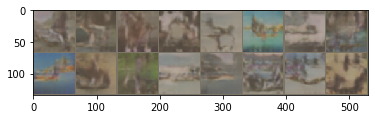

epoch: 93, time: 3618.775s, D loss: 0.009, G loss: 7.256
epoch: 93, time: 3620.701s, D loss: 0.007, G loss: 7.264
epoch: 93, time: 3622.622s, D loss: 0.006, G loss: 9.121
epoch: 93, time: 3624.564s, D loss: 0.005, G loss: 8.365
epoch: 94, time: 3625.643s, D loss: 0.003, G loss: 8.436


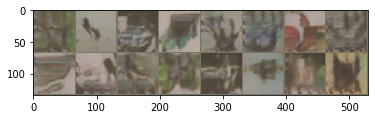

epoch: 94, time: 3627.716s, D loss: 0.005, G loss: 8.270
epoch: 94, time: 3629.648s, D loss: 0.003, G loss: 9.046
epoch: 94, time: 3631.585s, D loss: 0.005, G loss: 7.368
epoch: 94, time: 3633.515s, D loss: 0.004, G loss: 8.525
epoch: 94, time: 3635.440s, D loss: 0.013, G loss: 7.278


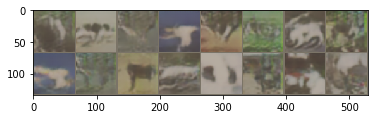

epoch: 94, time: 3637.526s, D loss: 0.004, G loss: 7.343
epoch: 94, time: 3639.452s, D loss: 0.008, G loss: 13.465
epoch: 94, time: 3641.370s, D loss: 0.002, G loss: 7.559
epoch: 94, time: 3643.297s, D loss: 0.006, G loss: 7.717
epoch: 94, time: 3645.236s, D loss: 0.001, G loss: 10.170


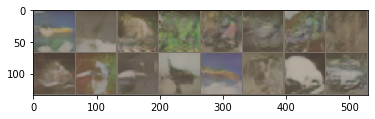

epoch: 94, time: 3647.295s, D loss: 0.042, G loss: 9.559
epoch: 94, time: 3649.219s, D loss: 0.008, G loss: 6.989
epoch: 94, time: 3651.158s, D loss: 0.003, G loss: 8.166
epoch: 94, time: 3653.104s, D loss: 0.009, G loss: 7.976
epoch: 94, time: 3655.042s, D loss: 0.002, G loss: 9.334


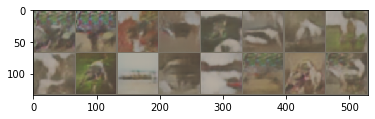

epoch: 94, time: 3657.141s, D loss: 0.004, G loss: 7.916
epoch: 94, time: 3659.071s, D loss: 0.001, G loss: 9.204
epoch: 94, time: 3661.002s, D loss: 0.013, G loss: 6.650
epoch: 94, time: 3662.941s, D loss: 0.033, G loss: 12.205
epoch: 95, time: 3664.006s, D loss: 0.012, G loss: 14.376


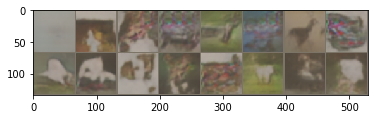

epoch: 95, time: 3666.102s, D loss: 0.013, G loss: 13.428
epoch: 95, time: 3668.053s, D loss: 0.002, G loss: 10.910
epoch: 95, time: 3669.992s, D loss: 0.002, G loss: 8.245
epoch: 95, time: 3671.939s, D loss: 0.002, G loss: 7.668
epoch: 95, time: 3673.877s, D loss: 0.003, G loss: 7.819


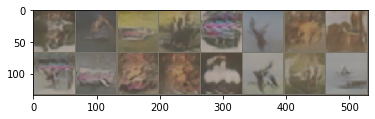

epoch: 95, time: 3675.987s, D loss: 0.002, G loss: 8.322
epoch: 95, time: 3677.924s, D loss: 0.051, G loss: 6.021
epoch: 95, time: 3679.871s, D loss: 0.584, G loss: 4.016
epoch: 95, time: 3681.813s, D loss: 0.176, G loss: 6.919
epoch: 95, time: 3683.750s, D loss: 0.149, G loss: 10.802


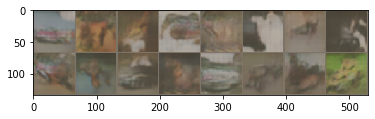

epoch: 95, time: 3685.935s, D loss: 0.004, G loss: 9.712
epoch: 95, time: 3687.855s, D loss: 0.056, G loss: 5.513
epoch: 95, time: 3689.788s, D loss: 0.184, G loss: 9.882
epoch: 95, time: 3691.730s, D loss: 0.072, G loss: 11.949
epoch: 95, time: 3693.664s, D loss: 0.055, G loss: 5.696


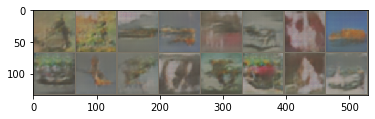

epoch: 95, time: 3695.769s, D loss: 0.228, G loss: 5.805
epoch: 95, time: 3697.689s, D loss: 0.100, G loss: 6.250
epoch: 95, time: 3699.612s, D loss: 0.011, G loss: 6.926
epoch: 95, time: 3701.536s, D loss: 0.136, G loss: 6.123
epoch: 96, time: 3702.593s, D loss: 0.033, G loss: 8.844


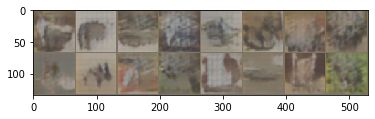

epoch: 96, time: 3704.702s, D loss: 0.013, G loss: 9.539
epoch: 96, time: 3706.637s, D loss: 0.013, G loss: 9.073
epoch: 96, time: 3708.569s, D loss: 0.024, G loss: 8.598
epoch: 96, time: 3710.494s, D loss: 0.040, G loss: 4.846
epoch: 96, time: 3712.433s, D loss: 0.179, G loss: 7.408


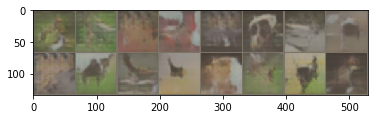

epoch: 96, time: 3714.518s, D loss: 0.189, G loss: 6.055
epoch: 96, time: 3716.446s, D loss: 0.023, G loss: 8.391
epoch: 96, time: 3718.376s, D loss: 0.069, G loss: 9.097
epoch: 96, time: 3720.307s, D loss: 0.299, G loss: 5.043
epoch: 96, time: 3722.252s, D loss: 0.020, G loss: 7.737


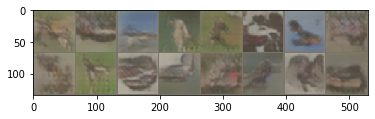

epoch: 96, time: 3724.346s, D loss: 0.223, G loss: 5.617
epoch: 96, time: 3726.248s, D loss: 0.063, G loss: 6.412
epoch: 96, time: 3728.148s, D loss: 0.050, G loss: 5.384
epoch: 96, time: 3730.041s, D loss: 0.031, G loss: 8.004
epoch: 96, time: 3731.966s, D loss: 0.041, G loss: 6.645


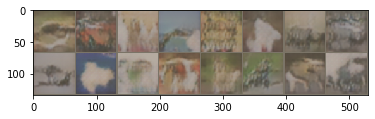

epoch: 96, time: 3734.050s, D loss: 0.031, G loss: 7.815
epoch: 96, time: 3735.977s, D loss: 0.031, G loss: 7.111
epoch: 96, time: 3737.912s, D loss: 0.014, G loss: 7.231
epoch: 96, time: 3739.849s, D loss: 0.022, G loss: 11.021
epoch: 97, time: 3740.907s, D loss: 0.004, G loss: 7.667


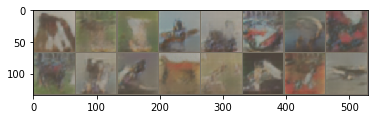

epoch: 97, time: 3743.001s, D loss: 0.055, G loss: 5.262
epoch: 97, time: 3744.954s, D loss: 0.082, G loss: 4.956
epoch: 97, time: 3746.895s, D loss: 0.043, G loss: 6.298
epoch: 97, time: 3748.808s, D loss: 0.070, G loss: 5.504
epoch: 97, time: 3750.738s, D loss: 0.054, G loss: 9.483


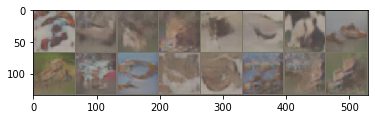

epoch: 97, time: 3752.834s, D loss: 0.012, G loss: 6.370
epoch: 97, time: 3754.774s, D loss: 0.042, G loss: 6.400
epoch: 97, time: 3756.720s, D loss: 0.025, G loss: 5.634
epoch: 97, time: 3758.658s, D loss: 0.330, G loss: 7.871
epoch: 97, time: 3760.583s, D loss: 0.010, G loss: 6.088


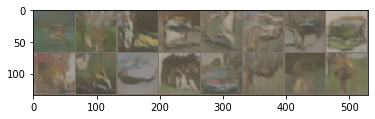

epoch: 97, time: 3762.698s, D loss: 0.003, G loss: 7.939
epoch: 97, time: 3764.641s, D loss: 0.055, G loss: 6.660
epoch: 97, time: 3766.573s, D loss: 0.019, G loss: 6.578
epoch: 97, time: 3768.494s, D loss: 0.026, G loss: 5.766
epoch: 97, time: 3770.409s, D loss: 0.007, G loss: 8.093


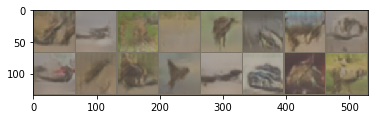

epoch: 97, time: 3772.511s, D loss: 0.016, G loss: 9.238
epoch: 97, time: 3774.424s, D loss: 0.017, G loss: 5.428
epoch: 97, time: 3776.353s, D loss: 0.009, G loss: 8.663
epoch: 97, time: 3778.287s, D loss: 0.017, G loss: 5.191
epoch: 98, time: 3779.354s, D loss: 0.007, G loss: 6.742


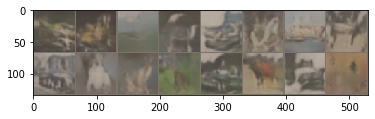

epoch: 98, time: 3781.471s, D loss: 0.033, G loss: 6.365
epoch: 98, time: 3783.398s, D loss: 0.012, G loss: 6.838
epoch: 98, time: 3785.345s, D loss: 0.010, G loss: 7.491
epoch: 98, time: 3787.273s, D loss: 0.008, G loss: 9.034
epoch: 98, time: 3789.194s, D loss: 0.002, G loss: 8.790


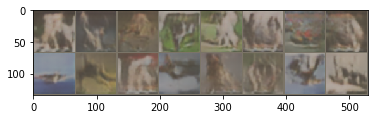

epoch: 98, time: 3791.271s, D loss: 0.008, G loss: 7.751
epoch: 98, time: 3793.194s, D loss: 0.004, G loss: 7.090
epoch: 98, time: 3795.129s, D loss: 0.004, G loss: 8.104
epoch: 98, time: 3797.041s, D loss: 0.005, G loss: 7.365
epoch: 98, time: 3798.954s, D loss: 0.008, G loss: 9.054


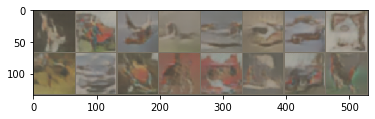

epoch: 98, time: 3801.032s, D loss: 0.010, G loss: 6.338
epoch: 98, time: 3802.962s, D loss: 0.003, G loss: 7.971
epoch: 98, time: 3804.908s, D loss: 0.009, G loss: 8.734
epoch: 98, time: 3806.854s, D loss: 0.004, G loss: 7.053
epoch: 98, time: 3808.792s, D loss: 0.012, G loss: 8.086


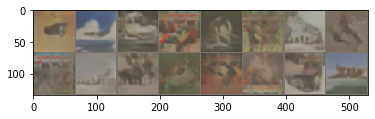

epoch: 98, time: 3810.881s, D loss: 0.001, G loss: 8.901
epoch: 98, time: 3812.847s, D loss: 0.004, G loss: 9.111
epoch: 98, time: 3814.820s, D loss: 0.020, G loss: 6.685
epoch: 98, time: 3816.756s, D loss: 0.014, G loss: 8.512
epoch: 99, time: 3817.817s, D loss: 0.002, G loss: 8.049


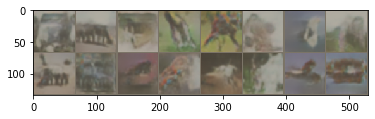

epoch: 99, time: 3819.883s, D loss: 0.002, G loss: 8.289
epoch: 99, time: 3821.804s, D loss: 0.002, G loss: 7.842
epoch: 99, time: 3823.736s, D loss: 0.002, G loss: 8.863
epoch: 99, time: 3825.693s, D loss: 0.001, G loss: 8.861
epoch: 99, time: 3827.618s, D loss: 0.008, G loss: 6.294


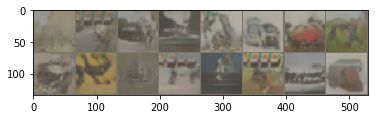

epoch: 99, time: 3829.689s, D loss: 0.023, G loss: 9.173
epoch: 99, time: 3831.617s, D loss: 0.006, G loss: 5.745
epoch: 99, time: 3833.533s, D loss: 0.003, G loss: 7.054
epoch: 99, time: 3835.470s, D loss: 0.007, G loss: 6.350
epoch: 99, time: 3837.405s, D loss: 0.014, G loss: 10.695


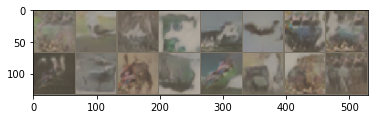

epoch: 99, time: 3839.503s, D loss: 0.077, G loss: 7.010
epoch: 99, time: 3841.474s, D loss: 0.018, G loss: 8.916
epoch: 99, time: 3843.418s, D loss: 0.007, G loss: 4.448
epoch: 99, time: 3845.383s, D loss: 0.077, G loss: 10.346
epoch: 99, time: 3847.310s, D loss: 0.043, G loss: 9.305


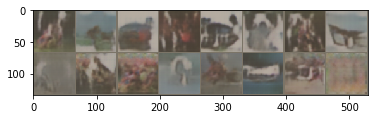

epoch: 99, time: 3849.468s, D loss: 0.245, G loss: 6.874
epoch: 99, time: 3851.396s, D loss: 0.023, G loss: 7.836
epoch: 99, time: 3853.327s, D loss: 0.213, G loss: 8.146
epoch: 99, time: 3855.243s, D loss: 0.107, G loss: 4.442
epoch: 100, time: 3856.281s, D loss: 0.112, G loss: 5.820


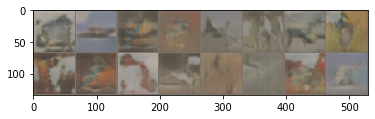

epoch: 100, time: 3858.344s, D loss: 0.083, G loss: 6.343
epoch: 100, time: 3860.267s, D loss: 0.089, G loss: 5.826
epoch: 100, time: 3862.200s, D loss: 0.039, G loss: 6.957
epoch: 100, time: 3864.124s, D loss: 0.018, G loss: 8.881
epoch: 100, time: 3866.054s, D loss: 0.025, G loss: 6.905


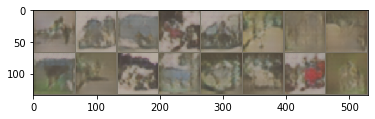

epoch: 100, time: 3868.142s, D loss: 0.316, G loss: 7.189
epoch: 100, time: 3870.065s, D loss: 0.016, G loss: 12.639
epoch: 100, time: 3871.995s, D loss: 0.028, G loss: 8.222
epoch: 100, time: 3873.933s, D loss: 0.013, G loss: 9.740
epoch: 100, time: 3875.870s, D loss: 0.014, G loss: 8.926


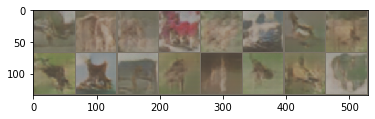

epoch: 100, time: 3877.949s, D loss: 0.012, G loss: 7.660
epoch: 100, time: 3879.875s, D loss: 0.009, G loss: 8.173
epoch: 100, time: 3881.802s, D loss: 0.011, G loss: 7.735
epoch: 100, time: 3883.733s, D loss: 0.024, G loss: 10.403
epoch: 100, time: 3885.682s, D loss: 0.033, G loss: 10.984


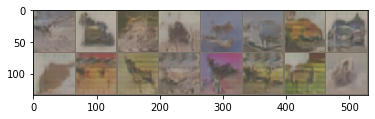

epoch: 100, time: 3887.764s, D loss: 0.008, G loss: 6.570
epoch: 100, time: 3889.698s, D loss: 0.014, G loss: 7.925
epoch: 100, time: 3891.636s, D loss: 0.002, G loss: 9.086
epoch: 100, time: 3893.574s, D loss: 0.025, G loss: 6.526
epoch: 101, time: 3894.661s, D loss: 0.001, G loss: 10.709


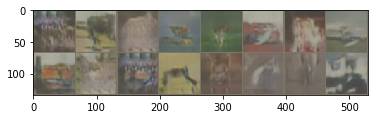

epoch: 101, time: 3896.771s, D loss: 0.003, G loss: 6.498
epoch: 101, time: 3898.705s, D loss: 0.002, G loss: 10.035
epoch: 101, time: 3900.626s, D loss: 0.006, G loss: 6.667
epoch: 101, time: 3902.591s, D loss: 0.003, G loss: 8.628
epoch: 101, time: 3904.549s, D loss: 0.026, G loss: 6.350


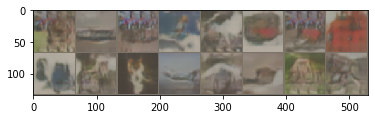

epoch: 101, time: 3906.644s, D loss: 0.036, G loss: 7.492
epoch: 101, time: 3908.597s, D loss: 0.004, G loss: 7.106
epoch: 101, time: 3910.541s, D loss: 0.016, G loss: 7.595
epoch: 101, time: 3912.490s, D loss: 0.010, G loss: 6.961
epoch: 101, time: 3914.427s, D loss: 0.014, G loss: 6.032


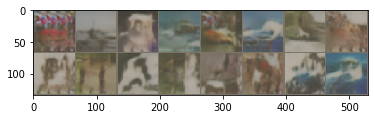

epoch: 101, time: 3916.515s, D loss: 0.023, G loss: 10.003
epoch: 101, time: 3918.454s, D loss: 0.010, G loss: 6.294
epoch: 101, time: 3920.404s, D loss: 0.002, G loss: 8.871
epoch: 101, time: 3922.352s, D loss: 0.011, G loss: 9.097
epoch: 101, time: 3924.297s, D loss: 0.002, G loss: 8.382


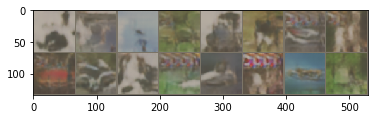

epoch: 101, time: 3926.422s, D loss: 0.003, G loss: 8.880
epoch: 101, time: 3928.350s, D loss: 0.010, G loss: 7.419
epoch: 101, time: 3930.278s, D loss: 0.005, G loss: 9.918
epoch: 101, time: 3932.245s, D loss: 0.003, G loss: 9.457
epoch: 102, time: 3933.317s, D loss: 0.011, G loss: 6.383


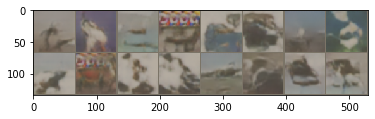

epoch: 102, time: 3935.446s, D loss: 0.005, G loss: 7.212
epoch: 102, time: 3937.372s, D loss: 0.005, G loss: 7.478
epoch: 102, time: 3939.303s, D loss: 0.005, G loss: 8.963
epoch: 102, time: 3941.216s, D loss: 0.003, G loss: 9.384
epoch: 102, time: 3943.137s, D loss: 0.003, G loss: 7.119


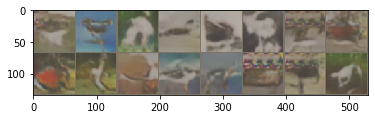

epoch: 102, time: 3945.242s, D loss: 0.008, G loss: 6.991
epoch: 102, time: 3947.186s, D loss: 0.006, G loss: 8.899
epoch: 102, time: 3949.118s, D loss: 0.002, G loss: 6.573
epoch: 102, time: 3951.049s, D loss: 0.111, G loss: 9.509
epoch: 102, time: 3953.005s, D loss: 0.001, G loss: 12.026


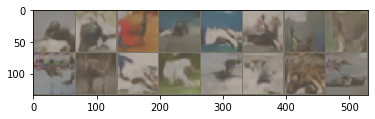

epoch: 102, time: 3955.116s, D loss: 0.013, G loss: 8.519
epoch: 102, time: 3957.060s, D loss: 0.034, G loss: 6.325
epoch: 102, time: 3958.993s, D loss: 0.452, G loss: 6.314
epoch: 102, time: 3960.924s, D loss: 0.036, G loss: 7.154
epoch: 102, time: 3962.854s, D loss: 0.088, G loss: 6.223


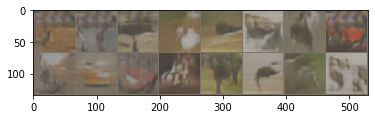

epoch: 102, time: 3964.968s, D loss: 0.034, G loss: 7.157
epoch: 102, time: 3966.897s, D loss: 0.056, G loss: 4.957
epoch: 102, time: 3968.837s, D loss: 0.053, G loss: 7.162
epoch: 102, time: 3970.764s, D loss: 0.026, G loss: 6.361
epoch: 103, time: 3971.833s, D loss: 0.165, G loss: 5.500


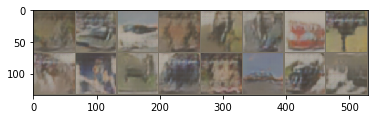

epoch: 103, time: 3973.929s, D loss: 0.041, G loss: 5.891
epoch: 103, time: 3975.874s, D loss: 0.106, G loss: 5.193
epoch: 103, time: 3977.838s, D loss: 0.055, G loss: 5.880
epoch: 103, time: 3979.801s, D loss: 0.064, G loss: 5.290
epoch: 103, time: 3981.780s, D loss: 0.016, G loss: 8.027


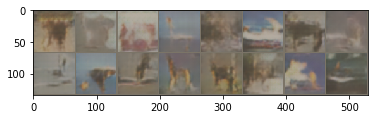

epoch: 103, time: 3983.866s, D loss: 0.057, G loss: 5.008
epoch: 103, time: 3985.796s, D loss: 0.031, G loss: 7.000
epoch: 103, time: 3987.708s, D loss: 0.009, G loss: 9.384
epoch: 103, time: 3989.627s, D loss: 0.190, G loss: 8.148
epoch: 103, time: 3991.596s, D loss: 0.008, G loss: 9.892


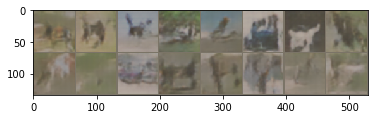

epoch: 103, time: 3993.684s, D loss: 0.040, G loss: 6.963
epoch: 103, time: 3995.624s, D loss: 0.324, G loss: 4.688
epoch: 103, time: 3997.556s, D loss: 0.258, G loss: 7.981
epoch: 103, time: 3999.503s, D loss: 0.014, G loss: 10.776
epoch: 103, time: 4001.450s, D loss: 0.280, G loss: 8.659


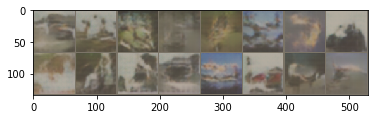

epoch: 103, time: 4003.553s, D loss: 0.221, G loss: 6.941
epoch: 103, time: 4005.507s, D loss: 0.018, G loss: 7.556
epoch: 103, time: 4007.442s, D loss: 0.026, G loss: 6.766
epoch: 103, time: 4009.383s, D loss: 0.048, G loss: 9.327
epoch: 104, time: 4010.451s, D loss: 0.036, G loss: 4.575


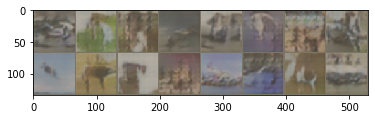

epoch: 104, time: 4012.605s, D loss: 0.185, G loss: 3.978
epoch: 104, time: 4014.530s, D loss: 0.016, G loss: 8.795
epoch: 104, time: 4016.459s, D loss: 0.018, G loss: 9.919
epoch: 104, time: 4018.395s, D loss: 0.003, G loss: 11.081
epoch: 104, time: 4020.305s, D loss: 0.056, G loss: 6.621


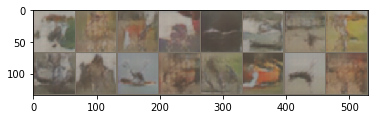

epoch: 104, time: 4022.402s, D loss: 0.015, G loss: 7.549
epoch: 104, time: 4024.348s, D loss: 0.383, G loss: 8.044
epoch: 104, time: 4026.274s, D loss: 0.002, G loss: 10.493
epoch: 104, time: 4028.193s, D loss: 0.015, G loss: 24.752
epoch: 104, time: 4030.131s, D loss: 0.026, G loss: 10.929


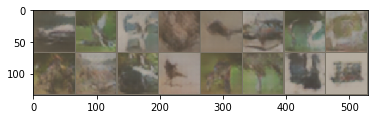

epoch: 104, time: 4032.232s, D loss: 0.106, G loss: 2.775
epoch: 104, time: 4034.170s, D loss: 0.165, G loss: 9.399
epoch: 104, time: 4036.122s, D loss: 0.447, G loss: 3.994
epoch: 104, time: 4038.056s, D loss: 0.199, G loss: 5.289
epoch: 104, time: 4039.987s, D loss: 0.202, G loss: 6.872


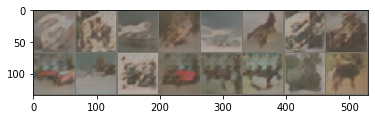

epoch: 104, time: 4042.090s, D loss: 0.084, G loss: 9.738
epoch: 104, time: 4044.018s, D loss: 0.040, G loss: 9.351
epoch: 104, time: 4045.953s, D loss: 0.032, G loss: 6.901
epoch: 104, time: 4047.885s, D loss: 0.043, G loss: 6.807
epoch: 105, time: 4048.948s, D loss: 0.030, G loss: 7.557


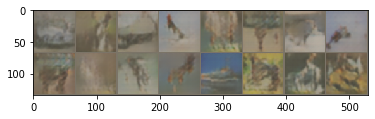

epoch: 105, time: 4051.048s, D loss: 0.014, G loss: 7.676
epoch: 105, time: 4052.998s, D loss: 0.104, G loss: 6.133
epoch: 105, time: 4054.937s, D loss: 0.007, G loss: 8.719
epoch: 105, time: 4056.867s, D loss: 0.056, G loss: 8.730
epoch: 105, time: 4058.794s, D loss: 0.007, G loss: 8.800


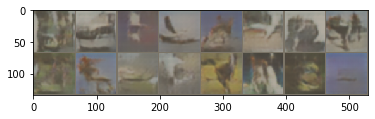

epoch: 105, time: 4060.895s, D loss: 0.014, G loss: 6.215
epoch: 105, time: 4062.822s, D loss: 0.003, G loss: 8.550
epoch: 105, time: 4064.787s, D loss: 0.013, G loss: 6.801
epoch: 105, time: 4066.706s, D loss: 0.012, G loss: 6.932
epoch: 105, time: 4068.630s, D loss: 0.024, G loss: 4.785


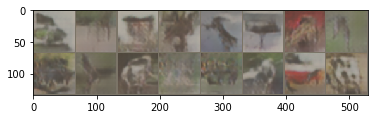

epoch: 105, time: 4070.728s, D loss: 0.016, G loss: 6.875
epoch: 105, time: 4072.675s, D loss: 0.111, G loss: 5.503
epoch: 105, time: 4074.624s, D loss: 0.010, G loss: 9.350
epoch: 105, time: 4076.549s, D loss: 0.013, G loss: 6.179
epoch: 105, time: 4078.493s, D loss: 0.015, G loss: 7.286


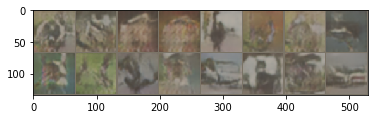

epoch: 105, time: 4080.591s, D loss: 0.011, G loss: 7.004
epoch: 105, time: 4082.569s, D loss: 0.008, G loss: 7.025
epoch: 105, time: 4084.536s, D loss: 0.007, G loss: 6.441
epoch: 105, time: 4086.471s, D loss: 0.012, G loss: 6.495
epoch: 106, time: 4087.551s, D loss: 0.032, G loss: 5.877


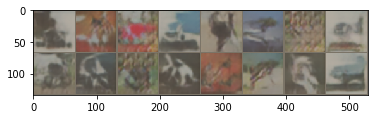

epoch: 106, time: 4089.630s, D loss: 0.005, G loss: 8.178
epoch: 106, time: 4091.576s, D loss: 0.020, G loss: 8.877
epoch: 106, time: 4093.506s, D loss: 0.017, G loss: 5.433
epoch: 106, time: 4095.444s, D loss: 0.004, G loss: 9.530
epoch: 106, time: 4097.387s, D loss: 0.014, G loss: 5.979


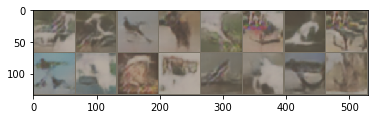

epoch: 106, time: 4099.474s, D loss: 0.002, G loss: 8.221
epoch: 106, time: 4101.422s, D loss: 0.011, G loss: 6.200
epoch: 106, time: 4103.348s, D loss: 0.005, G loss: 6.736
epoch: 106, time: 4105.290s, D loss: 0.008, G loss: 7.014
epoch: 106, time: 4107.214s, D loss: 0.004, G loss: 6.873


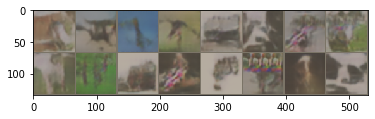

epoch: 106, time: 4109.300s, D loss: 0.005, G loss: 7.344
epoch: 106, time: 4111.241s, D loss: 0.012, G loss: 7.446
epoch: 106, time: 4113.136s, D loss: 0.006, G loss: 6.980
epoch: 106, time: 4115.048s, D loss: 0.029, G loss: 5.648
epoch: 106, time: 4116.986s, D loss: 0.009, G loss: 6.198


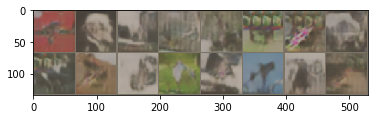

epoch: 106, time: 4119.102s, D loss: 0.006, G loss: 6.996
epoch: 106, time: 4121.059s, D loss: 0.012, G loss: 8.289
epoch: 106, time: 4123.006s, D loss: 0.008, G loss: 6.823
epoch: 106, time: 4124.937s, D loss: 0.033, G loss: 5.138
epoch: 107, time: 4125.995s, D loss: 0.067, G loss: 15.805


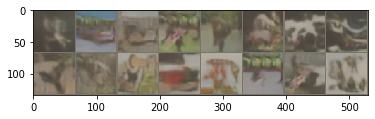

epoch: 107, time: 4128.085s, D loss: 0.093, G loss: 9.037
epoch: 107, time: 4130.003s, D loss: 0.155, G loss: 6.954
epoch: 107, time: 4131.935s, D loss: 0.031, G loss: 7.790
epoch: 107, time: 4133.870s, D loss: 0.135, G loss: 6.515
epoch: 107, time: 4135.830s, D loss: 0.056, G loss: 11.594


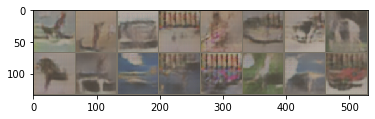

epoch: 107, time: 4137.930s, D loss: 0.286, G loss: 5.757
epoch: 107, time: 4139.851s, D loss: 0.072, G loss: 7.496
epoch: 107, time: 4141.802s, D loss: 0.233, G loss: 6.867
epoch: 107, time: 4143.738s, D loss: 0.044, G loss: 7.586
epoch: 107, time: 4145.683s, D loss: 0.145, G loss: 4.243


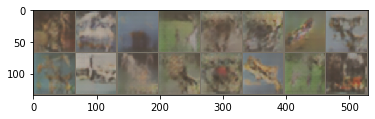

epoch: 107, time: 4147.777s, D loss: 0.115, G loss: 5.273
epoch: 107, time: 4149.712s, D loss: 0.108, G loss: 4.848
epoch: 107, time: 4151.634s, D loss: 0.059, G loss: 7.236
epoch: 107, time: 4153.558s, D loss: 0.168, G loss: 5.970
epoch: 107, time: 4155.504s, D loss: 0.035, G loss: 7.104


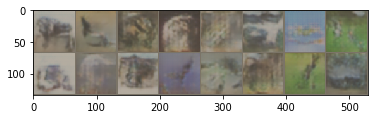

epoch: 107, time: 4157.604s, D loss: 0.014, G loss: 8.244
epoch: 107, time: 4159.549s, D loss: 0.284, G loss: 7.896
epoch: 107, time: 4161.496s, D loss: 0.135, G loss: 8.623
epoch: 107, time: 4163.434s, D loss: 0.795, G loss: 4.600
epoch: 108, time: 4164.500s, D loss: 0.012, G loss: 6.558


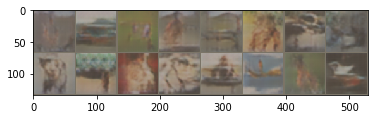

epoch: 108, time: 4166.616s, D loss: 0.124, G loss: 4.591
epoch: 108, time: 4168.553s, D loss: 0.147, G loss: 6.531
epoch: 108, time: 4170.477s, D loss: 0.024, G loss: 7.418
epoch: 108, time: 4172.422s, D loss: 0.018, G loss: 7.620
epoch: 108, time: 4174.356s, D loss: 0.038, G loss: 8.041


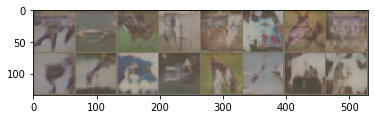

epoch: 108, time: 4176.486s, D loss: 0.553, G loss: 4.627
epoch: 108, time: 4178.409s, D loss: 0.053, G loss: 5.185
epoch: 108, time: 4180.332s, D loss: 0.296, G loss: 4.758
epoch: 108, time: 4182.248s, D loss: 0.032, G loss: 7.577
epoch: 108, time: 4184.168s, D loss: 0.016, G loss: 8.026


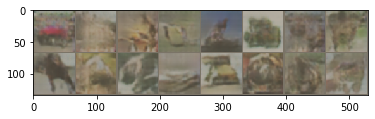

epoch: 108, time: 4186.277s, D loss: 0.072, G loss: 5.526
epoch: 108, time: 4188.209s, D loss: 0.016, G loss: 5.995
epoch: 108, time: 4190.133s, D loss: 0.115, G loss: 6.758
epoch: 108, time: 4192.083s, D loss: 0.132, G loss: 9.312
epoch: 108, time: 4194.000s, D loss: 0.052, G loss: 5.026


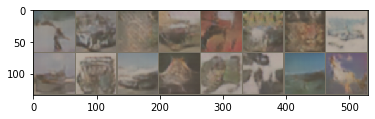

epoch: 108, time: 4196.111s, D loss: 0.009, G loss: 10.471
epoch: 108, time: 4198.033s, D loss: 0.049, G loss: 7.244
epoch: 108, time: 4199.954s, D loss: 0.045, G loss: 5.663
epoch: 108, time: 4201.893s, D loss: 0.083, G loss: 5.436
epoch: 109, time: 4202.963s, D loss: 0.012, G loss: 7.255


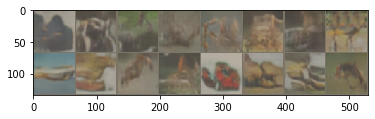

epoch: 109, time: 4205.053s, D loss: 0.096, G loss: 5.914
epoch: 109, time: 4206.982s, D loss: 0.129, G loss: 6.279
epoch: 109, time: 4208.913s, D loss: 0.041, G loss: 4.169
epoch: 109, time: 4210.849s, D loss: 0.021, G loss: 5.528
epoch: 109, time: 4212.789s, D loss: 0.064, G loss: 4.139


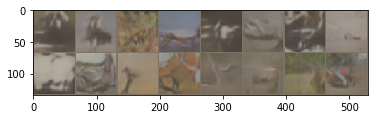

epoch: 109, time: 4214.876s, D loss: 0.050, G loss: 5.981
epoch: 109, time: 4216.811s, D loss: 0.062, G loss: 4.458
epoch: 109, time: 4218.739s, D loss: 0.013, G loss: 6.999
epoch: 109, time: 4220.681s, D loss: 0.028, G loss: 6.131
epoch: 109, time: 4222.612s, D loss: 0.011, G loss: 8.013


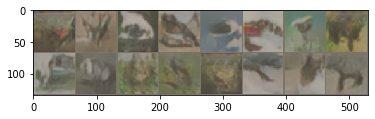

epoch: 109, time: 4224.702s, D loss: 0.015, G loss: 6.767
epoch: 109, time: 4226.636s, D loss: 0.036, G loss: 7.919
epoch: 109, time: 4228.566s, D loss: 0.017, G loss: 6.473
epoch: 109, time: 4230.505s, D loss: 0.053, G loss: 6.452
epoch: 109, time: 4232.452s, D loss: 0.710, G loss: 7.773


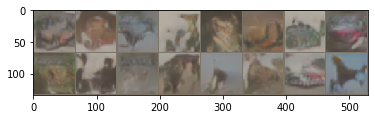

epoch: 109, time: 4234.577s, D loss: 0.017, G loss: 21.733
epoch: 109, time: 4236.498s, D loss: 0.223, G loss: 6.025
epoch: 109, time: 4238.434s, D loss: 0.139, G loss: 5.056
epoch: 109, time: 4240.385s, D loss: 0.043, G loss: 6.615
epoch: 110, time: 4241.466s, D loss: 0.072, G loss: 7.132


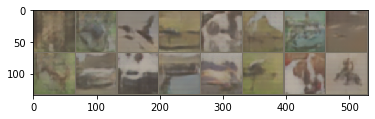

epoch: 110, time: 4243.550s, D loss: 0.029, G loss: 6.743
epoch: 110, time: 4245.472s, D loss: 0.034, G loss: 7.535
epoch: 110, time: 4247.405s, D loss: 0.015, G loss: 11.534
epoch: 110, time: 4249.314s, D loss: 0.100, G loss: 16.826
epoch: 110, time: 4251.270s, D loss: 0.060, G loss: 9.283


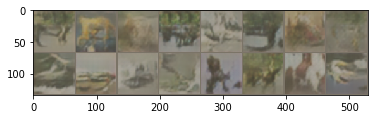

epoch: 110, time: 4253.359s, D loss: 0.012, G loss: 11.975
epoch: 110, time: 4255.314s, D loss: 0.072, G loss: 6.504
epoch: 110, time: 4257.257s, D loss: 0.464, G loss: 8.148
epoch: 110, time: 4259.180s, D loss: 0.065, G loss: 6.811
epoch: 110, time: 4261.104s, D loss: 0.149, G loss: 4.552


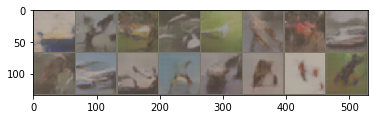

epoch: 110, time: 4263.216s, D loss: 0.024, G loss: 6.079
epoch: 110, time: 4265.175s, D loss: 0.059, G loss: 8.113
epoch: 110, time: 4267.107s, D loss: 0.281, G loss: 5.988
epoch: 110, time: 4269.042s, D loss: 0.004, G loss: 13.427
epoch: 110, time: 4270.969s, D loss: 0.014, G loss: 5.999


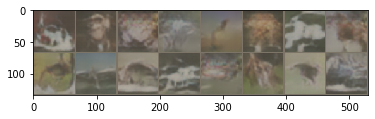

epoch: 110, time: 4273.061s, D loss: 0.062, G loss: 7.064
epoch: 110, time: 4275.005s, D loss: 0.051, G loss: 5.548
epoch: 110, time: 4276.930s, D loss: 0.069, G loss: 6.335
epoch: 110, time: 4278.871s, D loss: 0.014, G loss: 6.414
epoch: 111, time: 4279.937s, D loss: 0.023, G loss: 11.975


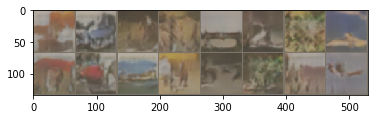

epoch: 111, time: 4282.032s, D loss: 0.059, G loss: 5.260
epoch: 111, time: 4283.967s, D loss: 0.022, G loss: 5.820
epoch: 111, time: 4285.931s, D loss: 0.015, G loss: 7.462
epoch: 111, time: 4287.890s, D loss: 0.053, G loss: 5.459
epoch: 111, time: 4289.833s, D loss: 0.008, G loss: 6.703


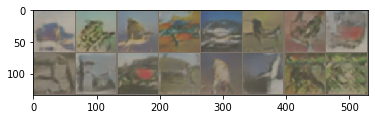

epoch: 111, time: 4291.974s, D loss: 0.006, G loss: 7.296
epoch: 111, time: 4293.932s, D loss: 0.003, G loss: 7.973
epoch: 111, time: 4295.891s, D loss: 0.024, G loss: 5.598
epoch: 111, time: 4297.846s, D loss: 0.033, G loss: 9.645
epoch: 111, time: 4299.770s, D loss: 0.004, G loss: 7.335


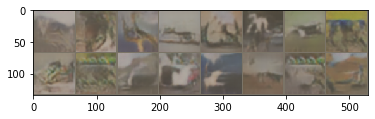

epoch: 111, time: 4301.848s, D loss: 0.007, G loss: 6.707
epoch: 111, time: 4303.772s, D loss: 0.005, G loss: 7.914
epoch: 111, time: 4305.723s, D loss: 0.006, G loss: 6.531
epoch: 111, time: 4307.668s, D loss: 0.006, G loss: 6.736
epoch: 111, time: 4309.604s, D loss: 0.005, G loss: 7.418


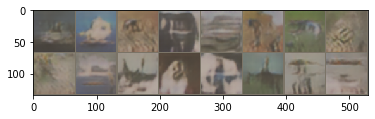

epoch: 111, time: 4311.727s, D loss: 0.001, G loss: 8.790
epoch: 111, time: 4313.666s, D loss: 0.004, G loss: 7.646
epoch: 111, time: 4315.609s, D loss: 0.012, G loss: 6.722
epoch: 111, time: 4317.549s, D loss: 0.002, G loss: 8.188
epoch: 112, time: 4318.610s, D loss: 0.004, G loss: 7.978


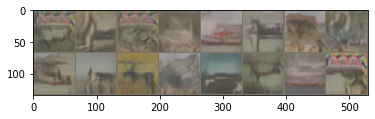

epoch: 112, time: 4320.715s, D loss: 0.037, G loss: 7.095
epoch: 112, time: 4322.680s, D loss: 0.006, G loss: 7.029
epoch: 112, time: 4324.648s, D loss: 0.004, G loss: 8.686
epoch: 112, time: 4326.596s, D loss: 0.007, G loss: 6.640
epoch: 112, time: 4328.541s, D loss: 0.005, G loss: 7.379


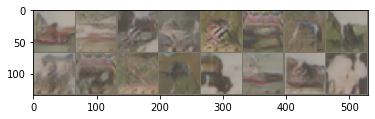

epoch: 112, time: 4330.648s, D loss: 0.008, G loss: 6.116
epoch: 112, time: 4332.580s, D loss: 0.005, G loss: 7.360
epoch: 112, time: 4334.523s, D loss: 0.002, G loss: 10.471
epoch: 112, time: 4336.442s, D loss: 0.004, G loss: 8.505
epoch: 112, time: 4338.370s, D loss: 0.002, G loss: 8.718


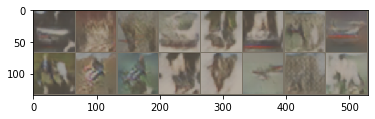

epoch: 112, time: 4340.510s, D loss: 0.002, G loss: 8.112
epoch: 112, time: 4342.438s, D loss: 0.004, G loss: 9.809
epoch: 112, time: 4344.397s, D loss: 0.009, G loss: 6.026
epoch: 112, time: 4346.338s, D loss: 0.005, G loss: 9.279
epoch: 112, time: 4348.278s, D loss: 0.001, G loss: 10.527


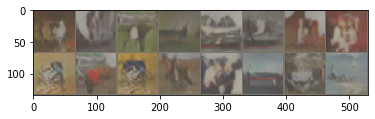

epoch: 112, time: 4350.358s, D loss: 0.001, G loss: 10.110
epoch: 112, time: 4352.304s, D loss: 0.131, G loss: 6.087
epoch: 112, time: 4354.246s, D loss: 0.003, G loss: 9.682
epoch: 112, time: 4356.190s, D loss: 0.001, G loss: 8.503
epoch: 113, time: 4357.256s, D loss: 0.003, G loss: 7.703


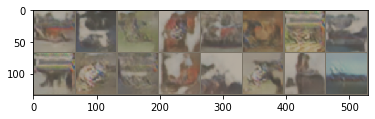

epoch: 113, time: 4359.330s, D loss: 0.008, G loss: 6.591
epoch: 113, time: 4361.258s, D loss: 0.019, G loss: 6.542
epoch: 113, time: 4363.182s, D loss: 0.001, G loss: 10.036
epoch: 113, time: 4365.114s, D loss: 0.010, G loss: 7.036
epoch: 113, time: 4367.036s, D loss: 0.002, G loss: 9.583


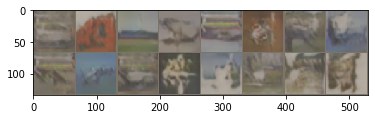

epoch: 113, time: 4369.119s, D loss: 0.008, G loss: 8.230
epoch: 113, time: 4371.054s, D loss: 0.001, G loss: 11.918
epoch: 113, time: 4372.962s, D loss: 0.000, G loss: 9.854
epoch: 113, time: 4374.888s, D loss: 0.001, G loss: 7.622
epoch: 113, time: 4376.791s, D loss: 0.003, G loss: 7.478


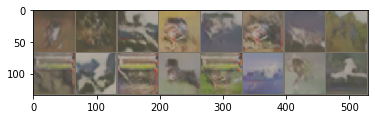

epoch: 113, time: 4378.871s, D loss: 0.016, G loss: 6.352
epoch: 113, time: 4380.804s, D loss: 0.037, G loss: 5.155
epoch: 113, time: 4382.756s, D loss: 0.003, G loss: 7.669
epoch: 113, time: 4384.708s, D loss: 0.001, G loss: 10.363
epoch: 113, time: 4386.630s, D loss: 0.001, G loss: 11.138


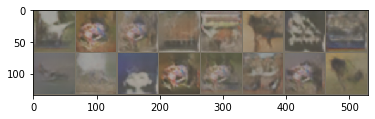

epoch: 113, time: 4388.711s, D loss: 0.003, G loss: 8.407
epoch: 113, time: 4390.648s, D loss: 0.001, G loss: 9.244
epoch: 113, time: 4392.572s, D loss: 0.004, G loss: 8.161
epoch: 113, time: 4394.519s, D loss: 0.003, G loss: 8.675
epoch: 114, time: 4395.588s, D loss: 0.032, G loss: 12.091


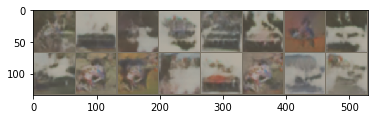

epoch: 114, time: 4397.680s, D loss: 0.001, G loss: 10.706
epoch: 114, time: 4399.618s, D loss: 0.003, G loss: 10.062
epoch: 114, time: 4401.551s, D loss: 0.001, G loss: 8.397
epoch: 114, time: 4403.494s, D loss: 0.003, G loss: 8.957
epoch: 114, time: 4405.461s, D loss: 0.004, G loss: 7.974


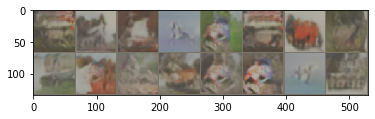

epoch: 114, time: 4407.563s, D loss: 0.014, G loss: 9.731
epoch: 114, time: 4409.496s, D loss: 0.004, G loss: 7.611
epoch: 114, time: 4411.428s, D loss: 0.001, G loss: 7.642
epoch: 114, time: 4413.376s, D loss: 0.002, G loss: 9.063
epoch: 114, time: 4415.316s, D loss: 0.001, G loss: 8.431


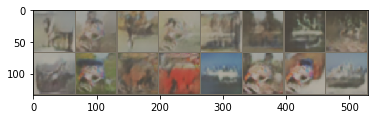

epoch: 114, time: 4417.385s, D loss: 0.001, G loss: 8.984
epoch: 114, time: 4419.311s, D loss: 0.001, G loss: 10.548
epoch: 114, time: 4421.240s, D loss: 0.004, G loss: 6.514
epoch: 114, time: 4423.184s, D loss: 0.001, G loss: 9.272
epoch: 114, time: 4425.141s, D loss: 0.009, G loss: 5.648


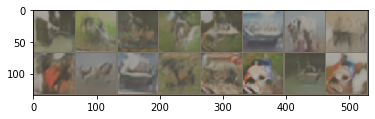

epoch: 114, time: 4427.219s, D loss: 0.000, G loss: 11.678
epoch: 114, time: 4429.142s, D loss: 0.003, G loss: 10.368
epoch: 114, time: 4431.087s, D loss: 0.010, G loss: 7.660
epoch: 114, time: 4433.022s, D loss: 0.003, G loss: 8.704
epoch: 115, time: 4434.083s, D loss: 0.001, G loss: 10.172


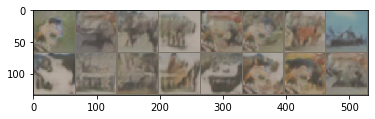

epoch: 115, time: 4436.203s, D loss: 0.000, G loss: 11.699
epoch: 115, time: 4438.145s, D loss: 0.006, G loss: 9.136
epoch: 115, time: 4440.082s, D loss: 0.001, G loss: 9.665
epoch: 115, time: 4442.052s, D loss: 0.005, G loss: 7.845
epoch: 115, time: 4443.995s, D loss: 0.003, G loss: 7.649


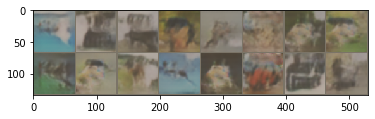

epoch: 115, time: 4446.095s, D loss: 0.001, G loss: 8.289
epoch: 115, time: 4448.017s, D loss: 0.000, G loss: 11.060
epoch: 115, time: 4449.953s, D loss: 0.001, G loss: 9.439
epoch: 115, time: 4451.895s, D loss: 0.001, G loss: 9.338
epoch: 115, time: 4453.829s, D loss: 0.001, G loss: 8.894


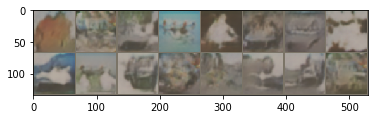

epoch: 115, time: 4455.919s, D loss: 0.001, G loss: 9.169
epoch: 115, time: 4457.843s, D loss: 0.004, G loss: 10.767
epoch: 115, time: 4459.795s, D loss: 0.010, G loss: 7.026
epoch: 115, time: 4461.720s, D loss: 0.003, G loss: 7.963
epoch: 115, time: 4463.657s, D loss: 0.001, G loss: 7.875


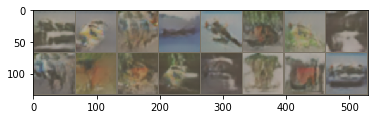

epoch: 115, time: 4465.774s, D loss: 0.002, G loss: 8.065
epoch: 115, time: 4467.708s, D loss: 0.001, G loss: 9.987
epoch: 115, time: 4469.632s, D loss: 0.000, G loss: 11.841
epoch: 115, time: 4471.583s, D loss: 0.005, G loss: 7.452
epoch: 116, time: 4472.658s, D loss: 0.004, G loss: 6.818


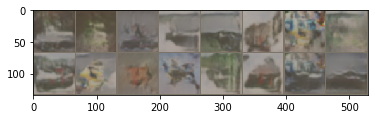

epoch: 116, time: 4474.777s, D loss: 0.002, G loss: 8.200
epoch: 116, time: 4476.694s, D loss: 0.001, G loss: 9.452
epoch: 116, time: 4478.625s, D loss: 0.004, G loss: 8.960
epoch: 116, time: 4480.574s, D loss: 0.022, G loss: 8.922
epoch: 116, time: 4482.515s, D loss: 0.003, G loss: 14.500


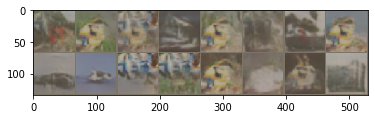

epoch: 116, time: 4484.622s, D loss: 0.001, G loss: 10.399
epoch: 116, time: 4486.547s, D loss: 0.001, G loss: 9.285
epoch: 116, time: 4488.473s, D loss: 0.001, G loss: 8.326
epoch: 116, time: 4490.407s, D loss: 0.001, G loss: 8.484
epoch: 116, time: 4492.347s, D loss: 0.000, G loss: 12.644


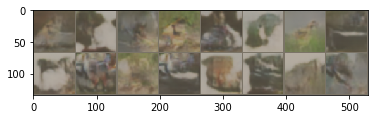

epoch: 116, time: 4494.447s, D loss: 0.001, G loss: 9.266
epoch: 116, time: 4496.391s, D loss: 0.000, G loss: 10.568
epoch: 116, time: 4498.311s, D loss: 0.001, G loss: 8.367
epoch: 116, time: 4500.205s, D loss: 0.002, G loss: 11.490
epoch: 116, time: 4502.126s, D loss: 0.000, G loss: 13.529


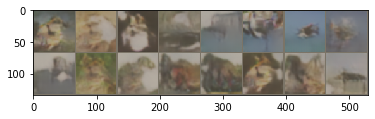

epoch: 116, time: 4504.264s, D loss: 0.009, G loss: 7.473
epoch: 116, time: 4506.206s, D loss: 0.000, G loss: 11.558
epoch: 116, time: 4508.138s, D loss: 0.000, G loss: 9.973
epoch: 116, time: 4510.064s, D loss: 0.002, G loss: 9.520
epoch: 117, time: 4511.125s, D loss: 0.002, G loss: 7.849


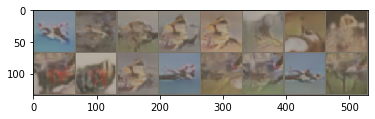

epoch: 117, time: 4513.202s, D loss: 0.002, G loss: 8.584
epoch: 117, time: 4515.134s, D loss: 0.010, G loss: 11.132
epoch: 117, time: 4517.062s, D loss: 0.001, G loss: 9.128
epoch: 117, time: 4519.000s, D loss: 0.002, G loss: 10.237
epoch: 117, time: 4520.926s, D loss: 0.002, G loss: 7.945


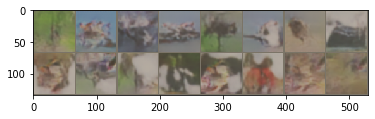

epoch: 117, time: 4523.018s, D loss: 0.001, G loss: 8.520
epoch: 117, time: 4524.963s, D loss: 0.002, G loss: 8.732
epoch: 117, time: 4526.904s, D loss: 0.001, G loss: 9.141
epoch: 117, time: 4528.843s, D loss: 0.000, G loss: 10.198
epoch: 117, time: 4530.793s, D loss: 0.000, G loss: 9.618


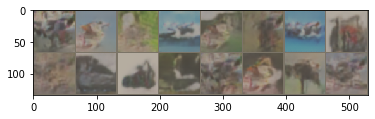

epoch: 117, time: 4532.903s, D loss: 0.001, G loss: 9.874
epoch: 117, time: 4534.849s, D loss: 0.005, G loss: 6.615
epoch: 117, time: 4536.794s, D loss: 0.003, G loss: 6.295
epoch: 117, time: 4538.731s, D loss: 1.647, G loss: 22.158
epoch: 117, time: 4540.670s, D loss: 0.173, G loss: 12.254


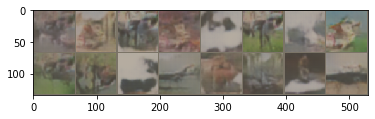

epoch: 117, time: 4542.749s, D loss: 0.292, G loss: 7.960
epoch: 117, time: 4544.702s, D loss: 0.031, G loss: 10.905
epoch: 117, time: 4546.634s, D loss: 0.177, G loss: 5.701
epoch: 117, time: 4548.570s, D loss: 0.117, G loss: 7.023
epoch: 118, time: 4549.639s, D loss: 0.031, G loss: 9.387


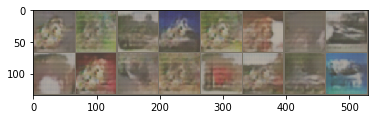

epoch: 118, time: 4551.740s, D loss: 0.036, G loss: 6.693
epoch: 118, time: 4553.678s, D loss: 0.071, G loss: 6.082
epoch: 118, time: 4555.634s, D loss: 0.009, G loss: 8.465
epoch: 118, time: 4557.562s, D loss: 0.086, G loss: 6.415
epoch: 118, time: 4559.487s, D loss: 0.020, G loss: 7.021


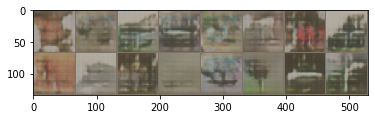

epoch: 118, time: 4561.606s, D loss: 0.032, G loss: 7.318
epoch: 118, time: 4563.556s, D loss: 0.284, G loss: 13.990
epoch: 118, time: 4565.512s, D loss: 0.081, G loss: 11.643
epoch: 118, time: 4567.437s, D loss: 0.073, G loss: 6.306
epoch: 118, time: 4569.375s, D loss: 0.320, G loss: 5.553


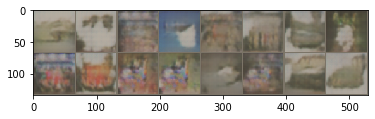

epoch: 118, time: 4571.467s, D loss: 0.038, G loss: 7.335
epoch: 118, time: 4573.383s, D loss: 0.157, G loss: 7.192
epoch: 118, time: 4575.316s, D loss: 0.110, G loss: 8.990
epoch: 118, time: 4577.238s, D loss: 0.103, G loss: 10.874
epoch: 118, time: 4579.172s, D loss: 0.357, G loss: 12.621


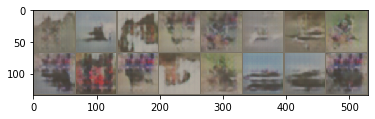

epoch: 118, time: 4581.280s, D loss: 0.032, G loss: 6.734
epoch: 118, time: 4583.228s, D loss: 0.053, G loss: 6.008
epoch: 118, time: 4585.171s, D loss: 0.034, G loss: 8.362
epoch: 118, time: 4587.092s, D loss: 0.043, G loss: 7.027
epoch: 119, time: 4588.151s, D loss: 0.074, G loss: 7.227


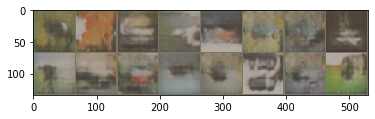

epoch: 119, time: 4590.234s, D loss: 0.203, G loss: 7.263
epoch: 119, time: 4592.172s, D loss: 0.025, G loss: 7.513
epoch: 119, time: 4594.099s, D loss: 0.007, G loss: 6.441
epoch: 119, time: 4596.042s, D loss: 0.018, G loss: 9.040
epoch: 119, time: 4597.966s, D loss: 0.025, G loss: 9.007


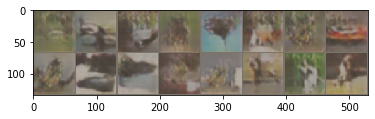

epoch: 119, time: 4600.086s, D loss: 0.052, G loss: 8.759
epoch: 119, time: 4602.027s, D loss: 0.136, G loss: 3.546
epoch: 119, time: 4603.984s, D loss: 0.019, G loss: 7.747
epoch: 119, time: 4605.941s, D loss: 0.033, G loss: 7.196
epoch: 119, time: 4607.877s, D loss: 0.025, G loss: 6.491


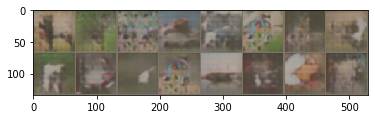

epoch: 119, time: 4609.986s, D loss: 0.024, G loss: 6.822
epoch: 119, time: 4611.913s, D loss: 0.015, G loss: 6.102
epoch: 119, time: 4613.820s, D loss: 0.024, G loss: 6.781
epoch: 119, time: 4615.762s, D loss: 0.006, G loss: 6.212
epoch: 119, time: 4617.691s, D loss: 0.108, G loss: 10.672


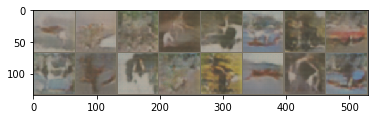

epoch: 119, time: 4619.773s, D loss: 0.053, G loss: 6.226
epoch: 119, time: 4621.721s, D loss: 0.090, G loss: 5.577
epoch: 119, time: 4623.646s, D loss: 0.070, G loss: 7.664
epoch: 119, time: 4625.578s, D loss: 0.083, G loss: 6.166
epoch: 120, time: 4626.620s, D loss: 0.269, G loss: 8.959


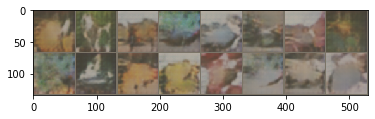

epoch: 120, time: 4628.653s, D loss: 0.391, G loss: 7.900
epoch: 120, time: 4630.549s, D loss: 0.010, G loss: 9.004
epoch: 120, time: 4632.477s, D loss: 0.067, G loss: 6.180
epoch: 120, time: 4634.417s, D loss: 0.043, G loss: 8.435
epoch: 120, time: 4636.340s, D loss: 0.032, G loss: 7.816


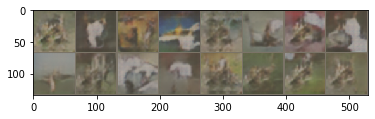

epoch: 120, time: 4638.411s, D loss: 0.086, G loss: 6.450
epoch: 120, time: 4640.969s, D loss: 0.013, G loss: 4.875
epoch: 120, time: 4644.787s, D loss: 0.010, G loss: 6.800
epoch: 120, time: 4646.728s, D loss: 0.110, G loss: 5.988
epoch: 120, time: 4648.665s, D loss: 0.022, G loss: 6.200


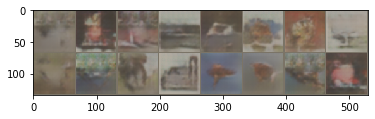

epoch: 120, time: 4650.765s, D loss: 0.027, G loss: 7.176
epoch: 120, time: 4652.704s, D loss: 0.060, G loss: 5.348
epoch: 120, time: 4654.651s, D loss: 0.115, G loss: 4.547
epoch: 120, time: 4656.560s, D loss: 0.023, G loss: 6.908
epoch: 120, time: 4658.484s, D loss: 0.020, G loss: 5.336


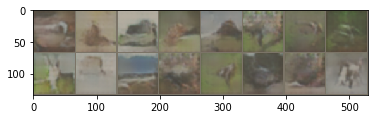

epoch: 120, time: 4660.952s, D loss: 0.026, G loss: 5.721
epoch: 120, time: 4662.873s, D loss: 0.027, G loss: 8.465
epoch: 120, time: 4664.811s, D loss: 0.012, G loss: 7.780
epoch: 120, time: 4666.718s, D loss: 0.014, G loss: 10.003
epoch: 121, time: 4667.778s, D loss: 0.009, G loss: 10.843


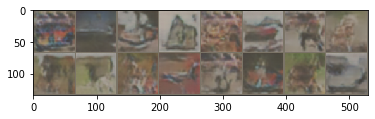

epoch: 121, time: 4669.927s, D loss: 0.019, G loss: 6.157
epoch: 121, time: 4671.843s, D loss: 0.043, G loss: 6.703
epoch: 121, time: 4673.765s, D loss: 0.027, G loss: 11.698
epoch: 121, time: 4675.712s, D loss: 0.014, G loss: 8.170
epoch: 121, time: 4677.651s, D loss: 0.027, G loss: 6.753


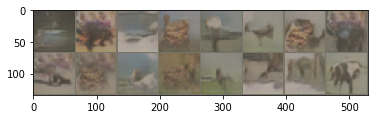

epoch: 121, time: 4679.721s, D loss: 0.033, G loss: 6.868
epoch: 121, time: 4681.665s, D loss: 0.030, G loss: 7.160
epoch: 121, time: 4683.602s, D loss: 0.038, G loss: 5.830
epoch: 121, time: 4685.554s, D loss: 0.007, G loss: 7.982
epoch: 121, time: 4687.473s, D loss: 0.116, G loss: 7.330


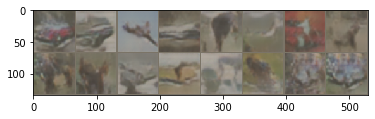

epoch: 121, time: 4689.555s, D loss: 0.069, G loss: 6.155
epoch: 121, time: 4691.483s, D loss: 0.064, G loss: 3.886
epoch: 121, time: 4693.402s, D loss: 1.461, G loss: 7.876
epoch: 121, time: 4695.344s, D loss: 0.153, G loss: 13.634
epoch: 121, time: 4697.250s, D loss: 0.141, G loss: 5.183


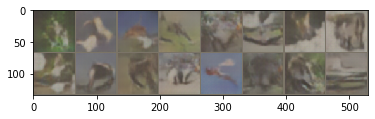

epoch: 121, time: 4699.332s, D loss: 0.118, G loss: 6.688
epoch: 121, time: 4701.263s, D loss: 0.235, G loss: 3.532
epoch: 121, time: 4703.187s, D loss: 0.084, G loss: 12.253
epoch: 121, time: 4705.138s, D loss: 0.043, G loss: 6.620
epoch: 122, time: 4706.214s, D loss: 0.065, G loss: 6.443


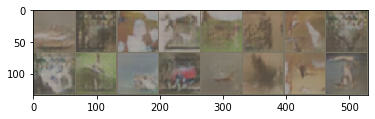

epoch: 122, time: 4708.293s, D loss: 0.119, G loss: 5.108
epoch: 122, time: 4710.219s, D loss: 0.100, G loss: 6.107
epoch: 122, time: 4712.169s, D loss: 0.110, G loss: 6.233
epoch: 122, time: 4714.111s, D loss: 0.016, G loss: 7.055
epoch: 122, time: 4716.061s, D loss: 0.455, G loss: 5.408


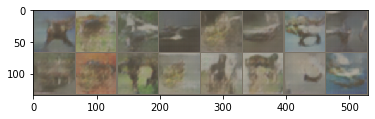

epoch: 122, time: 4718.136s, D loss: 0.062, G loss: 11.716
epoch: 122, time: 4720.058s, D loss: 0.024, G loss: 7.970
epoch: 122, time: 4722.011s, D loss: 0.079, G loss: 6.207
epoch: 122, time: 4723.958s, D loss: 0.057, G loss: 7.005
epoch: 122, time: 4725.901s, D loss: 0.052, G loss: 5.478


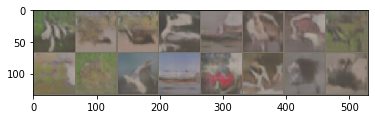

epoch: 122, time: 4728.013s, D loss: 0.028, G loss: 9.650
epoch: 122, time: 4729.945s, D loss: 0.071, G loss: 4.857
epoch: 122, time: 4731.893s, D loss: 0.029, G loss: 6.436
epoch: 122, time: 4733.838s, D loss: 0.014, G loss: 6.742
epoch: 122, time: 4735.782s, D loss: 0.037, G loss: 5.708


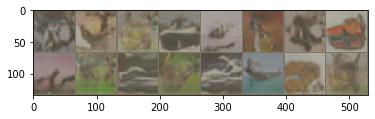

epoch: 122, time: 4737.886s, D loss: 0.140, G loss: 6.108
epoch: 122, time: 4739.811s, D loss: 0.017, G loss: 6.997
epoch: 122, time: 4741.750s, D loss: 0.127, G loss: 8.570
epoch: 122, time: 4743.680s, D loss: 0.033, G loss: 6.144
epoch: 123, time: 4744.744s, D loss: 0.091, G loss: 8.513


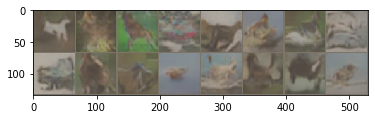

epoch: 123, time: 4746.820s, D loss: 0.077, G loss: 6.865
epoch: 123, time: 4748.750s, D loss: 0.086, G loss: 8.864
epoch: 123, time: 4750.677s, D loss: 0.017, G loss: 7.194
epoch: 123, time: 4752.606s, D loss: 0.053, G loss: 7.530
epoch: 123, time: 4754.528s, D loss: 0.007, G loss: 9.674


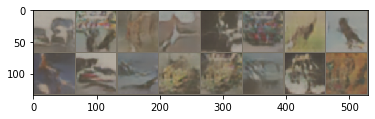

epoch: 123, time: 4756.584s, D loss: 0.067, G loss: 7.575
epoch: 123, time: 4758.492s, D loss: 0.026, G loss: 6.362
epoch: 123, time: 4760.419s, D loss: 0.054, G loss: 4.939
epoch: 123, time: 4762.341s, D loss: 0.078, G loss: 7.378
epoch: 123, time: 4764.269s, D loss: 0.040, G loss: 7.158


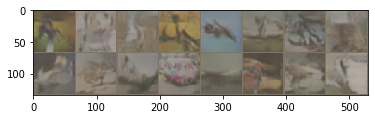

epoch: 123, time: 4766.362s, D loss: 0.023, G loss: 7.018
epoch: 123, time: 4768.276s, D loss: 0.042, G loss: 8.903
epoch: 123, time: 4770.197s, D loss: 0.044, G loss: 5.384
epoch: 123, time: 4772.133s, D loss: 0.020, G loss: 10.239
epoch: 123, time: 4774.079s, D loss: 0.049, G loss: 6.368


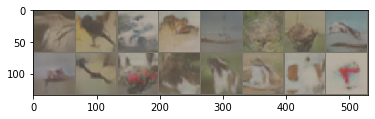

epoch: 123, time: 4776.171s, D loss: 0.016, G loss: 9.410
epoch: 123, time: 4778.094s, D loss: 0.576, G loss: 3.787
epoch: 123, time: 4780.016s, D loss: 0.011, G loss: 9.192
epoch: 123, time: 4781.934s, D loss: 0.020, G loss: 6.888
epoch: 124, time: 4783.003s, D loss: 0.013, G loss: 7.365


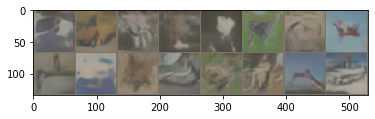

epoch: 124, time: 4785.110s, D loss: 0.045, G loss: 8.387
epoch: 124, time: 4787.034s, D loss: 0.118, G loss: 5.727
epoch: 124, time: 4788.965s, D loss: 0.043, G loss: 7.064
epoch: 124, time: 4790.901s, D loss: 0.028, G loss: 8.312
epoch: 124, time: 4792.830s, D loss: 0.019, G loss: 9.164


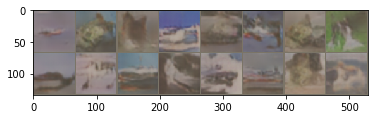

epoch: 124, time: 4794.932s, D loss: 0.180, G loss: 5.666
epoch: 124, time: 4796.884s, D loss: 0.178, G loss: 2.344
epoch: 124, time: 4798.804s, D loss: 0.511, G loss: 3.894
epoch: 124, time: 4800.733s, D loss: 0.396, G loss: 4.711
epoch: 124, time: 4802.696s, D loss: 0.175, G loss: 8.613


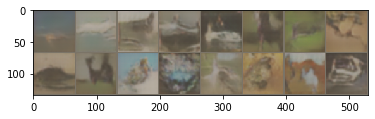

epoch: 124, time: 4804.809s, D loss: 0.031, G loss: 5.478
epoch: 124, time: 4806.736s, D loss: 0.199, G loss: 5.142
epoch: 124, time: 4808.669s, D loss: 0.206, G loss: 5.306
epoch: 124, time: 4810.607s, D loss: 0.073, G loss: 5.972
epoch: 124, time: 4812.539s, D loss: 0.087, G loss: 4.082


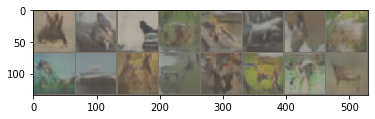

epoch: 124, time: 4814.627s, D loss: 0.103, G loss: 3.741
epoch: 124, time: 4816.556s, D loss: 0.100, G loss: 5.653
epoch: 124, time: 4818.488s, D loss: 0.122, G loss: 4.860
epoch: 124, time: 4820.416s, D loss: 0.030, G loss: 7.015
epoch: 125, time: 4821.470s, D loss: 0.013, G loss: 7.300


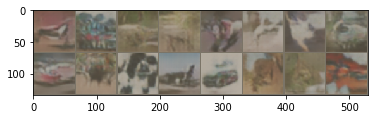

epoch: 125, time: 4823.550s, D loss: 0.019, G loss: 7.265
epoch: 125, time: 4825.490s, D loss: 0.051, G loss: 6.360
epoch: 125, time: 4827.425s, D loss: 0.007, G loss: 8.600
epoch: 125, time: 4829.348s, D loss: 0.034, G loss: 7.841
epoch: 125, time: 4831.274s, D loss: 0.035, G loss: 7.006


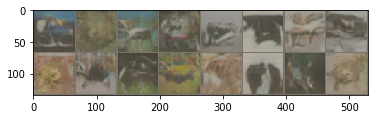

epoch: 125, time: 4833.445s, D loss: 0.078, G loss: 5.734
epoch: 125, time: 4835.384s, D loss: 0.011, G loss: 6.254
epoch: 125, time: 4837.302s, D loss: 0.045, G loss: 5.398
epoch: 125, time: 4839.216s, D loss: 0.012, G loss: 5.815
epoch: 125, time: 4841.139s, D loss: 0.032, G loss: 5.664


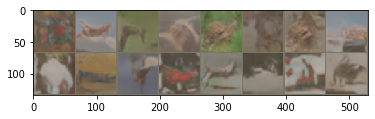

epoch: 125, time: 4843.232s, D loss: 0.063, G loss: 6.926
epoch: 125, time: 4845.186s, D loss: 0.040, G loss: 6.581
epoch: 125, time: 4847.101s, D loss: 0.119, G loss: 7.424
epoch: 125, time: 4849.022s, D loss: 0.032, G loss: 6.579
epoch: 125, time: 4850.955s, D loss: 0.023, G loss: 6.294


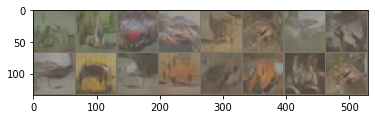

epoch: 125, time: 4853.053s, D loss: 0.029, G loss: 7.818
epoch: 125, time: 4854.984s, D loss: 0.004, G loss: 9.497
epoch: 125, time: 4856.919s, D loss: 0.039, G loss: 7.185
epoch: 125, time: 4858.848s, D loss: 0.035, G loss: 5.514
epoch: 126, time: 4859.914s, D loss: 0.013, G loss: 4.971


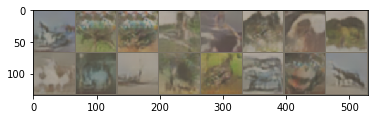

epoch: 126, time: 4862.007s, D loss: 0.017, G loss: 7.593
epoch: 126, time: 4863.964s, D loss: 0.041, G loss: 4.816
epoch: 126, time: 4865.901s, D loss: 0.004, G loss: 6.236
epoch: 126, time: 4867.826s, D loss: 0.007, G loss: 6.996
epoch: 126, time: 4869.761s, D loss: 0.033, G loss: 5.371


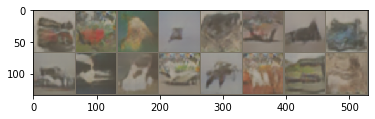

epoch: 126, time: 4871.842s, D loss: 0.037, G loss: 8.415
epoch: 126, time: 4873.783s, D loss: 0.010, G loss: 6.491
epoch: 126, time: 4875.738s, D loss: 0.024, G loss: 6.506
epoch: 126, time: 4877.659s, D loss: 0.028, G loss: 5.505
epoch: 126, time: 4879.584s, D loss: 0.024, G loss: 6.038


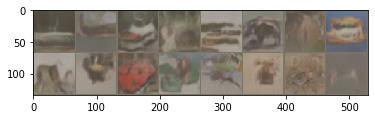

epoch: 126, time: 4881.619s, D loss: 0.015, G loss: 8.067
epoch: 126, time: 4883.530s, D loss: 0.016, G loss: 6.189
epoch: 126, time: 4885.481s, D loss: 0.010, G loss: 7.419
epoch: 126, time: 4887.419s, D loss: 0.041, G loss: 7.455
epoch: 126, time: 4889.349s, D loss: 0.013, G loss: 6.106


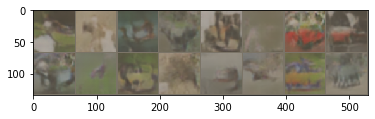

epoch: 126, time: 4891.465s, D loss: 0.039, G loss: 5.537
epoch: 126, time: 4893.407s, D loss: 0.039, G loss: 5.920
epoch: 126, time: 4895.357s, D loss: 0.009, G loss: 6.975
epoch: 126, time: 4897.288s, D loss: 0.029, G loss: 6.729
epoch: 127, time: 4898.343s, D loss: 0.013, G loss: 6.142


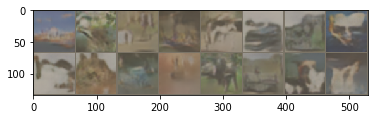

epoch: 127, time: 4900.430s, D loss: 0.016, G loss: 5.882
epoch: 127, time: 4902.361s, D loss: 0.107, G loss: 7.587
epoch: 127, time: 4904.294s, D loss: 0.022, G loss: 7.214
epoch: 127, time: 4906.228s, D loss: 0.079, G loss: 8.829
epoch: 127, time: 4908.155s, D loss: 0.609, G loss: 6.407


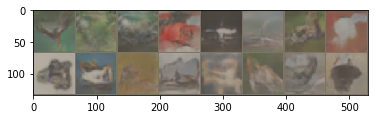

epoch: 127, time: 4910.284s, D loss: 0.130, G loss: 12.440
epoch: 127, time: 4912.251s, D loss: 0.636, G loss: 6.538
epoch: 127, time: 4914.208s, D loss: 0.138, G loss: 7.346
epoch: 127, time: 4916.161s, D loss: 0.461, G loss: 2.472
epoch: 127, time: 4918.118s, D loss: 0.100, G loss: 7.096


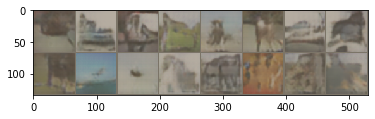

epoch: 127, time: 4920.221s, D loss: 0.071, G loss: 7.195
epoch: 127, time: 4922.171s, D loss: 0.472, G loss: 6.497
epoch: 127, time: 4924.099s, D loss: 0.187, G loss: 5.996
epoch: 127, time: 4926.051s, D loss: 0.152, G loss: 5.320
epoch: 127, time: 4927.969s, D loss: 0.082, G loss: 8.988


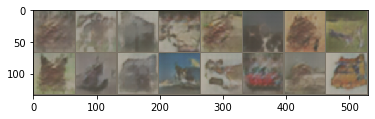

epoch: 127, time: 4930.062s, D loss: 0.015, G loss: 7.172
epoch: 127, time: 4931.993s, D loss: 0.090, G loss: 5.533
epoch: 127, time: 4933.912s, D loss: 0.048, G loss: 5.494
epoch: 127, time: 4935.843s, D loss: 0.090, G loss: 5.822
epoch: 128, time: 4936.903s, D loss: 0.022, G loss: 5.567


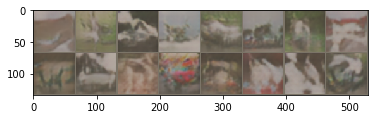

epoch: 128, time: 4938.987s, D loss: 0.002, G loss: 9.896
epoch: 128, time: 4940.916s, D loss: 0.010, G loss: 8.127
epoch: 128, time: 4942.855s, D loss: 0.014, G loss: 7.945
epoch: 128, time: 4944.798s, D loss: 0.009, G loss: 7.751
epoch: 128, time: 4946.716s, D loss: 0.024, G loss: 7.236


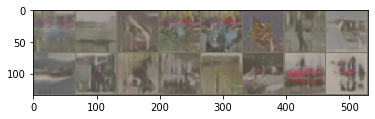

epoch: 128, time: 4948.800s, D loss: 0.035, G loss: 6.114
epoch: 128, time: 4950.729s, D loss: 0.005, G loss: 7.215
epoch: 128, time: 4952.658s, D loss: 0.008, G loss: 6.943
epoch: 128, time: 4954.609s, D loss: 0.005, G loss: 8.327
epoch: 128, time: 4956.527s, D loss: 0.003, G loss: 8.042


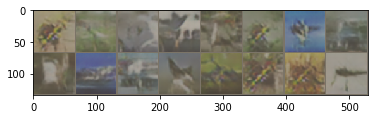

epoch: 128, time: 4958.609s, D loss: 0.103, G loss: 8.133
epoch: 128, time: 4960.543s, D loss: 0.019, G loss: 9.039
epoch: 128, time: 4962.472s, D loss: 0.001, G loss: 8.542
epoch: 128, time: 4964.417s, D loss: 0.003, G loss: 7.332
epoch: 128, time: 4966.355s, D loss: 0.008, G loss: 8.463


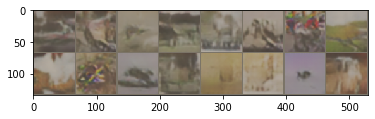

epoch: 128, time: 4968.441s, D loss: 0.009, G loss: 10.179
epoch: 128, time: 4970.368s, D loss: 0.012, G loss: 6.675
epoch: 128, time: 4972.310s, D loss: 0.017, G loss: 8.987
epoch: 128, time: 4974.236s, D loss: 0.009, G loss: 8.403
epoch: 129, time: 4975.334s, D loss: 0.002, G loss: 7.865


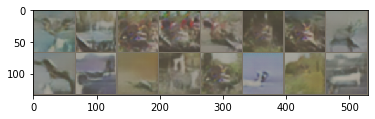

epoch: 129, time: 4977.418s, D loss: 0.004, G loss: 9.030
epoch: 129, time: 4979.356s, D loss: 0.005, G loss: 6.803
epoch: 129, time: 4981.290s, D loss: 0.004, G loss: 8.457
epoch: 129, time: 4983.229s, D loss: 0.004, G loss: 10.068
epoch: 129, time: 4985.191s, D loss: 0.024, G loss: 11.474


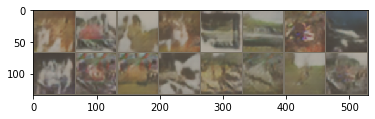

epoch: 129, time: 4987.263s, D loss: 0.003, G loss: 7.475
epoch: 129, time: 4989.196s, D loss: 0.002, G loss: 8.198
epoch: 129, time: 4991.122s, D loss: 0.002, G loss: 8.384
epoch: 129, time: 4993.034s, D loss: 0.005, G loss: 11.497
epoch: 129, time: 4994.976s, D loss: 0.001, G loss: 10.192


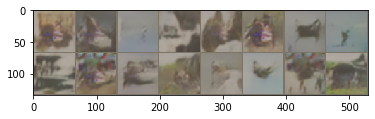

epoch: 129, time: 4997.114s, D loss: 0.010, G loss: 8.937
epoch: 129, time: 4999.039s, D loss: 0.002, G loss: 9.569
epoch: 129, time: 5000.975s, D loss: 0.002, G loss: 8.937
epoch: 129, time: 5002.917s, D loss: 0.001, G loss: 10.679
epoch: 129, time: 5004.861s, D loss: 0.002, G loss: 9.161


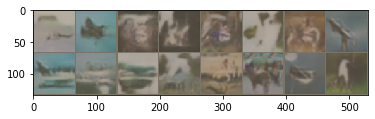

epoch: 129, time: 5006.950s, D loss: 0.008, G loss: 9.002
epoch: 129, time: 5008.852s, D loss: 0.004, G loss: 8.720
epoch: 129, time: 5010.740s, D loss: 0.002, G loss: 9.910
epoch: 129, time: 5012.665s, D loss: 0.001, G loss: 10.830
epoch: 130, time: 5013.724s, D loss: 0.006, G loss: 7.482


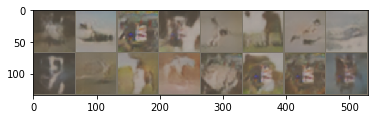

epoch: 130, time: 5015.822s, D loss: 0.007, G loss: 6.219
epoch: 130, time: 5017.739s, D loss: 0.002, G loss: 8.695
epoch: 130, time: 5019.664s, D loss: 0.003, G loss: 8.330
epoch: 130, time: 5021.599s, D loss: 0.005, G loss: 10.415
epoch: 130, time: 5023.531s, D loss: 0.022, G loss: 3.883


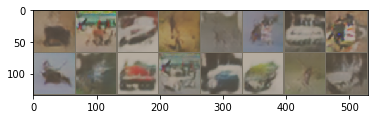

epoch: 130, time: 5025.618s, D loss: 0.001, G loss: 10.371
epoch: 130, time: 5027.554s, D loss: 0.001, G loss: 9.226
epoch: 130, time: 5029.488s, D loss: 0.001, G loss: 8.910
epoch: 130, time: 5031.411s, D loss: 0.002, G loss: 8.500
epoch: 130, time: 5033.348s, D loss: 0.001, G loss: 11.371


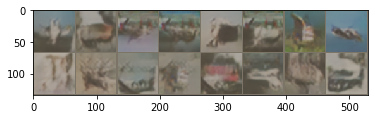

epoch: 130, time: 5035.473s, D loss: 0.008, G loss: 8.268
epoch: 130, time: 5037.411s, D loss: 0.003, G loss: 10.299
epoch: 130, time: 5039.334s, D loss: 0.003, G loss: 10.775
epoch: 130, time: 5041.265s, D loss: 0.002, G loss: 8.151
epoch: 130, time: 5043.218s, D loss: 0.002, G loss: 8.225


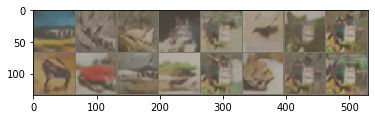

epoch: 130, time: 5045.340s, D loss: 0.003, G loss: 7.477
epoch: 130, time: 5047.280s, D loss: 0.010, G loss: 7.607
epoch: 130, time: 5049.221s, D loss: 0.001, G loss: 8.334
epoch: 130, time: 5051.144s, D loss: 0.001, G loss: 7.703
epoch: 131, time: 5052.219s, D loss: 0.004, G loss: 7.199


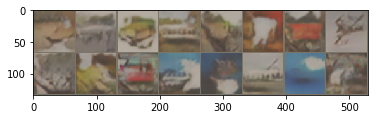

epoch: 131, time: 5054.300s, D loss: 0.001, G loss: 9.163
epoch: 131, time: 5056.245s, D loss: 0.015, G loss: 12.252
epoch: 131, time: 5058.170s, D loss: 0.017, G loss: 5.918
epoch: 131, time: 5060.103s, D loss: 0.013, G loss: 8.310
epoch: 131, time: 5062.020s, D loss: 0.002, G loss: 9.329


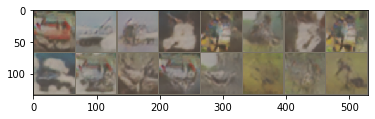

epoch: 131, time: 5064.115s, D loss: 0.011, G loss: 7.061
epoch: 131, time: 5066.067s, D loss: 0.005, G loss: 11.469
epoch: 131, time: 5067.996s, D loss: 0.003, G loss: 10.331
epoch: 131, time: 5069.911s, D loss: 0.020, G loss: 8.516
epoch: 131, time: 5071.857s, D loss: 0.013, G loss: 3.455


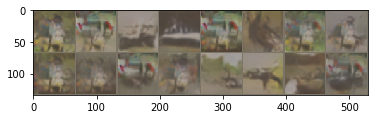

epoch: 131, time: 5073.966s, D loss: 0.138, G loss: 21.748
epoch: 131, time: 5075.908s, D loss: 0.094, G loss: 8.795
epoch: 131, time: 5077.840s, D loss: 0.102, G loss: 6.593
epoch: 131, time: 5079.761s, D loss: 0.205, G loss: 7.623
epoch: 131, time: 5081.688s, D loss: 0.028, G loss: 8.075


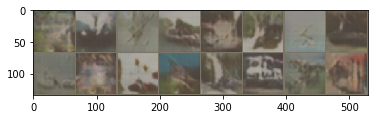

epoch: 131, time: 5083.767s, D loss: 0.166, G loss: 5.925
epoch: 131, time: 5085.726s, D loss: 0.059, G loss: 6.005
epoch: 131, time: 5087.643s, D loss: 0.241, G loss: 5.584
epoch: 131, time: 5089.576s, D loss: 0.043, G loss: 7.054
epoch: 132, time: 5090.647s, D loss: 0.055, G loss: 4.853


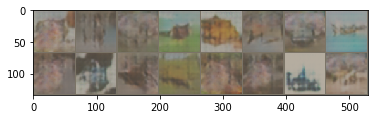

epoch: 132, time: 5092.738s, D loss: 0.086, G loss: 7.214
epoch: 132, time: 5094.681s, D loss: 0.049, G loss: 6.009
epoch: 132, time: 5096.605s, D loss: 0.025, G loss: 8.349
epoch: 132, time: 5098.534s, D loss: 0.055, G loss: 7.309
epoch: 132, time: 5100.452s, D loss: 0.082, G loss: 4.999


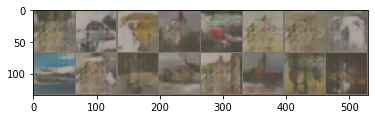

epoch: 132, time: 5102.562s, D loss: 0.061, G loss: 4.386
epoch: 132, time: 5104.521s, D loss: 0.018, G loss: 8.156
epoch: 132, time: 5106.458s, D loss: 0.086, G loss: 5.055
epoch: 132, time: 5108.407s, D loss: 0.057, G loss: 6.763
epoch: 132, time: 5110.331s, D loss: 0.150, G loss: 5.434


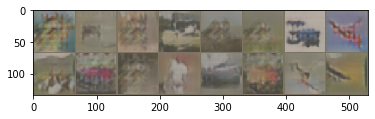

epoch: 132, time: 5112.407s, D loss: 0.128, G loss: 6.469
epoch: 132, time: 5114.330s, D loss: 0.090, G loss: 5.013
epoch: 132, time: 5116.261s, D loss: 0.115, G loss: 7.576
epoch: 132, time: 5118.190s, D loss: 0.024, G loss: 6.023
epoch: 132, time: 5120.104s, D loss: 0.070, G loss: 4.664


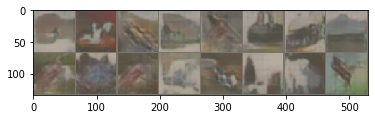

epoch: 132, time: 5122.196s, D loss: 0.052, G loss: 8.269
epoch: 132, time: 5124.126s, D loss: 0.205, G loss: 5.604
epoch: 132, time: 5126.132s, D loss: 0.057, G loss: 6.022
epoch: 132, time: 5128.114s, D loss: 0.043, G loss: 7.843
epoch: 133, time: 5129.204s, D loss: 0.050, G loss: 7.899


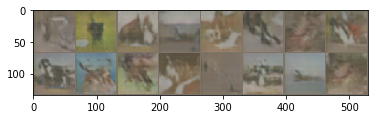

epoch: 133, time: 5131.310s, D loss: 0.058, G loss: 6.819
epoch: 133, time: 5133.247s, D loss: 0.057, G loss: 5.913
epoch: 133, time: 5135.190s, D loss: 0.060, G loss: 7.096
epoch: 133, time: 5137.079s, D loss: 0.080, G loss: 6.583
epoch: 133, time: 5138.985s, D loss: 0.238, G loss: 7.582


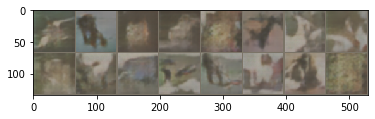

epoch: 133, time: 5141.089s, D loss: 0.195, G loss: 6.993
epoch: 133, time: 5143.013s, D loss: 0.065, G loss: 7.671
epoch: 133, time: 5144.979s, D loss: 0.041, G loss: 5.448
epoch: 133, time: 5146.923s, D loss: 0.058, G loss: 5.822
epoch: 133, time: 5148.826s, D loss: 0.023, G loss: 10.506


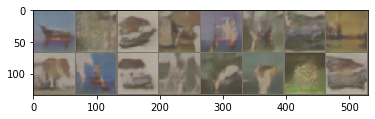

epoch: 133, time: 5150.878s, D loss: 0.269, G loss: 6.374
epoch: 133, time: 5152.798s, D loss: 0.021, G loss: 12.455
epoch: 133, time: 5154.750s, D loss: 0.061, G loss: 6.149
epoch: 133, time: 5156.760s, D loss: 0.018, G loss: 6.766
epoch: 133, time: 5158.756s, D loss: 0.035, G loss: 5.676


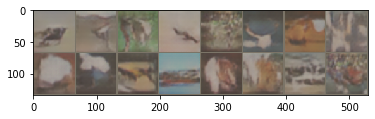

epoch: 133, time: 5161.042s, D loss: 0.024, G loss: 10.762
epoch: 133, time: 5163.137s, D loss: 0.014, G loss: 6.786
epoch: 133, time: 5165.183s, D loss: 0.025, G loss: 7.355
epoch: 133, time: 5167.302s, D loss: 0.028, G loss: 6.248
epoch: 134, time: 5168.453s, D loss: 0.120, G loss: 4.717


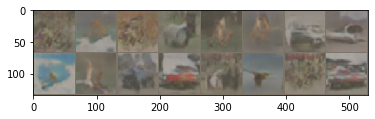

epoch: 134, time: 5170.697s, D loss: 0.018, G loss: 5.928
epoch: 134, time: 5172.777s, D loss: 0.056, G loss: 6.808
epoch: 134, time: 5174.890s, D loss: 0.045, G loss: 4.040
epoch: 134, time: 5176.961s, D loss: 0.035, G loss: 6.769
epoch: 134, time: 5179.035s, D loss: 0.065, G loss: 5.466


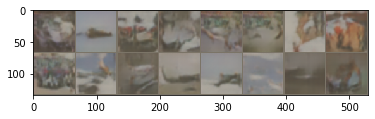

epoch: 134, time: 5181.188s, D loss: 0.084, G loss: 7.815
epoch: 134, time: 5183.175s, D loss: 0.052, G loss: 9.136
epoch: 134, time: 5185.145s, D loss: 0.032, G loss: 6.794
epoch: 134, time: 5187.081s, D loss: 0.010, G loss: 8.450
epoch: 134, time: 5189.023s, D loss: 0.004, G loss: 8.536


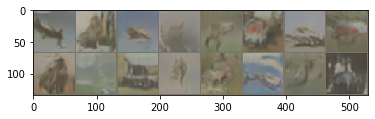

epoch: 134, time: 5191.144s, D loss: 0.009, G loss: 10.842
epoch: 134, time: 5193.120s, D loss: 0.030, G loss: 5.774
epoch: 134, time: 5195.100s, D loss: 0.069, G loss: 7.861
epoch: 134, time: 5197.041s, D loss: 0.319, G loss: 6.045
epoch: 134, time: 5198.985s, D loss: 0.025, G loss: 8.103


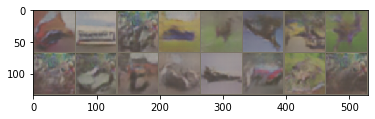

epoch: 134, time: 5201.091s, D loss: 0.039, G loss: 5.383
epoch: 134, time: 5203.059s, D loss: 0.118, G loss: 6.747
epoch: 134, time: 5205.034s, D loss: 0.088, G loss: 6.756
epoch: 134, time: 5207.022s, D loss: 0.023, G loss: 9.530
epoch: 135, time: 5208.100s, D loss: 0.132, G loss: 6.836


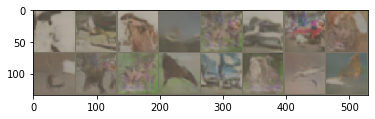

epoch: 135, time: 5210.224s, D loss: 0.027, G loss: 6.754
epoch: 135, time: 5212.176s, D loss: 0.049, G loss: 6.529
epoch: 135, time: 5214.133s, D loss: 0.010, G loss: 7.041
epoch: 135, time: 5216.100s, D loss: 0.024, G loss: 5.564
epoch: 135, time: 5218.047s, D loss: 0.043, G loss: 5.284


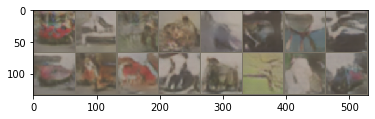

epoch: 135, time: 5220.209s, D loss: 0.013, G loss: 6.223
epoch: 135, time: 5222.233s, D loss: 0.014, G loss: 6.886
epoch: 135, time: 5224.244s, D loss: 0.011, G loss: 7.421
epoch: 135, time: 5226.249s, D loss: 0.027, G loss: 7.279
epoch: 135, time: 5228.252s, D loss: 0.030, G loss: 8.075


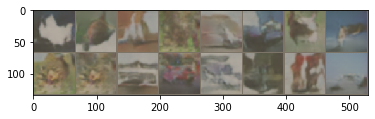

epoch: 135, time: 5230.400s, D loss: 0.014, G loss: 7.435
epoch: 135, time: 5232.355s, D loss: 0.217, G loss: 6.223
epoch: 135, time: 5234.305s, D loss: 0.004, G loss: 6.251
epoch: 135, time: 5236.256s, D loss: 0.050, G loss: 5.393
epoch: 135, time: 5238.211s, D loss: 0.116, G loss: 6.104


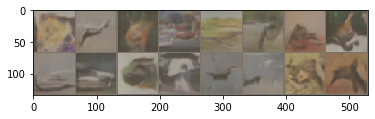

epoch: 135, time: 5240.289s, D loss: 0.007, G loss: 9.959
epoch: 135, time: 5242.224s, D loss: 0.074, G loss: 8.207
epoch: 135, time: 5244.163s, D loss: 0.006, G loss: 7.703
epoch: 135, time: 5246.135s, D loss: 0.016, G loss: 7.187
epoch: 136, time: 5247.208s, D loss: 0.007, G loss: 10.920


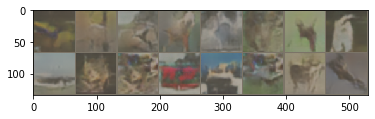

epoch: 136, time: 5249.300s, D loss: 0.003, G loss: 7.674
epoch: 136, time: 5251.230s, D loss: 0.016, G loss: 6.854
epoch: 136, time: 5253.156s, D loss: 0.016, G loss: 6.120
epoch: 136, time: 5255.107s, D loss: 0.002, G loss: 6.605
epoch: 136, time: 5257.035s, D loss: 0.006, G loss: 7.956


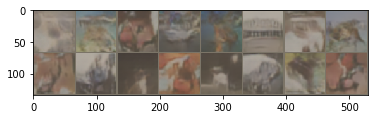

epoch: 136, time: 5259.114s, D loss: 0.009, G loss: 9.305
epoch: 136, time: 5261.047s, D loss: 0.083, G loss: 3.625
epoch: 136, time: 5262.977s, D loss: 0.035, G loss: 9.754
epoch: 136, time: 5264.929s, D loss: 2.038, G loss: 10.374
epoch: 136, time: 5266.856s, D loss: 0.033, G loss: 5.976


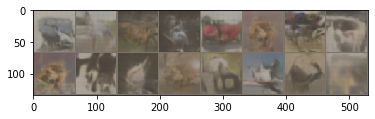

epoch: 136, time: 5268.938s, D loss: 0.190, G loss: 7.238
epoch: 136, time: 5270.875s, D loss: 0.344, G loss: 6.982
epoch: 136, time: 5272.820s, D loss: 0.036, G loss: 8.821
epoch: 136, time: 5274.765s, D loss: 0.015, G loss: 16.523
epoch: 136, time: 5276.724s, D loss: 0.206, G loss: 9.514


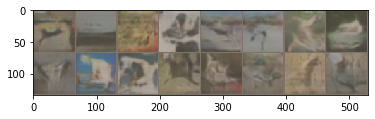

epoch: 136, time: 5278.820s, D loss: 0.057, G loss: 6.851
epoch: 136, time: 5280.756s, D loss: 0.046, G loss: 15.470
epoch: 136, time: 5282.714s, D loss: 0.098, G loss: 6.068


In [0]:
start=time.time()

n_show = 16  # Number of generated images that are shown during training

fixed_noise = torch.FloatTensor(batch_size, n_noise, 1, 1).normal_(0, 1).to(device)

for epoch in range(0,200):

  G.train()  # Put the networks in train mode
  D.train()
  for i, (x_batch, y_batch) in enumerate(trainloader):
    x_batch, y_batch = x_batch.to(device), y_batch.to(device)  # Move the data to the device that is used

    ############################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###########################
    D_optimizer.zero_grad()

    # Train on real data
    
    # COMPLETE THE CODE HERE
    
    # Train on fake data

    # COMPLETE THE CODE HERE
    
    D_loss = D_real_loss + D_fake_loss
    D_loss.backward()
    D_optimizer.step()

    ############################
    # (2) Update G network: maximize log(D(G(z)))
    ###########################
    G_optimizer.zero_grad()

    # COMPLETE THE CODE HERE

    G_loss.backward()
    G_optimizer.step()

    elapsed = time.time() - start  # Keep track of how much time has elapsed

    if not i % 20:
      print(f'epoch: {epoch}, time: {elapsed:.3f}s, D loss: {D_loss.item():.3f}, G loss: {G_loss.item():.3f}')
    if not i % 100:
      show(torchvision.utils.make_grid(x_batch_fake[:n_show].detach()))



